In [1]:
import ee
from IPython.display import Image

# Authenticate to the Earth Engine servers
ee.Authenticate()
ee.Initialize()

Enter verification code: 4/1ATx3LY6iV1VllzAlF-ttAMiiZj_fX1RVTrw-fs8LbQENWZvzPwWD2oHyq2I

Successfully saved authorization token.


In [2]:
import geemap
import ee

# Create a map centered at a specific location
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Add Sentinel-1 image collection
collection = ee.ImageCollection('COPERNICUS/S1_GRD') \
    .filterBounds(ee.Geometry.Point(61.362695116812176, 5.032779673636611)) \
    .filterDate('2020-01-01', '2020-12-31') \
    .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV')) \
    .filter(ee.Filter.eq('instrumentMode', 'IW'))

# Select the first image from the collection
image = ee.Image(collection.first())

# Apply visualization parameters to the image
vis_params = {'min': -25, 'max': 0}

# Add the Sentinel-1 image to the map with visualization parameters
#Map.addLayer(image, vis_params, 'Sentinel-1 Image')

# Load the GeoPackage file containing the box geometry
gpkg_path = 'AOI_Askvoll.gpkg'

# Load the polygons from the GeoPackage file
polygons = geemap.shp_to_ee(gpkg_path)

# Check if the conversion was successful
if polygons is not None:
    # Add the polygons to the map
    Map.addLayer(polygons, {}, 'Polygons')

    # Clip the image to the polygons geometry
    image_clip = image.clip(polygons)

    # Compute backscatter coefficient
    backscatter = image_clip.select('VV')

    # Measure backscatter coefficient from the polygons geometry
    stats = backscatter.reduceRegion(reducer=ee.Reducer.mean(), geometry=polygons, scale=10)

    # Print the backscatter coefficient
    print("Mean backscatter coefficient:", stats.getInfo()['VV'])
else:
    print("Failed to load the GeoPackage file.")

# Display the map
Map


The input shapefile is invalid.
Failed to load the GeoPackage file.


Map(center=[61.362695116812176, 5.032779673636611], controls=(WidgetControl(options=['position', 'transparent_…

In [3]:
import geemap
import ee

# Create a map centered at a specific location
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Load the GeoPackage file containing the polygons
gpkg_path = 'AOI_Askvoll.gpkg'

# Load the polygons directly from the GeoPackage file
polygons = ee.FeatureCollection('GPKG:' + gpkg_path)

# Check if the collection loaded successfully
if polygons is not None:
    # Add the polygons to the map
    Map.addLayer(polygons, {}, 'Polygons')
else:
    print("Failed to load the GeoPackage file.")

# Display the map
Map


EEException: Collection.loadTable: Collection asset 'GPKG:AOI_Askvoll.gpkg' not found.

In [5]:
Map = geemap.Map()
in_shp = "Test1.shp"
Map.add_shp(in_shp, layer_name="Countries")
Map

Map(center=[20, 0], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=HBox(children=(Togg…

In [3]:
# Load the GeoPackage file as a feature collection
gpkg_path = 'MoorsandHathlands.gpkg'
polygons = ee.FeatureCollection('users/username/path/to/your/featurecollection')  # Update with your own asset path

# Check if the feature collection was loaded successfully
if polygons is not None:
    # Add the polygons to the map
    Map.addLayer(polygons, {}, 'Polygons')
else:
    print("Failed to load the GeoPackage file.")

# Display the map
Map

EEException: Collection.loadTable: Collection asset 'users/username/path/to/your/featurecollection' not found.

In [8]:
import geemap

# Create a map centered at a specific location
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Load the shapefile
shp_path = 'moors12.shp'
Map.add_shp(shp_path, layer_name="Shapefile")

# Display the map
Map


Map(center=[61.362695116812176, 5.032779673636611], controls=(WidgetControl(options=['position', 'transparent_…

In [4]:
import geemap
import ee



# Create a map centered at a specific location.
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Load the shapefile.
shp_path = 'moors12.shp'
Map.add_shp(shp_path, layer_name="Shapefile")

# Load the shapefile as a feature collection.
shapefile_fc = geemap.shp_to_ee(shp_path)

# Define a date range for the Sentinel-2 imagery.
start_date = '2023-04-01'
end_date = '2023-04-30'

# Access the Sentinel-2 image collection, filter by date and bounds, and select the required bands.
s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                 .filterDate(start_date, end_date)
                 .filterBounds(shapefile_fc)
                 .select(['B4', 'B8'])
                 .sort('CLOUDY_PIXEL_PERCENTAGE'))  # B4 is red, B8 is near-infrared.

# Calculate the median image from the filtered collection.
median_image = s2_collection.first()

# Calculate NDVI.
ndvi = median_image.normalizedDifference(['B8', 'B4']).rename('NDVI')

# Create a mask from the shapefile geometry.
geometry = shapefile_fc.geometry()
mask = ee.Image.constant(1).clip(geometry).mask()

# Apply the mask to the NDVI image.
ndvi_masked = ndvi.updateMask(mask)

# Define visualization parameters for NDVI with appropriate color palette.
ndvi_params = {
    'min': -1,
    'max': 1,
    'palette': ['blue', 'white', 'yellow', 'green', 'darkgreen']
}

# Add the NDVI layer to the map.
Map.addLayer(ndvi_masked, ndvi_params, 'NDVI')

# Display the map.
Map


Map(center=[61.362695116812176, 5.032779673636611], controls=(WidgetControl(options=['position', 'transparent_…

In [21]:
# Calculate the mean NDVI for the reduced region.
mean_ndvi_dict = ndvi_masked.reduceRegion(
    reducer=ee.Reducer.mean(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the mean NDVI value.
mean_ndvi = mean_ndvi_dict.get('NDVI').getInfo()
print('Mean NDVI:', mean_ndvi)


Mean NDVI: 0.25478568886860475


In [22]:
# Calculate the area of the region.
area_image = ee.Image.pixelArea().clip(geometry)
area_dict = area_image.reduceRegion(
    reducer=ee.Reducer.sum(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the area in square meters.
area_m2 = area_dict.get('area').getInfo()
area_km2 = area_m2 / 1e6  # Convert to square kilometers
print('Area in square kilometers:', area_km2)


Area in square kilometers: 0.493891512055027


In [17]:
import geemap
import ee



# Create a map centered at a specific location.
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Load the shapefile.
shp_path = 'AgriculturalLand.shp'
Map.add_shp(shp_path, layer_name="Shapefile")

# Load the shapefile as a feature collection.
shapefile_fc = geemap.shp_to_ee(shp_path)

# Define a date range for the Sentinel-2 imagery.
start_date = '2023-04-01'
end_date = '2023-04-30'

# Access the Sentinel-2 image collection, filter by date and bounds, and select the required bands.
s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                 .filterDate(start_date, end_date)
                 .filterBounds(shapefile_fc)
                 .select(['B4', 'B8'])
                 .sort('CLOUDY_PIXEL_PERCENTAGE'))  # B4 is red, B8 is near-infrared.

# Calculate the median image from the filtered collection.
median_image = s2_collection.first()

# Calculate NDVI.
ndvi = median_image.normalizedDifference(['B8', 'B4']).rename('NDVI')

# Create a mask from the shapefile geometry.
geometry = shapefile_fc.geometry()
mask = ee.Image.constant(1).clip(geometry).mask()

# Apply the mask to the NDVI image.
ndvi_masked = ndvi.updateMask(mask)

# Define visualization parameters for NDVI with appropriate color palette.
ndvi_params = {
    'min': -1,
    'max': 1,
    'palette': ['blue', 'white', 'yellow', 'green', 'darkgreen']
}

# Add the NDVI layer to the map.
Map.addLayer(ndvi_masked, ndvi_params, 'NDVI')

# Display the map.
Map


Map(center=[61.362695116812176, 5.032779673636611], controls=(WidgetControl(options=['position', 'transparent_…

In [8]:
# Calculate the mean NDVI for the reduced region.
mean_ndvi_dict = ndvi_masked.reduceRegion(
    reducer=ee.Reducer.mean(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the mean NDVI value.
mean_ndvi = mean_ndvi_dict.get('NDVI').getInfo()
print('Mean NDVI:', mean_ndvi)

Mean NDVI: 0.26628864313317646


In [9]:
# Calculate the area of the region.
area_image = ee.Image.pixelArea().clip(geometry)
area_dict = area_image.reduceRegion(
    reducer=ee.Reducer.sum(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the area in square meters.
area_m2 = area_dict.get('area').getInfo()
area_km2 = area_m2 / 1e6  # Convert to square kilometers
print('Area in square kilometers:', area_km2)

Area in square kilometers: 5.133160035386968


In [19]:
# Set the file path to save the exported image.
file_path = 'ndvi_map.png'

# Export the NDVI image to a PNG file.
geemap.ee_export_image(
    ndvi_masked, 
    filename=file_path, 
    scale=10, 
    region=geometry, 
    file_per_band=False
)


The filename must end with .tif


In [30]:
import geemap
import ee



# Create a map centered at a specific location.
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Load the shapefile.
shp_path = 'sp_12.shp'
Map.add_shp(shp_path, layer_name="Shapefile")

# Load the shapefile as a feature collection.
shapefile_fc = geemap.shp_to_ee(shp_path)

# Define a date range for the Sentinel-2 imagery.
start_date = '2023-04-01'
end_date = '2023-04-30'

# Access the Sentinel-2 image collection, filter by date and bounds, and select the required bands.
s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                 .filterDate(start_date, end_date)
                 .filterBounds(shapefile_fc)
                 .select(['B4', 'B8'])
                 .sort('CLOUDY_PIXEL_PERCENTAGE'))  # B4 is red, B8 is near-infrared.

# Calculate the median image from the filtered collection.
median_image = s2_collection.first()

# Calculate NDVI.
ndvi = median_image.normalizedDifference(['B8', 'B4']).rename('NDVI')

# Create a mask from the shapefile geometry.
geometry = shapefile_fc.geometry()
mask = ee.Image.constant(1).clip(geometry).mask()

# Apply the mask to the NDVI image.
ndvi_masked = ndvi.updateMask(mask)

# Define visualization parameters for NDVI with appropriate color palette.
ndvi_params = {
    'min': -1,
    'max': 1,
    'palette': ['blue', 'white', 'yellow', 'green', 'darkgreen']
}

# Add the NDVI layer to the map.
Map.addLayer(ndvi_masked, ndvi_params, 'NDVI')

# Display the map.
Map

Map(center=[61.362695116812176, 5.032779673636611], controls=(WidgetControl(options=['position', 'transparent_…

In [31]:
# Calculate the mean NDVI for the reduced region.
mean_ndvi_dict = ndvi_masked.reduceRegion(
    reducer=ee.Reducer.mean(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the mean NDVI value.
mean_ndvi = mean_ndvi_dict.get('NDVI').getInfo()
print('Mean NDVI:', mean_ndvi)

Mean NDVI: 0.25237899455299245


In [32]:
# Calculate the area of the region.
area_image = ee.Image.pixelArea().clip(geometry)
area_dict = area_image.reduceRegion(
    reducer=ee.Reducer.sum(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the area in square meters.
area_m2 = area_dict.get('area').getInfo()
area_km2 = area_m2 / 1e6  # Convert to square kilometers
print('Area in square kilometers:', area_km2)

Area in square kilometers: 1.018268362449274


In [34]:
import geemap
import ee

# Initialize the Earth Engine module.
ee.Initialize()

# Create a map centered at a specific location.
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Load the shapefile.
shp_path = 'sp_12.shp'
Map.add_shp(shp_path, layer_name="Shapefile")

# Load the shapefile as a feature collection.
shapefile_fc = geemap.shp_to_ee(shp_path)

# Define a date range for the Sentinel-1 imagery.
start_date = '2023-04-01'
end_date = '2023-04-30'

# Access the Sentinel-1 image collection, filter by date and bounds, and select the required bands.
s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                 .filterDate(start_date, end_date)
                 .filterBounds(shapefile_fc)
                 .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                 .select('VV'))

# Calculate the median image from the filtered collection.
median_s1_image = s1_collection.median()

# Create a mask from the shapefile geometry.
geometry = shapefile_fc.geometry()
mask = ee.Image.constant(1).clip(geometry).mask()

# Apply the mask to the backscatter image.
s1_masked = median_s1_image.updateMask(mask)

s1_params = {
    'min': -30,
    'max': 0,
    'palette': ['000000', '0000FF', '00FFFF', 'FFFF00', 'FF0000', 'FFFFFF']  # Black, Blue, Cyan, Yellow, Red, White
}


# Add the backscatter layer to the map.
Map.addLayer(s1_masked, s1_params, 'Sentinel-1 Backscatter')

# Display the map.
Map


Map(center=[61.362695116812176, 5.032779673636611], controls=(WidgetControl(options=['position', 'transparent_…

TraitError: The 'east' trait of a Map instance expected a float, not the NoneType None.

In [35]:
# Calculate the mean backscatter coefficient for the reduced region.
mean_backscatter_dict = s1_masked.reduceRegion(
    reducer=ee.Reducer.mean(),
    geometry=geometry,
    scale=10,
    maxPixels=1e9
)

# Get the mean backscatter value.
mean_backscatter = mean_backscatter_dict.get('VV').getInfo()
print('Mean Backscatter (VV):', mean_backscatter)


Mean Backscatter (VV): -10.152535111616704


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


              Shapefile  Area (sq km)  NDVI Mean  SAVI Mean  GCI Mean  \
0  AgriculturalLand.shp      5.133280  -0.005848  -0.008772 -0.023235   
1    DecidiousTrees.shp      1.258995   0.000033   0.000050 -0.070295   
2  Moors&HealthLand.shp      2.743284  -0.013024  -0.019534 -0.064363   
3          PeatBogs.shp      0.735180  -0.041643  -0.062459 -0.127973   
4         PineTrees.shp      1.425234  -0.000375  -0.000563 -0.045186   
5       SpruceTrees.shp      1.570304  -0.000096  -0.000145 -0.068306   

   Backscatter Mean  
0        -12.266363  
1         -9.798807  
2        -11.767577  
3        -18.039301  
4        -11.326938  
5        -10.916418  


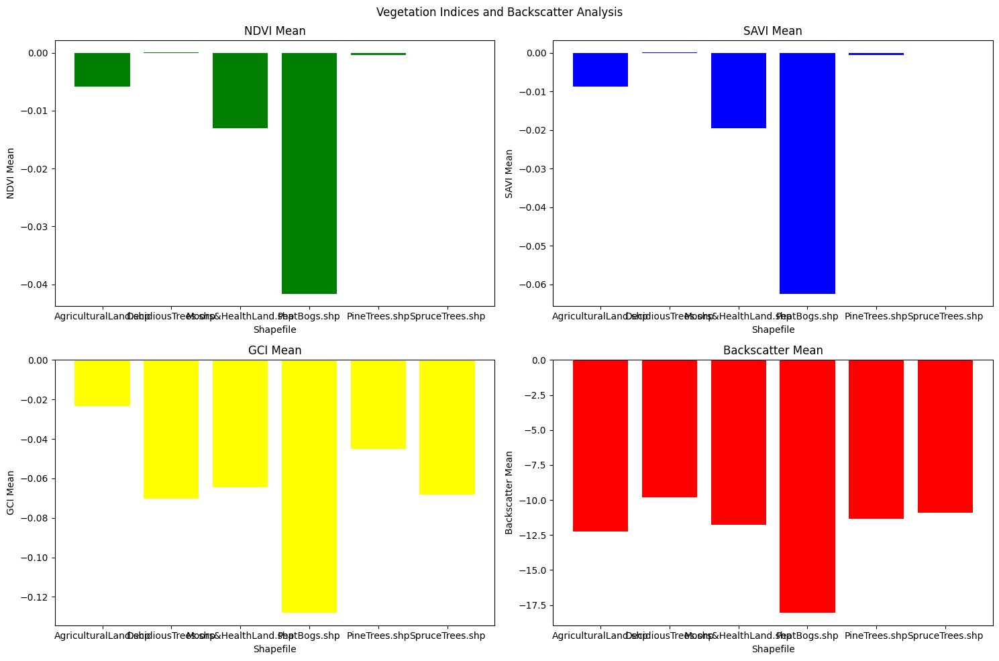

In [46]:
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
# Define function to calculate vegetation indices.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    return ndvi.addBands(savi).addBands(gci)

# Define function to calculate backscatter.
def calculate_backscatter(collection, geometry):
    median_image = collection.median().clip(geometry)
    return median_image.updateMask(ee.Image.constant(1).clip(geometry).mask())

def get_area(geometry):
    return geometry.area(1).getInfo() / 1e6  # Convert to square kilometers with error margin of 1 meter


# Define the date range for the last two years.
start_date = '2023-12-01'
end_date = '2023-12-31'

# Define visualization parameters for NDVI, SAVI, and GCI.
vis_params = {
    'NDVI': {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'yellow', 'green', 'darkgreen']},
    'SAVI': {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'yellow', 'green', 'darkgreen']},
    'GCI': {'min': -1, 'max': 1, 'palette': ['blue', 'white', 'yellow', 'green', 'darkgreen']},
    'Backscatter': {'min': -30, 'max': 0, 'palette': ['000000', '0000FF', '00FFFF', 'FFFF00', 'FF0000', 'FFFFFF']}
}

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Initialize the map.
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Initialize a DataFrame to store results.
results_df = pd.DataFrame(columns=['Shapefile', 'Area (sq km)', 'NDVI Mean', 'SAVI Mean', 'GCI Mean', 'Backscatter Mean'])

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()
    
    # Calculate area.
    try:
        area = get_area(geometry)
    except Exception as e:
        print(f"Error calculating area for {shp}: {e}")
        area = None
    
    # Load Sentinel-2 image collection and calculate indices.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))
    
    # Calculate median indices.
    median_indices = s2_collection.median().clip(geometry)
    try:
        ndvi_mean = median_indices.select('NDVI').reduceRegions(
            collection=ee.FeatureCollection(geometry),
            reducer=ee.Reducer.mean(),
            scale=10
        ).first().get('mean').getInfo()
        savi_mean = median_indices.select('SAVI').reduceRegions(
            collection=ee.FeatureCollection(geometry),
            reducer=ee.Reducer.mean(),
            scale=10
        ).first().get('mean').getInfo()
        gci_mean = median_indices.select('GCI').reduceRegions(
            collection=ee.FeatureCollection(geometry),
            reducer=ee.Reducer.mean(),
            scale=10
        ).first().get('mean').getInfo()
    except Exception as e:
        print(f"Error calculating vegetation indices for {shp}: {e}")
        ndvi_mean = savi_mean = gci_mean = None
    
    # Load Sentinel-1 image collection and calculate backscatter.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV'))
    
    try:
        backscatter_image = calculate_backscatter(s1_collection, geometry)
        backscatter_mean = backscatter_image.reduceRegions(
            collection=ee.FeatureCollection(geometry),
            reducer=ee.Reducer.mean(),
            scale=10
        ).first().get('mean').getInfo()
    except Exception as e:
        print(f"Error calculating backscatter for {shp}: {e}")
        backscatter_mean = None
    
   # Add data to DataFrame.
    results_df = pd.concat([results_df, pd.DataFrame([{
        'Shapefile': shp,
        'Area (sq km)': area,
        'NDVI Mean': ndvi_mean,
        'SAVI Mean': savi_mean,
        'GCI Mean': gci_mean,
        'Backscatter Mean': backscatter_mean
    }])], ignore_index=True)
    
    # Add layers to the map.
    Map.addLayer(median_indices.select('NDVI'), vis_params['NDVI'], f'NDVI {shp}')
    Map.addLayer(median_indices.select('SAVI'), vis_params['SAVI'], f'SAVI {shp}')
    Map.addLayer(median_indices.select('GCI'), vis_params['GCI'], f'GCI {shp}')
    Map.addLayer(backscatter_image, vis_params['Backscatter'], f'Backscatter {shp}')

# Display the map.
Map

# Display the results table using pandas.
print(results_df)

# Plotting the results.
fig, ax = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Vegetation Indices and Backscatter Analysis')

# Plot NDVI.
ax[0, 0].bar(results_df['Shapefile'], results_df['NDVI Mean'], color='green')
ax[0, 0].set_title('NDVI Mean')
ax[0, 0].set_xlabel('Shapefile')
ax[0, 0].set_ylabel('NDVI Mean')

# Plot SAVI.
ax[0, 1].bar(results_df['Shapefile'], results_df['SAVI Mean'], color='blue')
ax[0, 1].set_title('SAVI Mean')
ax[0, 1].set_xlabel('Shapefile')
ax[0, 1].set_ylabel('SAVI Mean')

# Plot GCI.
ax[1, 0].bar(results_df['Shapefile'], results_df['GCI Mean'], color='yellow')
ax[1, 0].set_title('GCI Mean')
ax[1, 0].set_xlabel('Shapefile')
ax[1, 0].set_ylabel('GCI Mean')

# Plot Backscatter.
ax[1, 1].bar(results_df['Shapefile'], results_df['Backscatter Mean'], color='red')
ax[1, 1].set_title('Backscatter Mean')
ax[1, 1].set_xlabel('Shapefile')
ax[1, 1].set_ylabel('Backscatter Mean')

plt.tight_layout()
plt.show()

In [54]:
# Define the date range.
start_date = '2021-01-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection and calculate NDVI for each image.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .select(['B4', 'B8'])
                     .map(calculate_ndvi))

    # Aggregate NDVI values over time.
    def aggregate_ndvi(image):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        return ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'shapefile': shp})

    ndvi_features = s2_collection.map(aggregate_ndvi)

    # Convert the features to a FeatureCollection and get the data
    ndvi_fc = ee.FeatureCollection(ndvi_features)
    ndvi_info = ndvi_fc.getInfo()

    for feature in ndvi_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        ndvi_df = pd.concat([ndvi_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
ndvi_df['Date'] = pd.to_datetime(ndvi_df['Date'])

# Display the DataFrame to ensure data is collected
print(ndvi_df.head())


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI             Shapefile
0 2021-01-03  0.026103  AgriculturalLand.shp
1 2021-01-06  0.043383  AgriculturalLand.shp
2 2021-01-09  0.035954  AgriculturalLand.shp
3 2021-01-13  0.007766  AgriculturalLand.shp
4 2021-01-16 -0.025981  AgriculturalLand.shp


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI             Shapefile
0 2021-01-03  0.026103  AgriculturalLand.shp
1 2021-01-06  0.043383  AgriculturalLand.shp
2 2021-01-13  0.007766  AgriculturalLand.shp
3 2021-01-19 -0.046034  AgriculturalLand.shp
4 2021-01-24  0.075638  AgriculturalLand.shp


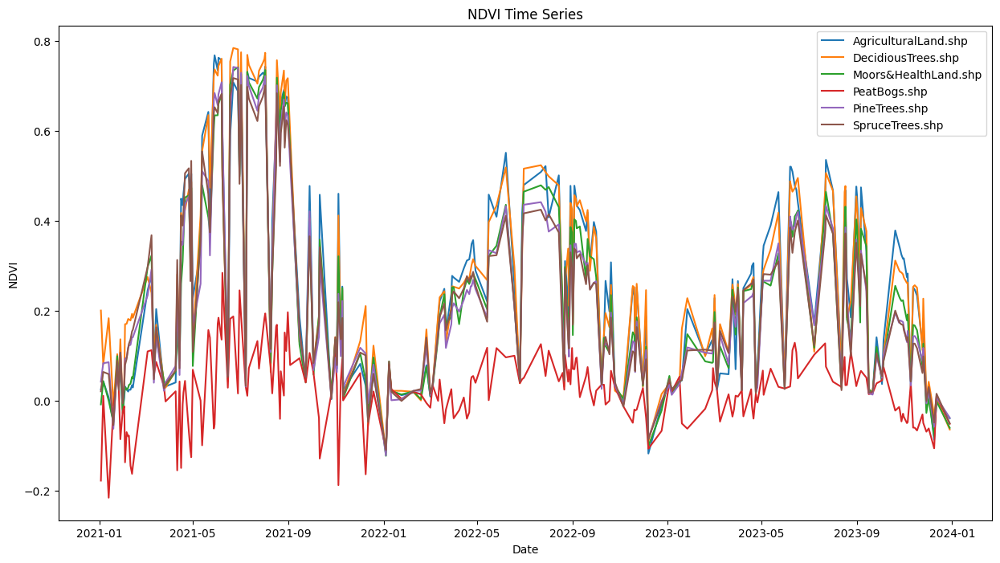

<Figure size 640x480 with 0 Axes>

In [69]:

# Define function to calculate NDVI.
def calculate_ndvi(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store NDVI time series.
ndvi_df = pd.DataFrame()

# Define the date range.
start_date = '2021-01-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection and calculate NDVI for each image.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8'])
                     .map(calculate_ndvi))

    # Use an iterate function to get NDVI values over time.
    def accumulate_images(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    ndvi_time_series = ee.List(s2_collection.iterate(accumulate_images, initial_list))

    # Convert the list to a FeatureCollection
    ndvi_fc = ee.FeatureCollection(ndvi_time_series)

    # Get the NDVI values and dates
    ndvi_info = ndvi_fc.getInfo()

    for feature in ndvi_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        ndvi_df = pd.concat([ndvi_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
ndvi_df['Date'] = pd.to_datetime(ndvi_df['Date'])

# Display the DataFrame to ensure data is collected
print(ndvi_df.head())
# Directory to save plots
plot_directory = 'NDVI_Plots'
os.makedirs(plot_directory, exist_ok=True)
# Plot NDVI time series.
fig, ax = plt.subplots(figsize=(15, 8))
for shp in shapefiles:
    shp_ndvi = ndvi_df[ndvi_df['Shapefile'] == shp]
    ax.plot(shp_ndvi['Date'], shp_ndvi['NDVI'], label=shp)
ax.set_title('NDVI Time Series')
ax.set_xlabel('Date')
ax.set_ylabel('NDVI')
ax.legend()
plt.show()
plt.savefig(os.path.join(plot_directory, 'NDVI_Time_Series_All_Shapefiles.png'))
plt.show()

In [56]:
print(ndvi_df)


           Date      NDVI             Shapefile
0    2021-01-03  0.026103  AgriculturalLand.shp
1    2021-01-06  0.043383  AgriculturalLand.shp
2    2021-01-09  0.035954  AgriculturalLand.shp
3    2021-01-13  0.007766  AgriculturalLand.shp
4    2021-01-16 -0.025981  AgriculturalLand.shp
...         ...       ...                   ...
3547 2023-12-02  0.030793       SpruceTrees.shp
3548 2023-12-09 -0.048116       SpruceTrees.shp
3549 2023-12-12  0.016013       SpruceTrees.shp
3550 2023-12-19  0.092006       SpruceTrees.shp
3551 2023-12-29 -0.049799       SpruceTrees.shp

[3552 rows x 3 columns]


In [58]:

# Directory to save plots
plot_directory = 'NDVI_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Plot NDVI time series for each shapefile and save as PNG
for shp in shapefiles:
    fig, ax = plt.subplots(figsize=(15, 8))
    shp_ndvi = ndvi_df[ndvi_df['Shapefile'] == shp]
    ax.plot(shp_ndvi['Date'], shp_ndvi['NDVI'], label=shp)
    ax.set_title(f'NDVI Time Series for {shp}')
    ax.set_xlabel('Date')
    ax.set_ylabel('NDVI')
    ax.legend()
    plt.savefig(os.path.join(plot_directory, f'{shp}_NDVI.png'))
    plt.close(fig)

In [60]:
ndvi_df = pd.DataFrame()

# Define the date range.
start_date = '2021-01-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection and calculate NDVI for each image.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .select(['B4', 'B8'])
                     .map(calculate_ndvi))

    # Use an iterate function to get NDVI values over time.
    def accumulate_images(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    ndvi_time_series = ee.List(s2_collection.iterate(accumulate_images, initial_list))

    # Convert the list to a FeatureCollection
    ndvi_fc = ee.FeatureCollection(ndvi_time_series)

    # Get the NDVI values and dates
    ndvi_info = ndvi_fc.getInfo()

    for feature in ndvi_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        ndvi_df = pd.concat([ndvi_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
ndvi_df['Date'] = pd.to_datetime(ndvi_df['Date'])

# Display the DataFrame to ensure data is collected
print(ndvi_df.head())

# Directory to save plots
plot_directory = 'NDVI_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI time series for each shapefile and save as PNG
for idx, shp in enumerate(shapefiles):
    fig, ax = plt.subplots(figsize=(15, 8))
    shp_ndvi = ndvi_df[ndvi_df['Shapefile'] == shp]
    ax.plot(shp_ndvi['Date'], shp_ndvi['NDVI'], label=shp, linestyle=line_styles[idx % len(line_styles)], marker=markers[idx % len(markers)])
    ax.set_title(f'NDVI Time Series for {shp}')
    ax.set_xlabel('Date')
    ax.set_ylabel('NDVI')
    ax.legend()
    plt.savefig(os.path.join(plot_directory, f'{shp}_NDVI.png'))
    plt.close(fig)

Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI             Shapefile
0 2021-01-03  0.026103  AgriculturalLand.shp
1 2021-01-06  0.043383  AgriculturalLand.shp
2 2021-01-09  0.035954  AgriculturalLand.shp
3 2021-01-13  0.007766  AgriculturalLand.shp
4 2021-01-16 -0.025981  AgriculturalLand.shp


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2021-01-03  0.026103  0.039157  0.251119  AgriculturalLand.shp          NaN
1 2021-01-06  0.043383  0.065070  0.208374  AgriculturalLand.shp          NaN
2 2021-01-13  0.007766  0.011653  0.193067  AgriculturalLand.shp          NaN
3 2021-01-19 -0.046034 -0.069042 -0.099233  AgriculturalLand.shp          NaN
4 2021-01-24  0.075638  0.113450  0.380528  AgriculturalLand.shp          NaN


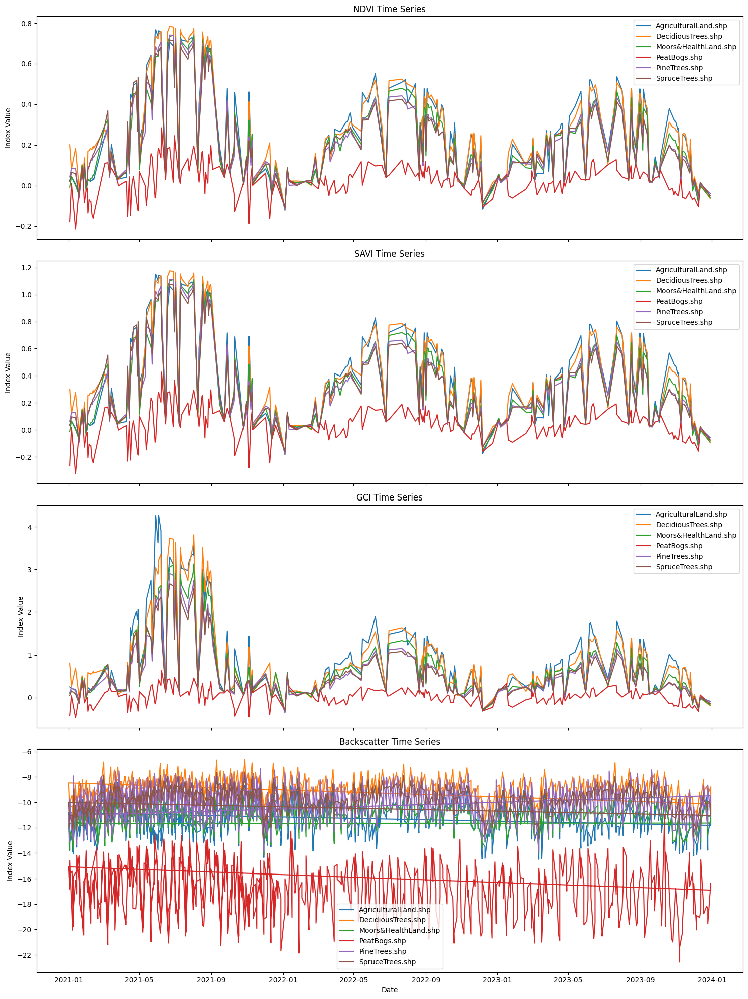

In [71]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os


# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2021-01-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     #.sort('CLOUDY_PIXEL_PERCENTAGE')
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, and Backscatter time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(4, 1, figsize=(15, 20), sharex=True)

for shp in shapefiles:
    shp_indices = indices_df[indices_df['Shapefile'] == shp]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')

for ax in axs:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2021-01-03  0.026103  0.039157  0.251119  AgriculturalLand.shp          NaN
1 2021-01-06  0.043383  0.065070  0.208374  AgriculturalLand.shp          NaN
2 2021-01-13  0.007766  0.011653  0.193067  AgriculturalLand.shp          NaN
3 2021-01-19 -0.046034 -0.069042 -0.099233  AgriculturalLand.shp          NaN
4 2021-01-24  0.075638  0.113450  0.380528  AgriculturalLand.shp          NaN


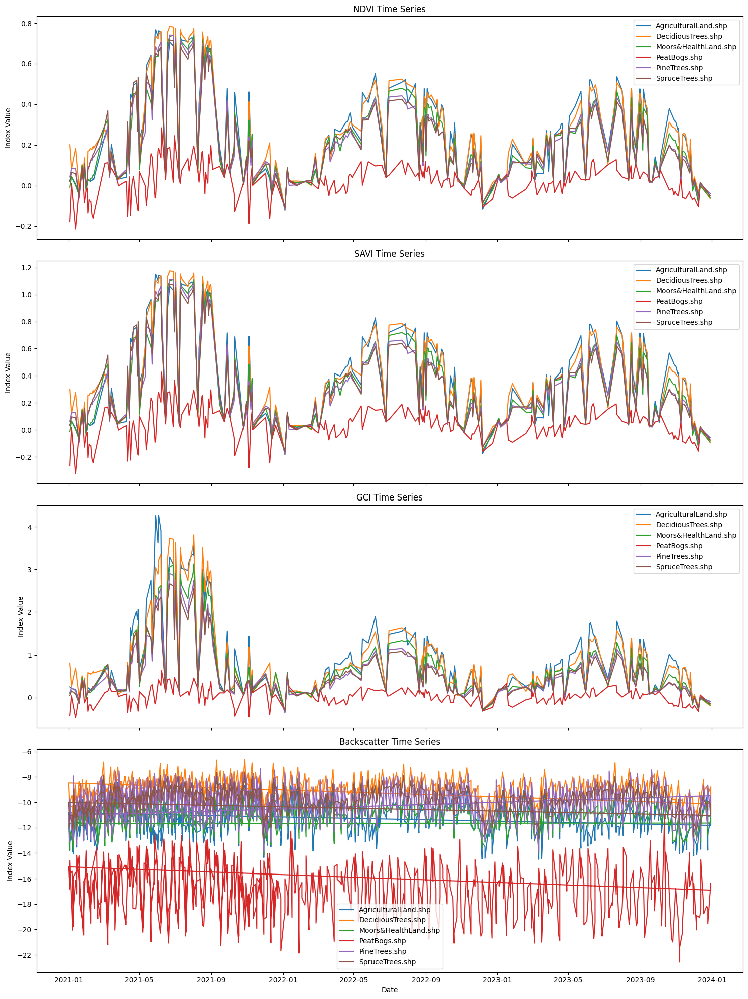

In [73]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np



# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2021-01-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     #.sort('CLOUDY_PIXEL_PERCENTAGE')
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, and Backscatter time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(4, 1, figsize=(15, 20), sharex=True)

for shp in shapefiles:
    shp_indices = indices_df[indices_df['Shapefile'] == shp]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')

for ax in axs:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()

Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2021-02-02  0.008083  0.012125  0.096731  AgriculturalLand.shp          NaN
1 2021-02-03  0.032147  0.048220  0.230961  AgriculturalLand.shp          NaN
2 2021-02-05  0.025972  0.038958  0.214859  AgriculturalLand.shp          NaN
3 2021-02-07  0.020788  0.031184  0.180335  AgriculturalLand.shp          NaN
4 2021-02-08  0.024937  0.037406  0.194716  AgriculturalLand.shp          NaN
Checking for NaN values in Backscatter:
           Date      NDVI      SAVI       GCI             Shapefile  \
0    2021-02-02  0.008083  0.012125  0.096731  AgriculturalLand.shp   
1    2021-02-03  0.032147  0.048220  0.230961  AgriculturalLand.shp   
2    2021-02-05  0.025972  0.038958  0.214859  AgriculturalLand.shp   
3    2021-02-07  0.020788  0.031184  0.180335  AgriculturalLand.shp   
4    2021-02-08  0.024937  0.037406  0.194716  AgriculturalLand.shp   
...         ...       ...       ...       ...                   ..

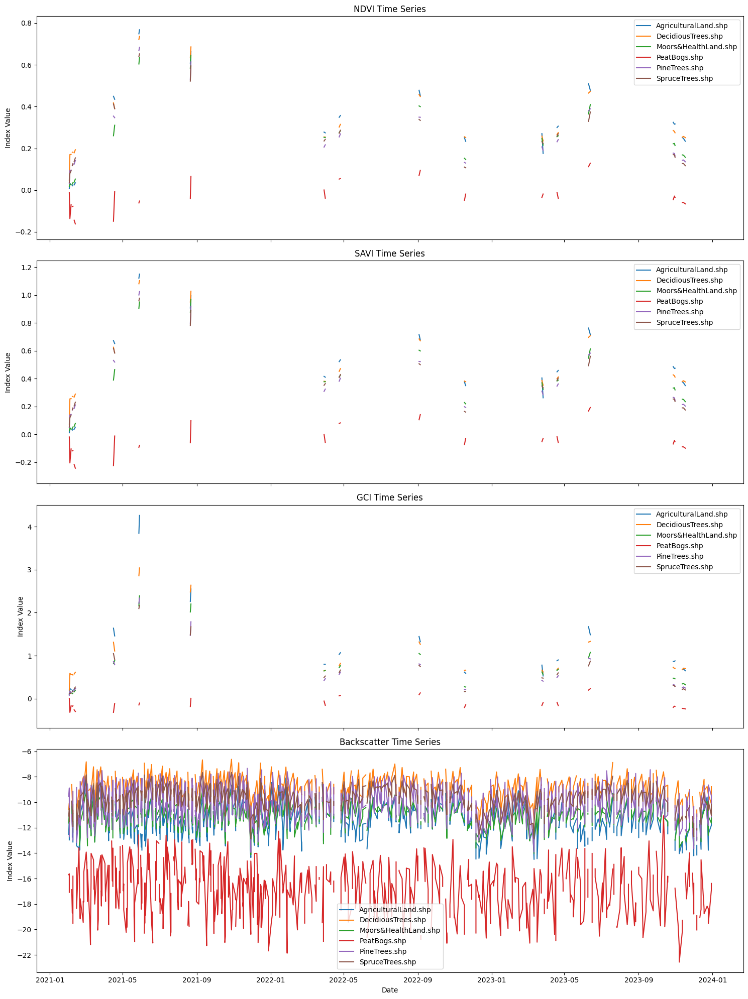

In [84]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2021-02-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 10))
                     #.sort('CLOUDY_PIXEL_PERCENTAGE')
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None or backscatter_value == -9999:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None or backscatter_value == -9999:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Check for any NaN or constant values in Backscatter
print("Checking for NaN values in Backscatter:")
print(indices_df[indices_df['Backscatter'].isna()])

print("Checking for constant values in Backscatter:")
constant_values = indices_df['Backscatter'].value_counts()
print(constant_values[constant_values > 1])

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, and Backscatter time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(4, 1, figsize=(15, 20), sharex=True)

for shp in shapefiles:
    shp_indices = indices_df[indices_df['Shapefile'] == shp].sort_values(by='Date')
   # shp_indices = indices_df[indices_df['Shapefile'] == shp]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')

for ax in axs:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()

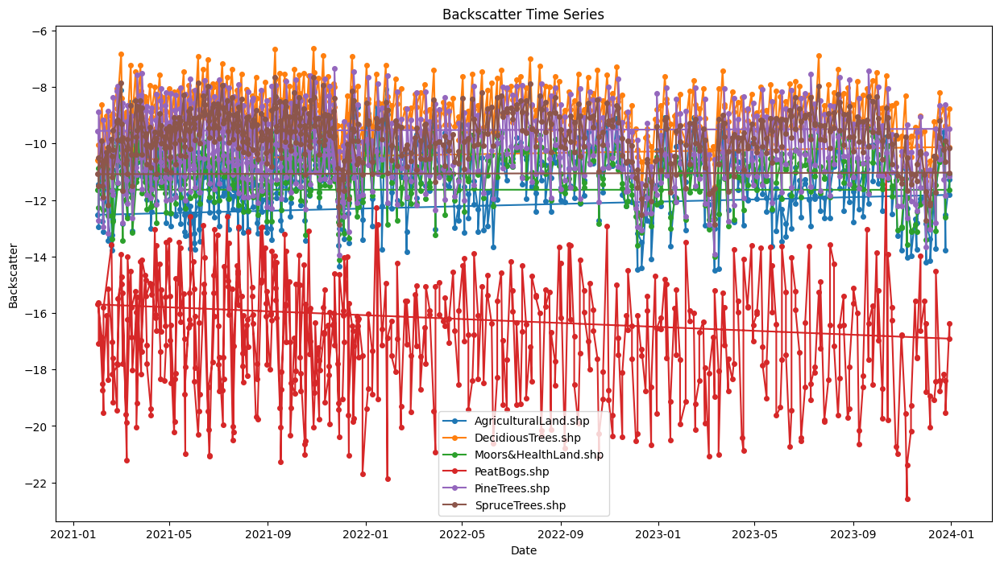

In [80]:
fig, ax = plt.subplots(figsize=(15, 8))

for shp in shapefiles:
    shp_indices = indices_df[indices_df['Shapefile'] == shp]
    ax.plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle='-', marker='o', markersize=4)

ax.set_title('Backscatter Time Series')
ax.set_xlabel('Date')
ax.set_ylabel('Backscatter')
ax.legend()
plt.show()

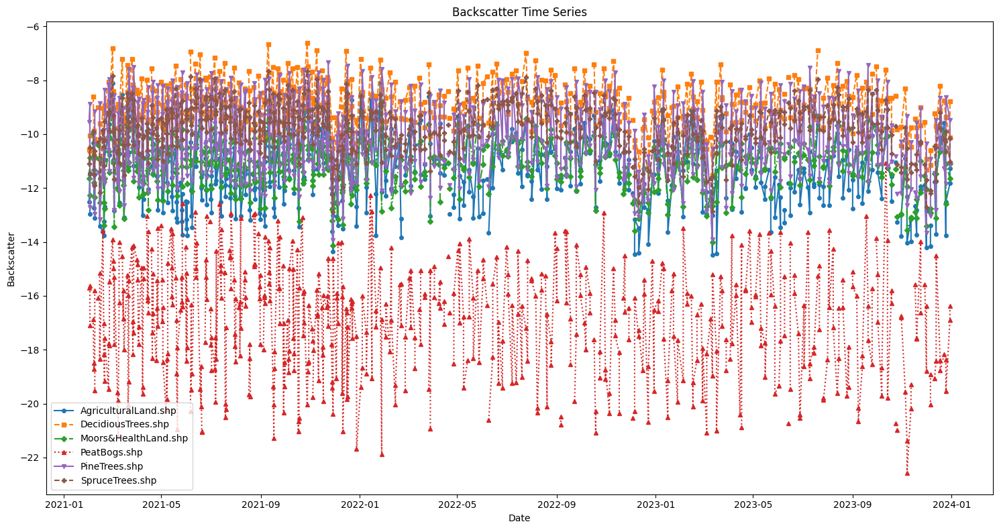

In [81]:
import matplotlib.pyplot as plt
import os

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot Backscatter time series for all shapefiles in a single figure and save as PNG
fig, ax = plt.subplots(figsize=(15, 8))

for i, shp in enumerate(shapefiles):
    shp_indices = indices_df[indices_df['Shapefile'] == shp].sort_values(by='Date')
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    ax.plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)

ax.set_title('Backscatter Time Series')
ax.set_xlabel('Date')
ax.set_ylabel('Backscatter')
ax.legend()

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Backscatter_Time_Series_All_Shapefiles.png'))
plt.show()

Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2021-01-03  0.026103  0.039157  0.251119  AgriculturalLand.shp          NaN
1 2021-01-13  0.007766  0.011653  0.193067  AgriculturalLand.shp          NaN
2 2021-02-02  0.008083  0.012125  0.096731  AgriculturalLand.shp          NaN
3 2021-02-03  0.032147  0.048220  0.230961  AgriculturalLand.shp          NaN
4 2021-02-05  0.025972  0.038958  0.214859  AgriculturalLand.shp          NaN
Checking for NaN values in Backscatter:
           Date      NDVI      SAVI       GCI             Shapefile  \
0    2021-01-03  0.026103  0.039157  0.251119  AgriculturalLand.shp   
1    2021-01-13  0.007766  0.011653  0.193067  AgriculturalLand.shp   
2    2021-02-02  0.008083  0.012125  0.096731  AgriculturalLand.shp   
3    2021-02-03  0.032147  0.048220  0.230961  AgriculturalLand.shp   
4    2021-02-05  0.025972  0.038958  0.214859  AgriculturalLand.shp   
...         ...       ...       ...       ...                   ..

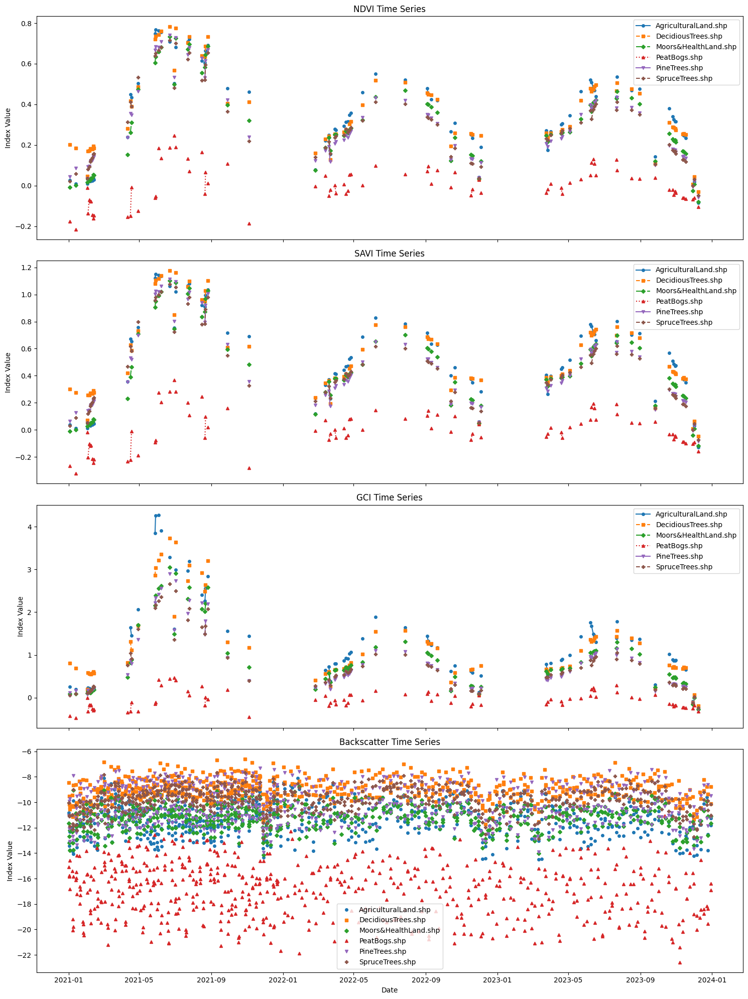

In [83]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2021-01-01'
end_date = '2023-12-31'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 10))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None or backscatter_value == -9999:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None or backscatter_value == -9999:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Check for any NaN or constant values in Backscatter
print("Checking for NaN values in Backscatter:")
print(indices_df[indices_df['Backscatter'].isna()])

print("Checking for constant values in Backscatter:")
constant_values = indices_df['Backscatter'].value_counts()
print(constant_values[constant_values > 1])

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, and Backscatter time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(4, 1, figsize=(15, 20), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = indices_df[indices_df['Shapefile'] == shp].sort_values(by='Date')
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle='None', marker=marker, markersize=4)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')

for ax in axs:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()

# Save individual plots for each shapefile
for i, shp in enumerate(shapefiles):
    shp_indices = indices_df[indices_df['Shapefile'] == shp].sort_values(by='Date')
    fig, axs = plt.subplots(4, 1, figsize=(15, 20), sharex=True)
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label='NDVI', linestyle='-', marker='o', markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label='SAVI', linestyle='-', marker='o', markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label='GCI', linestyle='-', marker='o', markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label='Backscatter', linestyle='None', marker='o', markersize=4)

    axs[0].set_title(f'NDVI Time Series for {shp}')
    axs[1].set_title(f'SAVI Time Series for {shp}')
    axs[2].set_title(f'GCI Time Series for {shp}')
    axs[3].set_title(f'Backscatter Time Series for {shp}')

    for ax in axs:
        ax.set_ylabel('Index Value')
        ax.legend()

    axs[-1].set_xlabel('Date')

    plt.tight_layout()
    plt.savefig(os.path.join(plot_directory, f'Indices_Time_Series_{shp}.png'))
    plt.close(fig)

Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN


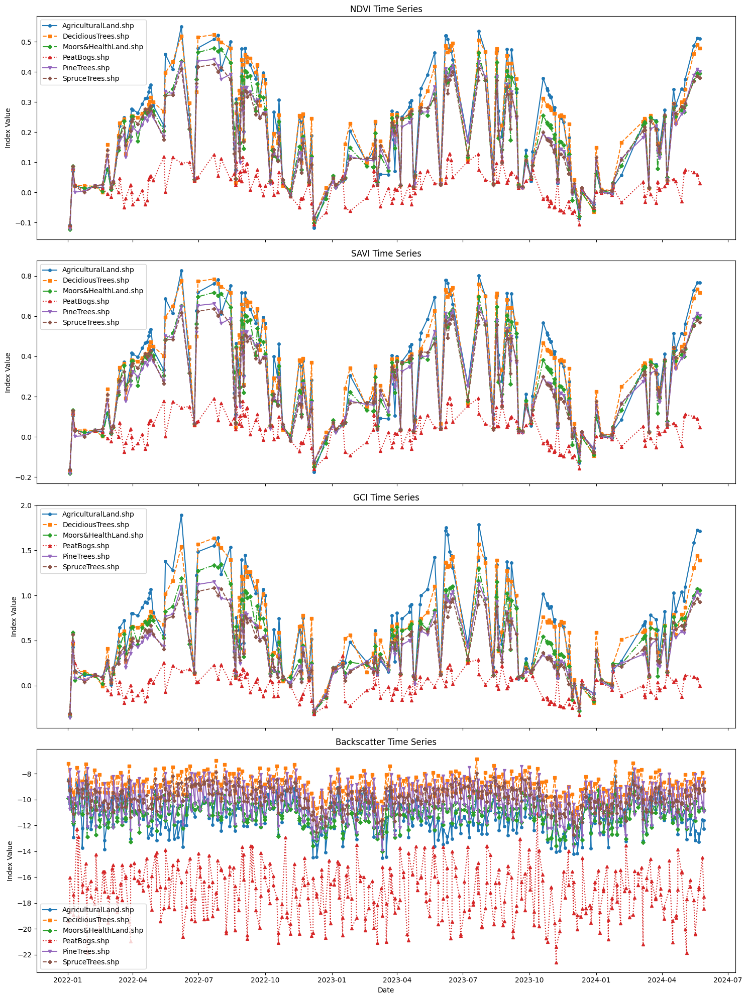

In [91]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-01-01'
end_date = '2024-05-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, and Backscatter time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(4, 1, figsize=(15, 20), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = indices_df[indices_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')

for ax in axs:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()


In [94]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
from datetime import datetime

# Initialize the Earth Engine module.
#ee.Initialize()
# Define the location and date range.
location = ee.Geometry.Point(5.032779673636611, 61.362695116812176)
start_date = '2022-01-01'
end_date = '2024-05-30'

# Fetch ERA5 temperature and precipitation data.
era5 = ee.ImageCollection('ECMWF/ERA5/DAILY')

# Define function to extract temperature and precipitation.
def extract_data(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('mean_2m_air_temperature').subtract(273.15).rename('Temperature')  # Convert from Kelvin to Celsius
    precip = image.select('total_precipitation').rename('Precipitation')
    temp = temp.set('date', date)
    precip = precip.set('date', date)
    return temp.addBands(precip)

# Filter ERA5 data for the date range and location.
era5_filtered = era5.filterDate(start_date, end_date).filterBounds(location).map(extract_data)

# Aggregate temperature and precipitation data over time.
def aggregate_data(image, list):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('Temperature').reduceRegion(
        reducer=ee.Reducer.mean(),
        geometry=location,
        scale=10000
    ).get('Temperature')
    precip = image.select('Precipitation').reduceRegion(
        reducer=ee.Reducer.sum(),
        geometry=location,
        scale=10000
    ).get('Precipitation')
    feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
    return ee.List(list).add(feature)

# Iterate over the filtered collection to aggregate data.
initial_list = ee.List([])
data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))

# Convert the list to a FeatureCollection
data_fc = ee.FeatureCollection(data_time_series)

# Get the data values and dates.
data_info = data_fc.getInfo()

# Debugging: print data_info to check if 'date' field is present
print("Data Info:", data_info)

# Convert data to pandas DataFrame.
data_list = []
for feature in data_info['features']:
    properties = feature['properties']
    # Debugging: print properties to check if 'date' field is present
    print("Properties:", properties)
    data_list.append({
        'Date': properties.get('date'),
        'Temperature': properties.get('Temperature'),
        'Precipitation': properties.get('Precipitation')
    })

data_df = pd.DataFrame(data_list)

# Convert 'Date' column to datetime
data_df['Date'] = pd.to_datetime(data_df['Date'])

# Display the DataFrame to ensure data is collected
print(data_df.head())

# Directory to save plots
plot_directory = 'Climate_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Plot temperature and precipitation time series and save as PNG
fig, ax1 = plt.subplots(figsize=(15, 8))

ax2 = ax1.twinx()
ax1.plot(data_df['Date'], data_df['Temperature'], 'g-')
ax2.plot(data_df['Date'], data_df['Precipitation'], 'b-')

ax1.set_xlabel('Date')
ax1.set_ylabel('Temperature (°C)', color='g')
ax2.set_ylabel('Precipitation (mm)', color='b')

plt.title('Temperature and Precipitation Time Series')
fig.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Temperature_Precipitation_Time_Series.png'))
plt.show()


Data Info: {'type': 'FeatureCollection', 'columns': {}, 'features': []}


KeyError: 'Date'

In [96]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to extract ERA5 data.
def extract_data(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('mean_2m_air_temperature').subtract(273.15).rename('Temperature')  # Convert from Kelvin to Celsius
    precip = image.select('total_precipitation').rename('Precipitation')
    return temp.addBands(precip).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-01-01'
end_date = '2024-04-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Fetch ERA5 temperature and precipitation data.
era5 = ee.ImageCollection('ECMWF/ERA5/DAILY')

# Filter ERA5 data for the date range and location.
era5_filtered = era5.filterDate(start_date, end_date).filterBounds(geometry).map(extract_data)

# Function to aggregate data over time.
def aggregate_data(image, list):
    date = image.get('date')
    temp = image.select('Temperature').reduceRegion(
        reducer=ee.Reducer.mean(),
        geometry=geometry,
        scale=10000
    ).get('Temperature')
    precip = image.select('Precipitation').reduceRegion(
        reducer=ee.Reducer.sum(),
        geometry=geometry,
        scale=10000
    ).get('Precipitation')
    feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
    return ee.List(list).add(feature)

# Iterate over the filtered collection to aggregate data.
initial_list = ee.List([])
data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))

# Convert the list to a FeatureCollection
data_fc = ee.FeatureCollection(data_time_series)

# Get the data values and dates.
data_info = data_fc.getInfo()

# Convert data to pandas DataFrame.
data_list = []
for feature in data_info['features']:
    properties = feature['properties']
    data_list.append({
        'Date': properties['date'],
        'Temperature': properties['Temperature'],
        'Precipitation': properties['Precipitation']
    })

data_df = pd.DataFrame(data_list)

# Convert 'Date' column to datetime
data_df['Date'] = pd.to_datetime(data_df['Date'])

# Display the DataFrame to ensure data is collected
print(data_df.head())

# Merge the indices DataFrame with the ERA5 data DataFrame
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Display the combined DataFrame to ensure data is merged correctly
print(combined_df.head())

# Directory to save plots
plot_directory = 'Combined_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)
    
# Plot temperature and precipitation (without shapefile differentiation)
axs[4].plot(combined_df['Date'], combined_df['Temperature'], 'g-', label='Temperature')
axs[5].plot(combined_df['Date'], combined_df['Precipitation'], 'b-', label='Precipitation')

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs[:4]:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[4].set_ylabel('Temperature (°C)')
axs[5].set_ylabel('Precipitation (mm)')

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Combined_Time_Series_All_Shapefiles.png'))
plt.show()

# Plot Temperature and Precipitation map for a specific date
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Define a specific date for plotting the map.
specific_date = '2023-01-01'
specific_image = era5_filtered.filterDate(specific_date, specific_date).first()

# Define visualization parameters for temperature and precipitation.
temp_params = {
    'min': -40,
    'max': 40,
    'palette': ['blue', 'cyan', 'green', 'yellow', 'red']
}

precip_params = {
    'min': 0,
    'max': 50,
    'palette': ['white', 'blue', 'darkblue']
}

# Add layers to the map.
Map.addLayer(specific_image.select('Temperature'), temp_params, 'Temperature')
Map.addLayer(specific_image.select('Precipitation'), precip_params, 'Precipitation')

# Display the map.
Map.addLayerControl()  # This will add a layer control panel to the map.
Map


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN


KeyError: 'Date'

In [98]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to extract ERA5 data.
def extract_data(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('mean_2m_air_temperature').subtract(273.15).rename('Temperature')  # Convert from Kelvin to Celsius
    precip = image.select('total_precipitation').rename('Precipitation')
    return temp.addBands(precip).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-01-01'
end_date = '2024-05-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Fetch ERA5 temperature and precipitation data.
era5 = ee.ImageCollection('ECMWF/ERA5/DAILY')

# Filter ERA5 data for the date range and location.
era5_filtered = era5.filterDate(start_date, end_date).filterBounds(geometry).map(extract_data)

# Function to aggregate data over time.
def aggregate_data(image, list):
    properties = image.reduceRegion(
        reducer=ee.Reducer.mean(),
        geometry=geometry,
        scale=10000
    ).toDictionary()
    date = image.get('date')
    properties = properties.set('date', date)
    feature = ee.Feature(None, properties)
    return ee.List(list).add(feature)

# Iterate over the filtered collection to aggregate data.
initial_list = ee.List([])
data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))

# Convert the list to a FeatureCollection
data_fc = ee.FeatureCollection(data_time_series)

# Get the data values and dates.
data_info = data_fc.getInfo()

# Convert data to pandas DataFrame.
data_list = []
for feature in data_info['features']:
    properties = feature['properties']
    data_list.append({
        'Date': properties['date'],
        'Temperature': properties.get('Temperature'),
        'Precipitation': properties.get('Precipitation')
    })

print(data_list)  # Debugging statement to check the content of data_list

data_df = pd.DataFrame(data_list)

# Check if 'Date' column exists
print(data_df.columns)  # Debugging statement to inspect DataFrame columns

# Convert 'Date' column to datetime
if 'Date' in data_df.columns:
    data_df['Date'] = pd.to_datetime(data_df['Date'])
else:
    print("Error: 'Date' column not found in data_df")

# Display the DataFrame to ensure data is collected
print(data_df.head())

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='outer')

# Directory to save plots
plot_directory = 'Combined_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)

# Plot temperature and precipitation (without shapefile differentiation)
axs[4].plot(combined_df['Date'], combined_df['Temperature'], 'g-', label='Temperature')
axs[5].plot(combined_df['Date'], combined_df['Precipitation'], 'b-', label='Precipitation')

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs[:4]:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[4].set_ylabel('Temperature (°C)')
axs[5].set_ylabel('Precipitation (mm)')

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Combined_Time_Series_All_Shapefiles.png'))
plt.show()

# Plot Temperature and Precipitation map for a specific date
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Define a specific date for plotting the map.
specific_date = '2023-01-01'
specific_image = era5_filtered.filterDate(specific_date, specific_date).first()

# Define visualization parameters for temperature and precipitation.
temp_params = {
    'min': -40,
    'max': 40,
    'palette': ['blue', 'cyan', 'green', 'yellow', 'red']
}

precip_params = {
    'min': 0,
    'max': 50,
    'palette': ['white', 'blue', 'darkblue']
}

# Add layers to the map.
Map.addLayer(specific_image.select('Temperature'), temp_params, 'Temperature')
Map.addLayer(specific_image.select('Precipitation'), precip_params, 'Precipitation')

# Display the map.
Map.addLayerControl()  # This will add a layer control panel to the map.
Map


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN


AttributeError: 'Dictionary' object has no attribute 'toDictionary'

In [102]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to extract ERA5 data.
def extract_data(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('mean_2m_air_temperature').subtract(273.15).rename('Temperature')  # Convert from Kelvin to Celsius
    precip = image.select('total_precipitation').rename('Precipitation')
    return temp.addBands(precip).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-01-01'
end_date = '2024-04-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Fetch ERA5 temperature and precipitation data.
era5 = ee.ImageCollection('ECMWF/ERA5/DAILY')

# Filter ERA5 data for the date range and location.
era5_filtered = era5.filterDate(start_date, end_date).filterBounds(geometry).map(extract_data)

# Function to aggregate data over time.
def aggregate_data(image, list):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('Temperature').reduceRegion(
        reducer=ee.Reducer.mean(),
        geometry=geometry,
        scale=10000
    ).get('Temperature')
    precip = image.select('Precipitation').reduceRegion(
        reducer=ee.Reducer.sum(),
        geometry=geometry,
        scale=10000
    ).get('Precipitation')
    feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
    return ee.List(list).add(feature)

# Iterate over the filtered collection to aggregate data.
initial_list = ee.List([])
data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))

# Convert the list to a FeatureCollection
data_fc = ee.FeatureCollection(data_time_series)

# Get the data values and dates.
data_info = data_fc.getInfo()

# Convert data to pandas DataFrame.
data_list = []
for feature in data_info['features']:
    properties = feature['properties']
    data_list.append({
        'Date': properties['date'],
        'Temperature': properties.get('Temperature'),
        'Precipitation': properties.get('Precipitation')
    })

print(data_list)  # Debugging statement to check the content of data_list

data_df = pd.DataFrame(data_list)

# Check if 'Date' column exists
print(data_df.columns)  # Debugging statement to inspect DataFrame columns

# Convert 'Date' column to datetime
if 'Date' in data_df.columns:
    data_df['Date'] = pd.to_datetime(data_df['Date'])
else:
    print("Error: 'Date' column not found in data_df")

# Display the DataFrame to ensure data is collected
print(data_df.head())

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Display the combined DataFrame to ensure data is merged correctly
print(combined_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)

# Plot temperature and precipitation (without shapefile differentiation)
axs[4].plot(combined_df['Date'], combined_df['Temperature'], 'g-', label='Temperature')
axs[5].plot(combined_df['Date'], combined_df['Precipitation'], 'b-', label='Precipitation')

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs[:4]:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[4].set_ylabel('Temperature (°C)')
axs[5].set_ylabel('Precipitation (mm)')

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Combined_Time_Series_All_Shapefiles.png'))
plt.show()

# Plot Temperature and Precipitation map for a specific date
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Define a specific date for plotting the map.
specific_date = '2023-01-01'
specific_image = era5_filtered.filterDate(specific_date, specific_date).first()

# Define visualization parameters for temperature and precipitation.
temp_params = {
    'min': -40,
    'max': 40,
    'palette': ['blue', 'cyan', 'green', 'yellow', 'red']
}

precip_params = {
    'min': 0,
    'max': 50,
    'palette': ['white', 'blue', 'darkblue']
}

# Add layers to the map.
Map.addLayer(specific_image.select('Temperature'), temp_params, 'Temperature')
Map.addLayer(specific_image.select('Precipitation'), precip_params, 'Precipitation')

# Display the map.
Map.addLayerControl()  # This will add a layer control panel to the map.
Map


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN
[]
RangeIndex(start=0, stop=0, step=1)
Error: 'Date' column not found in data_df
Empty DataFrame
Columns: []
Index: []


KeyError: 'Date'

In [103]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to extract ERA5 data.
def extract_data(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    temp = image.select('mean_2m_air_temperature').subtract(273.15).rename('Temperature')  # Convert from Kelvin to Celsius
    precip = image.select('total_precipitation').rename('Precipitation')
    return temp.addBands(precip).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-01-01'
end_date = '2024-04-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = np.nan
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = np.nan
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print(indices_df.head())

# Fetch ERA5 temperature and precipitation data.
era5 = ee.ImageCollection('ECMWF/ERA5/DAILY')

# Filter ERA5 data for the date range and location.
era5_filtered = era5.filterDate(start_date, end_date).filterBounds(geometry).map(extract_data)

# Function to aggregate data over time.
def aggregate_data(image, list):
    date = image.get('date')
    temp = image.select('Temperature').reduceRegion(
        reducer=ee.Reducer.mean(),
        geometry=geometry,
        scale=10000
    ).get('Temperature')
    precip = image.select('Precipitation').reduceRegion(
        reducer=ee.Reducer.sum(),
        geometry=geometry,
        scale=10000
    ).get('Precipitation')
    feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
    return ee.List(list).add(feature)

# Iterate over the filtered collection to aggregate data.
initial_list = ee.List([])
data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))

# Convert the list to a FeatureCollection
data_fc = ee.FeatureCollection(data_time_series)

# Get the data values and dates.
data_info = data_fc.getInfo()

# Convert data to pandas DataFrame.
data_list = []
for feature in data_info['features']:
    properties = feature['properties']
    data_list.append({
        'Date': properties['date'],
        'Temperature': properties.get('Temperature'),
        'Precipitation': properties.get('Precipitation')
    })

print(data_list)  # Debugging statement to check the content of data_list

data_df = pd.DataFrame(data_list)

# Check if 'Date' column exists
print(data_df.columns)  # Debugging statement to inspect DataFrame columns

# Convert 'Date' column to datetime
if 'Date' in data_df.columns:
    data_df['Date'] = pd.to_datetime(data_df['Date'])
else:
    print("Error: 'Date' column not found in data_df")

# Display the DataFrame to ensure data is collected
print(data_df.head())

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Display the combined DataFrame to ensure data is merged correctly
print(combined_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)

# Plot temperature and precipitation (without shapefile differentiation)
axs[4].plot(combined_df['Date'], combined_df['Temperature'], 'g-', label='Temperature')
axs[5].plot(combined_df['Date'], combined_df['Precipitation'], 'b-', label='Precipitation')

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs[:4]:
    ax.set_ylabel('Index Value')
    ax.legend()

axs[4].set_ylabel('Temperature (°C)')
axs[5].set_ylabel('Precipitation (mm)')

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Combined_Time_Series_All_Shapefiles.png'))
plt.show()

# Plot Temperature and Precipitation map for a specific date
Map = geemap.Map(center=[61.362695116812176, 5.032779673636611], zoom=10)

# Define a specific date for plotting the map.
specific_date = '2023-01-01'
specific_image = era5_filtered.filterDate(specific_date, specific_date).first()

# Define visualization parameters for temperature and precipitation.
temp_params = {
    'min': -40,
    'max': 40,
    'palette': ['blue', 'cyan', 'green', 'yellow', 'red']
}

precip_params = {
    'min': 0,
    'max': 50,
    'palette': ['white', 'blue', 'darkblue']
}

# Add layers to the map.
Map.addLayer(specific_image.select('Temperature'), temp_params, 'Temperature')
Map.addLayer(specific_image.select('Precipitation'), precip_params, 'Precipitation')

# Display the map.
Map.addLayerControl()  # This will add a layer control panel to the map.
Map


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN
[]
RangeIndex(start=0, stop=0, step=1)
Error: 'Date' column not found in data_df
Empty DataFrame
Columns: []
Index: []


KeyError: 'Date'

In [104]:
# Print the indices_df to confirm its structure
print("Contents of indices_df:")
print(indices_df.head())

# Print the columns of data_df to check if 'Date' exists
print("Columns in data_df:")
print(data_df.columns)

# Print the first few rows of data_df to understand its structure
print("Contents of data_df:")
print(data_df.head())


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN
Columns in data_df:
RangeIndex(start=0, stop=0, step=1)
Contents of data_df:
Empty DataFrame
Columns: []
Index: []


In [105]:
# Check if the ERA5 collection contains data
print("ERA5 collection size:", era5_filtered.size().getInfo())

# Print a sample of the ERA5 data
print("Sample ERA5 data:")
print(era5_filtered.first().getInfo())


ERA5 collection size: 0
Sample ERA5 data:
None


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN
1 2022-01-08  0.070623  0.105929  0.428962  AgriculturalLand.shp          NaN
2 2022-01-11  0.023529  0.035292  0.167001  AgriculturalLand.shp          NaN
3 2022-01-24  0.012755  0.019131  0.114865  AgriculturalLand.shp          NaN
4 2022-02-08  0.018510  0.027764  0.113483  AgriculturalLand.shp          NaN
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-01-01   276.981720       0.013578
1 2022-01-01   276.447861       0.000001
2 2022-01-01   275.922394       0.000004
3 2022-01-01   275.488739       0.000006
4 2022-01-01   275.152588       0.000008
Contents of combined_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-01-04 -0.107423 -0.161104 -0.307884  AgriculturalLand.shp          NaN   
1 2022-01-04 -0.107423 -0.161104 -0.307884  Agricultur

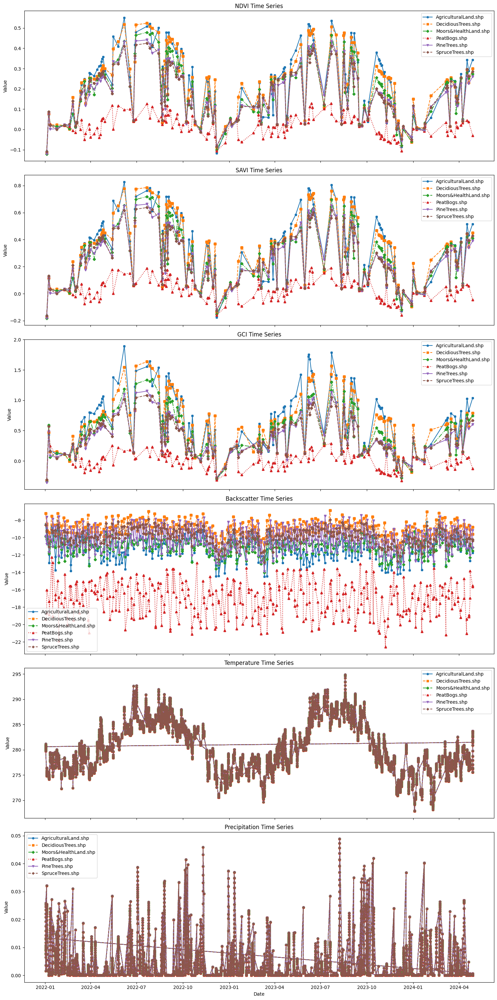

In [110]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import os

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-01-01'
end_date = '2024-04-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = None
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = None
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print("Contents of indices_df:")
print(indices_df.head())

# Load ERA5 data
region = ee.Geometry.Point([5.032779673636611, 61.362695116812176])
era5_collection = ee.ImageCollection('ECMWF/ERA5_LAND/HOURLY').filterBounds(region)

# Use an iterate function to aggregate temperature and precipitation data in smaller chunks.
data_list = []

# Define the start and end dates for the iteration
current_start_date = datetime.strptime(start_date, '%Y-%m-%d')
end_date_dt = datetime.strptime(end_date, '%Y-%m-%d')

while current_start_date < end_date_dt:
    current_end_date = current_start_date + timedelta(days=30)
    if current_end_date > end_date_dt:
        current_end_date = end_date_dt
    
    era5_filtered = era5_collection.filterDate(current_start_date.strftime('%Y-%m-%d'), current_end_date.strftime('%Y-%m-%d'))
    
    def aggregate_data(image, list):
        date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
        temp = image.select('temperature_2m').reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=region,
            scale=10000
        ).get('temperature_2m')
        precip = image.select('total_precipitation').reduceRegion(
            reducer=ee.Reducer.sum(),
            geometry=region,
            scale=10000
        ).get('total_precipitation')
        feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
        return ee.List(list).add(feature)
    
    initial_list = ee.List([])
    data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))
    
    # Convert the list to a FeatureCollection
    data_fc = ee.FeatureCollection(data_time_series)
    
    # Get the data values and dates
    data_info = data_fc.getInfo()
    
    # Append data to list
    for feature in data_info['features']:
        properties = feature['properties']
        data_list.append({
            'Date': properties['date'],
            'Temperature': properties['Temperature'],
            'Precipitation': properties['Precipitation']
        })
    
    # Move to the next time chunk
    current_start_date = current_end_date

# Create a DataFrame from the aggregated data
data_df = pd.DataFrame(data_list)

# Convert 'Date' column to datetime
data_df['Date'] = pd.to_datetime(data_df['Date'])

# Display the DataFrame to ensure data is collected
print("Contents of data_df:")
print(data_df.head())

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Display the combined DataFrame to ensure data is merged correctly
print("Contents of combined_df:")
print(combined_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[4].plot(shp_indices['Date'], shp_indices['Temperature'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[5].plot(shp_indices['Date'], shp_indices['Precipitation'], label=shp, linestyle=style, marker=marker, markersize=4)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs:
    ax.set_ylabel('Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()


Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Contents of combined_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN   
1 2022-05-14  0.221057  0.331561  0.566053  Agricultur

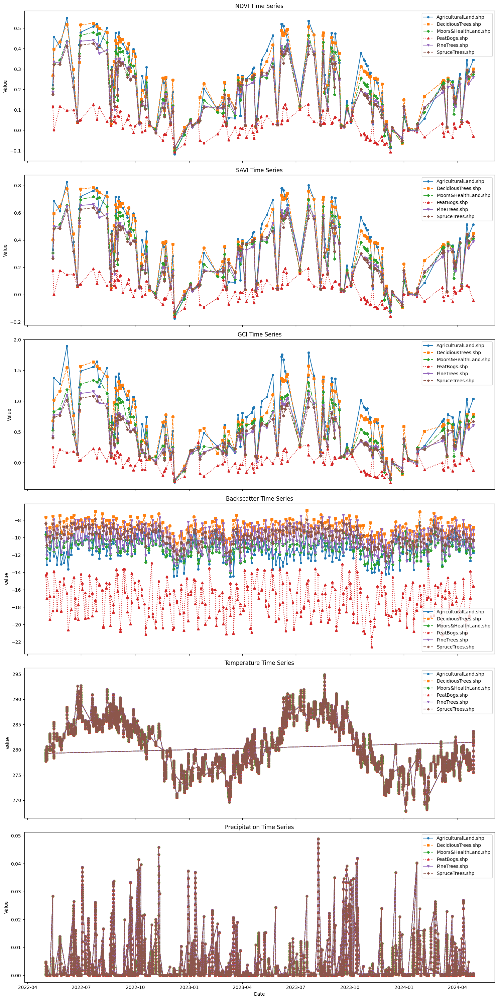

In [111]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import os

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-05-01'
end_date = '2024-04-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = None
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = None
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print("Contents of indices_df:")
print(indices_df.head())

# Load ERA5 data
region = ee.Geometry.Point([5.032779673636611, 61.362695116812176])
era5_collection = ee.ImageCollection('ECMWF/ERA5_LAND/HOURLY').filterBounds(region)

# Use an iterate function to aggregate temperature and precipitation data in smaller chunks.
data_list = []

# Define the start and end dates for the iteration
current_start_date = datetime.strptime(start_date, '%Y-%m-%d')
end_date_dt = datetime.strptime(end_date, '%Y-%m-%d')

while current_start_date < end_date_dt:
    current_end_date = current_start_date + timedelta(days=30)
    if current_end_date > end_date_dt:
        current_end_date = end_date_dt
    
    era5_filtered = era5_collection.filterDate(current_start_date.strftime('%Y-%m-%d'), current_end_date.strftime('%Y-%m-%d'))
    
    def aggregate_data(image, list):
        date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
        temp = image.select('temperature_2m').reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=region,
            scale=10000
        ).get('temperature_2m')
        precip = image.select('total_precipitation').reduceRegion(
            reducer=ee.Reducer.sum(),
            geometry=region,
            scale=10000
        ).get('total_precipitation')
        feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
        return ee.List(list).add(feature)
    
    initial_list = ee.List([])
    data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))
    
    # Convert the list to a FeatureCollection
    data_fc = ee.FeatureCollection(data_time_series)
    
    # Get the data values and dates
    data_info = data_fc.getInfo()
    
    # Append data to list
    for feature in data_info['features']:
        properties = feature['properties']
        data_list.append({
            'Date': properties['date'],
            'Temperature': properties['Temperature'],
            'Precipitation': properties['Precipitation']
        })
    
    # Move to the next time chunk
    current_start_date = current_end_date

# Create a DataFrame from the aggregated data
data_df = pd.DataFrame(data_list)

# Convert 'Date' column to datetime
data_df['Date'] = pd.to_datetime(data_df['Date'])

# Display the DataFrame to ensure data is collected
print("Contents of data_df:")
print(data_df.head())

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Display the combined DataFrame to ensure data is merged correctly
print("Contents of combined_df:")
print(combined_df.head())

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[4].plot(shp_indices['Date'], shp_indices['Temperature'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[5].plot(shp_indices['Date'], shp_indices['Precipitation'], label=shp, linestyle=style, marker=marker, markersize=4)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs:
    ax.set_ylabel('Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()

Possible issue encountered when converting Shape #1 to GeoJSON: Shapefile format requires that polygons contain at least one exterior ring, but the Shape was entirely made up of interior holes (defined by counter-clockwise orientation in the shapefile format). The rings were still included but were encoded as GeoJSON exterior rings instead of holes.


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Contents of combined_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN   
1 2022-05-14  0.221057  0.331561  0.566053  Agricultur

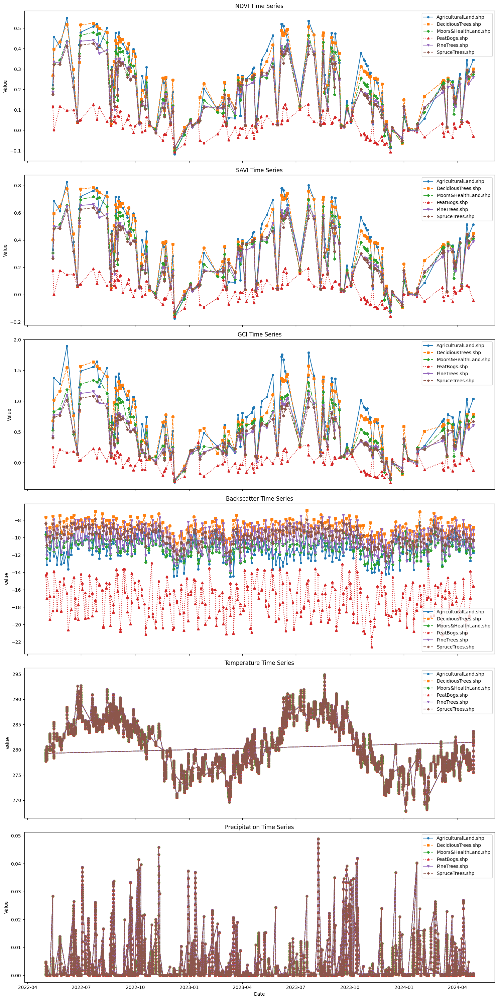

In [27]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import os

# Initialize the Earth Engine module.
ee.Initialize()

# Define function to calculate NDVI, SAVI, and GCI.
def calculate_indices(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    savi = image.expression(
        '((NIR - RED) / (NIR + RED + L)) * (1 + L)',
        {
            'NIR': image.select('B8'),
            'RED': image.select('B4'),
            'L': 0.5
        }
    ).rename('SAVI')
    gci = image.expression(
        'NIR / GREEN - 1',
        {
            'NIR': image.select('B8'),
            'GREEN': image.select('B3')
        }
    ).rename('GCI')
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    return ndvi.addBands(savi).addBands(gci).set('system:time_start', image.get('system:time_start')).set('date', date)

# Define function to calculate backscatter from Sentinel-1.
def calculate_backscatter(image):
    date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
    vv = image.select('VV').rename('Backscatter')
    return vv.set('system:time_start', image.get('system:time_start')).set('date', date)

# Path to the folder containing the shapefiles.
shp_folder = 'Shapefiles/'

# List of shapefiles in the folder.
shapefiles = ['AgriculturalLand.shp', 'DecidiousTrees.shp', 'Moors&HealthLand.shp', 'PeatBogs.shp', 'PineTrees.shp', 'SpruceTrees.shp']

# Function to check if the shapefile exists
def shapefile_exists(path):
    return os.path.exists(path)

# DataFrame to store indices time series.
indices_df = pd.DataFrame()

# Define the date range.
start_date = '2022-05-01'
end_date = '2024-04-30'

# Process each shapefile.
for shp in shapefiles:
    shp_path = os.path.join(shp_folder, shp)
    
    if not shapefile_exists(shp_path):
        print(f"Shapefile {shp_path} does not exist.")
        continue

    # Load the shapefile.
    shapefile_fc = geemap.shp_to_ee(shp_path)
    
    if shapefile_fc is None:
        print(f"Could not load shapefile {shp_path}.")
        continue

    geometry = shapefile_fc.geometry()

    # Load Sentinel-2 image collection, filter by cloud cover, and sort by cloud cover percentage.
    s2_collection = (ee.ImageCollection('COPERNICUS/S2')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 50))
                     .select(['B4', 'B8', 'B3'])
                     .map(calculate_indices))

    # Load Sentinel-1 image collection, filter by date and bounds.
    s1_collection = (ee.ImageCollection('COPERNICUS/S1_GRD')
                     .filterDate(start_date, end_date)
                     .filterBounds(geometry)
                     .filter(ee.Filter.listContains('transmitterReceiverPolarisation', 'VV'))
                     .select('VV')
                     .map(calculate_backscatter))

    # Use an iterate function to get indices values over time.
    def accumulate_indices(image, list):
        date = image.get('date')
        ndvi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('NDVI')
        savi_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('SAVI')
        gci_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('GCI')
        feature = ee.Feature(None, {'date': date, 'NDVI': ndvi_value, 'SAVI': savi_value, 'GCI': gci_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    def accumulate_backscatter(image, list):
        date = image.get('date')
        backscatter_value = image.reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=geometry,
            scale=10
        ).get('Backscatter')
        # Handle None values by replacing them with NaN
        if backscatter_value is None:
            backscatter_value = None
        feature = ee.Feature(None, {'date': date, 'Backscatter': backscatter_value, 'shapefile': shp})
        return ee.List(list).add(feature)

    initial_list = ee.List([])
    indices_time_series = ee.List(s2_collection.iterate(accumulate_indices, initial_list))
    backscatter_time_series = ee.List(s1_collection.iterate(accumulate_backscatter, initial_list))

    # Convert the lists to FeatureCollections
    indices_fc = ee.FeatureCollection(indices_time_series)
    backscatter_fc = ee.FeatureCollection(backscatter_time_series)

    # Get the indices values and dates
    indices_info = indices_fc.getInfo()
    backscatter_info = backscatter_fc.getInfo()

    for feature in indices_info['features']:
        date = feature['properties']['date']
        ndvi_value = feature['properties']['NDVI']
        savi_value = feature['properties']['SAVI']
        gci_value = feature['properties']['GCI']
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'NDVI': ndvi_value,
            'SAVI': savi_value,
            'GCI': gci_value,
            'Shapefile': shp
        }])], ignore_index=True)

    for feature in backscatter_info['features']:
        date = feature['properties']['date']
        backscatter_value = feature['properties']['Backscatter']
        if backscatter_value is None:
            backscatter_value = None
        indices_df = pd.concat([indices_df, pd.DataFrame([{
            'Date': date,
            'Backscatter': backscatter_value,
            'Shapefile': shp
        }])], ignore_index=True)

# Convert 'Date' column to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])

# Display the DataFrame to ensure data is collected
print("Contents of indices_df:")
print(indices_df.head())

# Save the indices DataFrame to a CSV file
indices_df.to_csv('indices_timeseries.csv', index=False)

# Load ERA5 data
region = ee.Geometry.Point([5.032779673636611, 61.362695116812176])
era5_collection = ee.ImageCollection('ECMWF/ERA5_LAND/HOURLY').filterBounds(region)

# Use an iterate function to aggregate temperature and precipitation data in smaller chunks.
data_list = []

# Define the start and end dates for the iteration
current_start_date = datetime.strptime(start_date, '%Y-%m-%d')
end_date_dt = datetime.strptime(end_date, '%Y-%m-%d')

while current_start_date < end_date_dt:
    current_end_date = current_start_date + timedelta(days=30)
    if current_end_date > end_date_dt:
        current_end_date = end_date_dt
    
    era5_filtered = era5_collection.filterDate(current_start_date.strftime('%Y-%m-%d'), current_end_date.strftime('%Y-%m-%d'))
    
    def aggregate_data(image, list):
        date = ee.Date(image.get('system:time_start')).format('YYYY-MM-dd')
        temp = image.select('temperature_2m').reduceRegion(
            reducer=ee.Reducer.mean(),
            geometry=region,
            scale=10000
        ).get('temperature_2m')
        precip = image.select('total_precipitation').reduceRegion(
            reducer=ee.Reducer.sum(),
            geometry=region,
            scale=10000
        ).get('total_precipitation')
        feature = ee.Feature(None, {'date': date, 'Temperature': temp, 'Precipitation': precip})
        return ee.List(list).add(feature)
    
    initial_list = ee.List([])
    data_time_series = ee.List(era5_filtered.iterate(aggregate_data, initial_list))
    
    # Convert the list to a FeatureCollection
    data_fc = ee.FeatureCollection(data_time_series)
    
    # Get the data values and dates
    data_info = data_fc.getInfo()
    
    # Append data to list
    for feature in data_info['features']:
        properties = feature['properties']
        data_list.append({
            'Date': properties['date'],
            'Temperature': properties['Temperature'],
            'Precipitation': properties['Precipitation']
        })
    
    # Move to the next time chunk
    current_start_date = current_end_date

# Create a DataFrame from the aggregated data
data_df = pd.DataFrame(data_list)

# Convert 'Date' column to datetime
data_df['Date'] = pd.to_datetime(data_df['Date'])

# Display the DataFrame to ensure data is collected
print("Contents of data_df:")
print(data_df.head())

# Save the ERA5 data to a CSV file
data_df.to_csv('era5_data.csv', index=False)

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Display the combined DataFrame to ensure data is merged correctly
print("Contents of combined_df:")
print(combined_df.head())

# Save the combined DataFrame to a CSV file
combined_df.to_csv('combined_timeseries.csv', index=False)

# Directory to save plots
plot_directory = 'Indices_Plots'
os.makedirs(plot_directory, exist_ok=True)

# Define different line styles and markers
line_styles = ['-', '--', '-.', ':']
markers = ['o', 's', 'D', '^', 'v', 'P']

# Plot NDVI, SAVI, GCI, Backscatter, Temperature, and Precipitation time series for all shapefiles in a single figure and save as PNG
fig, axs = plt.subplots(6, 1, figsize=(15, 30), sharex=True)

for i, shp in enumerate(shapefiles):
    shp_indices = combined_df[combined_df['Shapefile'] == shp]
    style = line_styles[i % len(line_styles)]
    marker = markers[i % len(markers)]
    axs[0].plot(shp_indices['Date'], shp_indices['NDVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[1].plot(shp_indices['Date'], shp_indices['SAVI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[2].plot(shp_indices['Date'], shp_indices['GCI'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[3].plot(shp_indices['Date'], shp_indices['Backscatter'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[4].plot(shp_indices['Date'], shp_indices['Temperature'], label=shp, linestyle=style, marker=marker, markersize=4)
    axs[5].plot(shp_indices['Date'], shp_indices['Precipitation'], label=shp, linestyle=style, marker=marker, markersize=4)

axs[0].set_title('NDVI Time Series')
axs[1].set_title('SAVI Time Series')
axs[2].set_title('GCI Time Series')
axs[3].set_title('Backscatter Time Series')
axs[4].set_title('Temperature Time Series')
axs[5].set_title('Precipitation Time Series')

for ax in axs:
    ax.set_ylabel('Value')
    ax.legend()

axs[-1].set_xlabel('Date')

plt.tight_layout()
plt.savefig(os.path.join(plot_directory, 'Indices_Time_Series_All_Shapefiles.png'))
plt.show()


In [3]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, LayerNormalization, MultiHeadAttention

# Load the combined dataset
combined_df = pd.read_csv('combined_timeseries.csv')

# Convert 'Date' column to datetime
combined_df['Date'] = pd.to_datetime(combined_df['Date'])

# Check for NaN values
print("Checking for NaN values in the dataset before processing:")
print(combined_df.isna().sum())

# Interpolate to fill NaN values
combined_df.interpolate(method='linear', inplace=True)

# Fill forward and backward for any remaining NaN values
combined_df.fillna(method='ffill', inplace=True)
combined_df.fillna(method='bfill', inplace=True)

# Ensure there are no remaining NaN values
print("Checking for NaN values in the dataset after processing:")
print(combined_df.isna().sum())

# Set 'Date' as the index
combined_df.set_index('Date', inplace=True)

# Split the data into features and targets
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
target = combined_df['NDVI']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for Transformer model [samples, time steps, features]
X_train_transformer = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_transformer = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Ensure target is in the correct shape
y_train_transformer = y_train.values
y_test_transformer = y_test.values


Checking for NaN values in the dataset before processing:
Date                 0
NDVI             43344
SAVI             43344
GCI              43344
Shapefile            0
Backscatter      19584
Temperature          0
Precipitation        0
dtype: int64
Checking for NaN values in the dataset after processing:
Date             0
NDVI             0
SAVI             0
GCI              0
Shapefile        0
Backscatter      0
Temperature      0
Precipitation    0
dtype: int64


In [33]:
# Define the Transformer model
def build_transformer_model(input_shape):
    inputs = Input(shape=input_shape)
    
    # Multi-head attention layer
    attention = MultiHeadAttention(num_heads=4, key_dim=input_shape[1])(inputs, inputs)
    attention = Dropout(0.1)(attention)
    attention = LayerNormalization(epsilon=1e-6)(attention)
    
    # Feed forward layer
    outputs = Dense(64, activation='relu')(attention)
    outputs = Dropout(0.1)(outputs)
    outputs = LayerNormalization(epsilon=1e-6)(outputs)
    outputs = Dense(1)(outputs)
    
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    return model

# Build and compile the Transformer model
transformer_model = build_transformer_model((1, X_train_scaled.shape[1]))

# Print model summary
transformer_model.summary()


Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_11 (InputLayer)       [(None, 1, 3)]               0         []                            
                                                                                                  
 multi_head_attention_10 (M  (None, 1, 3)                 183       ['input_11[0][0]',            
 ultiHeadAttention)                                                  'input_11[0][0]']            
                                                                                                  
 dropout_21 (Dropout)        (None, 1, 3)                 0         ['multi_head_attention_10[0][0
                                                                    ]']                           
                                                                                           

Epoch 1/20
1574/1574 [==============================] - 5s 2ms/step - loss: 0.0657
Epoch 2/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0142
Epoch 3/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0132
Epoch 4/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0132
Epoch 5/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0129
Epoch 6/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0129
Epoch 7/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0128
Epoch 8/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0128
Epoch 9/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0128
Epoch 10/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0128
Epoch 11/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0128
Epoch 12/20
1574/1574 [==============================] - 4s 2ms/step - loss: 0.0127
E

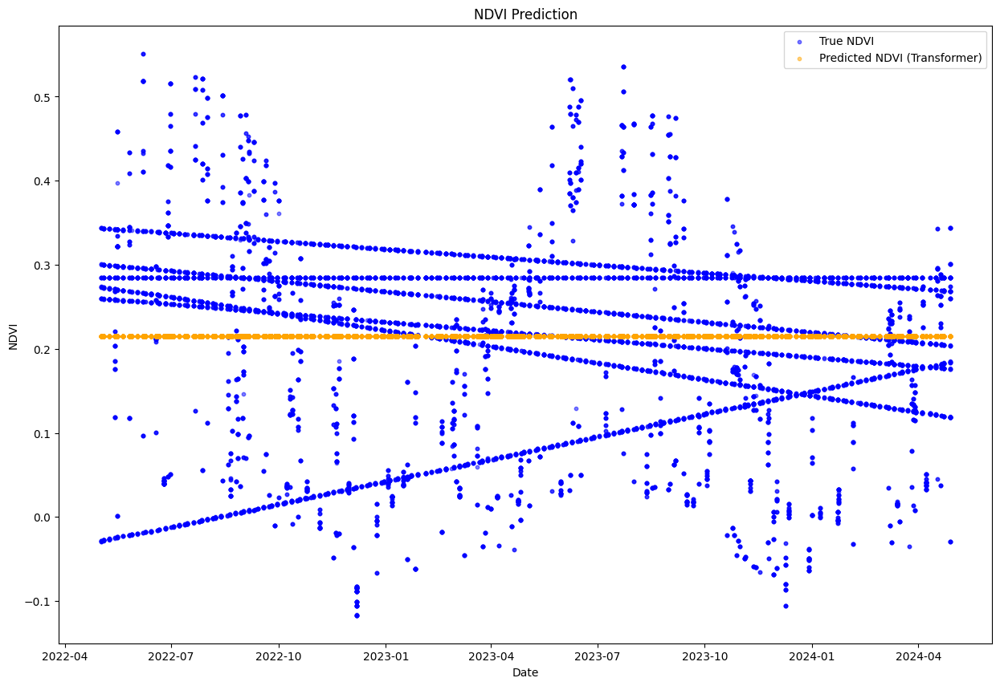

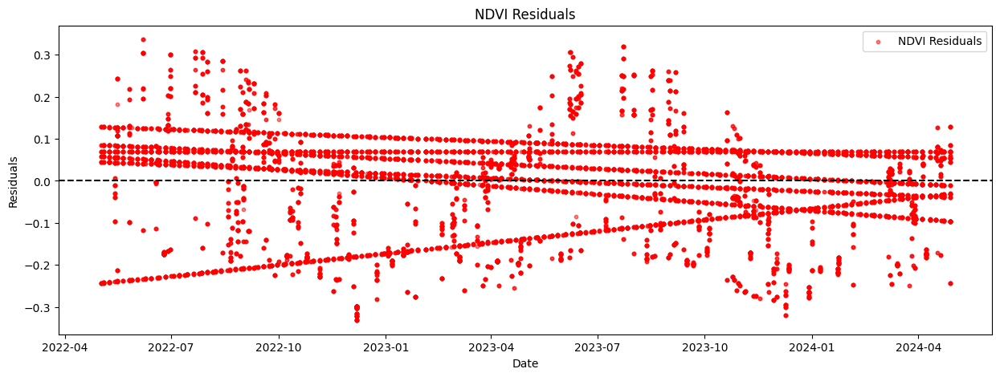

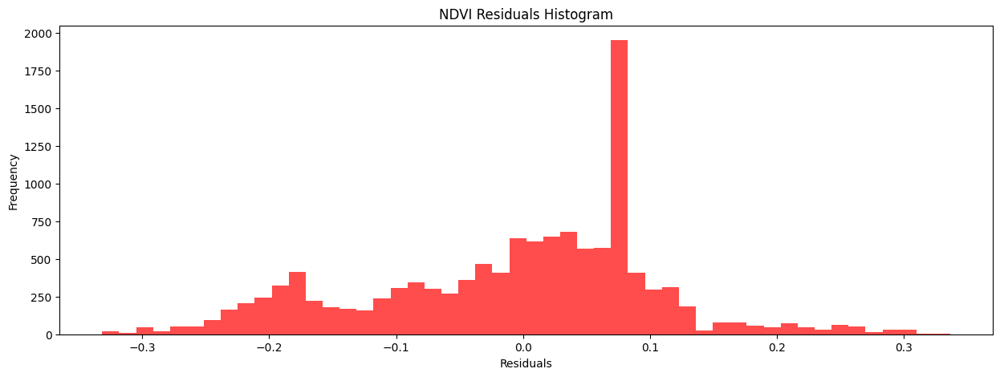

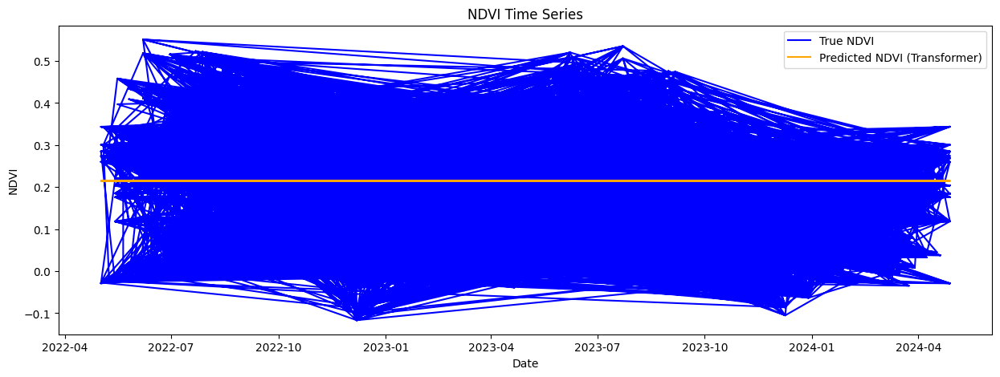

In [34]:
# Train the Transformer model
transformer_model.fit(X_train_transformer, y_train_transformer, epochs=20, batch_size=32, verbose=1)

# Predict using Transformer
transformer_predictions = transformer_model.predict(X_test_transformer)

# Reshape the predictions to match the shape of y_test
transformer_predictions = transformer_predictions.reshape(-1)

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test, transformer_predictions))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.scatter(y_test.index, y_test, label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions, label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')
plt.show()

# Residuals plot
residuals_ndvi = y_test - transformer_predictions

plt.figure(figsize=(15, 5))
plt.scatter(y_test.index, residuals_ndvi, label='NDVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('NDVI Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.show()

# Histogram of the residuals
plt.figure(figsize=(15, 5))
plt.hist(residuals_ndvi, bins=50, color='red', alpha=0.7)
plt.title('NDVI Residuals Histogram')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.show()

# Time series plot
plt.figure(figsize=(15, 5))
plt.plot(y_test.index, y_test, label='True NDVI', color='blue')
plt.plot(y_test.index, transformer_predictions, label='Predicted NDVI (Transformer)', color='orange')
plt.legend()
plt.title('NDVI Time Series')
plt.xlabel('Date')
plt.ylabel('NDVI')
plt.show()


In [112]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error

# Preprocess data
combined_df['Date'] = pd.to_datetime(combined_df['Date'])
combined_df.set_index('Date', inplace=True)

# Function to split data into training and testing sets
def train_test_split(data, train_size=0.8):
    train_len = int(len(data) * train_size)
    train = data[:train_len]
    test = data[train_len:]
    return train, test

# Function to apply ARIMA model
def apply_arima(train, test, col_name):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=(5,1,0))
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        history.append(test[t])
    return predictions

# Function to apply LSTM model
def apply_lstm(train, test, col_name, look_back=1):
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train.reshape(-1, 1))
    test_scaled = scaler.transform(test.reshape(-1, 1))
    
    def create_dataset(dataset, look_back=1):
        X, Y = [], []
        for i in range(len(dataset)-look_back-1):
            a = dataset[i:(i+look_back), 0]
            X.append(a)
            Y.append(dataset[i + look_back, 0])
        return np.array(X), np.array(Y)
    
    X_train, Y_train = create_dataset(train_scaled, look_back)
    X_test, Y_test = create_dataset(test_scaled, look_back)
    
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
    
    model = Sequential()
    model.add(LSTM(50, input_shape=(look_back, 1)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    model.fit(X_train, Y_train, epochs=100, batch_size=1, verbose=2)
    
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)
    
    train_predict = scaler.inverse_transform(train_predict)
    test_predict = scaler.inverse_transform(test_predict)
    
    return test_predict

# Predicting for each column
results = {}
for col in combined_df.columns:
    if col != 'Shapefile':
        print(f"Processing {col}...")
        data = combined_df[col].dropna().values
        train, test = train_test_split(data)
        
        # Apply ARIMA
        arima_predictions = apply_arima(train, test, col)
        arima_rmse = np.sqrt(mean_squared_error(test, arima_predictions))
        
        # Apply LSTM
        lstm_predictions = apply_lstm(train, test, col)
        lstm_rmse = np.sqrt(mean_squared_error(test, lstm_predictions))
        
        results[col] = {
            'ARIMA': {'predictions': arima_predictions, 'rmse': arima_rmse},
            'LSTM': {'predictions': lstm_predictions, 'rmse': lstm_rmse}
        }
        print(f"{col} - ARIMA RMSE: {arima_rmse}, LSTM RMSE: {lstm_rmse}")

# Visualize the predictions
for col in combined_df.columns:
    if col != 'Shapefile':
        plt.figure(figsize=(12, 6))
        plt.plot(combined_df[col].dropna().index, combined_df[col].dropna().values, label='Actual')
        plt.plot(combined_df[col].dropna().index[len(train):], results[col]['ARIMA']['predictions'], label='ARIMA Predictions')
        plt.plot(combined_df[col].dropna().index[len(train):], results[col]['LSTM']['predictions'], label='LSTM Predictions')
        plt.title(f'{col} Predictions')
        plt.legend()
        plt.show()


Processing NDVI...
Epoch 1/100
15665/15665 - 30s - loss: 0.0032 - 30s/epoch - 2ms/step
Epoch 2/100
15665/15665 - 30s - loss: 0.0018 - 30s/epoch - 2ms/step
Epoch 3/100
15665/15665 - 30s - loss: 0.0018 - 30s/epoch - 2ms/step
Epoch 4/100
15665/15665 - 29s - loss: 0.0018 - 29s/epoch - 2ms/step
Epoch 5/100
15665/15665 - 29s - loss: 0.0018 - 29s/epoch - 2ms/step
Epoch 6/100
15665/15665 - 29s - loss: 0.0018 - 29s/epoch - 2ms/step
Epoch 7/100
15665/15665 - 28s - loss: 0.0018 - 28s/epoch - 2ms/step
Epoch 8/100
15665/15665 - 29s - loss: 0.0018 - 29s/epoch - 2ms/step
Epoch 9/100
15665/15665 - 28s - loss: 0.0018 - 28s/epoch - 2ms/step
Epoch 10/100
15665/15665 - 28s - loss: 0.0017 - 28s/epoch - 2ms/step
Epoch 11/100
15665/15665 - 29s - loss: 0.0017 - 29s/epoch - 2ms/step
Epoch 12/100
15665/15665 - 28s - loss: 0.0017 - 28s/epoch - 2ms/step
Epoch 13/100
15665/15665 - 30s - loss: 0.0017 - 30s/epoch - 2ms/step
Epoch 14/100
15665/15665 - 29s - loss: 0.0017 - 29s/epoch - 2ms/step
Epoch 15/100
15665/15665

ValueError: Found input variables with inconsistent numbers of samples: [3917, 3915]

In [116]:
import geemap
import ee
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import os
import numpy as np
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense, LSTM
from keras.callbacks import EarlyStopping
from statsmodels.tsa.arima.model import ARIMA

# Function to split data into training and testing sets
def train_test_split(data, train_size=0.8):
    train_len = int(len(data) * train_size)
    train = data[:train_len]
    test = data[train_len:]
    return train, test

# Function to apply ARIMA model
def apply_arima(train, test, col_name):
    history = [x for x in train]
    predictions = list()
    for t in range(len(test)):
        model = ARIMA(history, order=(5,1,0))
        model_fit = model.fit()
        output = model_fit.forecast()
        yhat = output[0]
        predictions.append(yhat)
        history.append(test[t])
    return predictions

# Function to apply LSTM model
def apply_lstm(train, test, col_name, look_back=1):
    scaler = MinMaxScaler(feature_range=(0, 1))
    train_scaled = scaler.fit_transform(train.reshape(-1, 1))
    test_scaled = scaler.transform(test.reshape(-1, 1))
    
    def create_dataset(dataset, look_back=1):
        X, Y = [], []
        for i in range(len(dataset)-look_back-1):
            a = dataset[i:(i+look_back), 0]
            X.append(a)
            Y.append(dataset[i + look_back, 0])
        return np.array(X), np.array(Y)
    
    X_train, Y_train = create_dataset(train_scaled, look_back)
    X_test, Y_test = create_dataset(test_scaled, look_back)
    
    X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], 1))
    X_test = np.reshape(X_test, (X_test.shape[0], X_test.shape[1], 1))
    
    model = Sequential()
    model.add(LSTM(50, input_shape=(look_back, 1)))
    model.add(Dense(1))
    model.compile(loss='mean_squared_error', optimizer='adam')
    
    early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
    
    model.fit(X_train, Y_train, epochs=100, batch_size=1, verbose=2, validation_split=0.2, callbacks=[early_stopping])
    
    train_predict = model.predict(X_train)
    test_predict = model.predict(X_test)
    
    train_predict = scaler.inverse_transform(train_predict)
    test_predict = scaler.inverse_transform(test_predict)
    
    return test_predict, Y_test

# Check columns in indices_df and data_df
print("Contents of indices_df:")
print(indices_df.head())

print("Columns in data_df before merging:")
print(data_df.columns)

# Ensure 'Date' column is present and convert to datetime
indices_df['Date'] = pd.to_datetime(indices_df['Date'])
data_df['Date'] = pd.to_datetime(data_df['Date'])

# Merge the indices DataFrame with temperature and precipitation data
combined_df = pd.merge(indices_df, data_df, on='Date', how='left')

# Check combined_df columns
print("Columns in combined_df before processing:")
print(combined_df.columns)

if 'Date' not in combined_df.columns:
    raise KeyError("The 'Date' column is not found in combined_df. Please check the data preprocessing steps.")

# Preprocess data
combined_df.set_index('Date', inplace=True)

# Predicting for each column
results = {}
for col in ['NDVI', 'SAVI', 'GCI', 'Backscatter', 'Temperature', 'Precipitation']:
    print(f"Processing {col}...")
    data = combined_df[col].dropna().values
    train, test = train_test_split(data)
    
    # Apply ARIMA
    arima_predictions = apply_arima(train, test, col)
    arima_rmse = np.sqrt(mean_squared_error(test, arima_predictions))
    
    # Apply LSTM
    lstm_predictions, Y_test = apply_lstm(train, test, col)
    lstm_rmse = np.sqrt(mean_squared_error(Y_test, lstm_predictions))
    
    results[col] = {
        'ARIMA': {'predictions': arima_predictions, 'rmse': arima_rmse},
        'LSTM': {'predictions': lstm_predictions, 'rmse': lstm_rmse}
    }
    print(f"{col} - ARIMA RMSE: {arima_rmse}, LSTM RMSE: {lstm_rmse}")

# Visualize the predictions
for col in ['NDVI', 'SAVI', 'GCI', 'Backscatter', 'Temperature', 'Precipitation']:
    plt.figure(figsize=(12, 6))
    plt.plot(combined_df[col].dropna().index, combined_df[col].dropna().values, label='Actual')
    plt.plot(combined_df[col].dropna().index[len(train):len(train)+len(results[col]['ARIMA']['predictions'])], results[col]['ARIMA']['predictions'], label='ARIMA Predictions')
    plt.plot(combined_df[col].dropna().index[len(train)+1:len(train)+1+len(results[col]['LSTM']['predictions'])], results[col]['LSTM']['predictions'], label='LSTM Predictions')
    plt.title(f'{col} Predictions')
    plt.legend()
    plt.show()


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Columns in data_df before merging:
Index(['Date', 'Temperature', 'Precipitation'], dtype='object')
Columns in combined_df before processing:
Index(['Date', 'NDVI', 'SAVI', 'GCI', 'Shapefile', 'Backscatter',
       'Temperature', 'Precipitation'],
      dtype='object')
Processing NDVI...
Epoch 1/100
12532/12532 - 27s - loss: 0.0033 - val_loss: 0.0013 - 27s/epoch - 2ms/step
Epoch 2/100
12532/12532 - 24s - loss: 0.0019 - val_loss: 0.0013 - 24s/epoch - 2ms/step
Epoch 3/100
12532/12532 - 25s - loss: 0.0019 -

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

Epoch 1/100
12532/12532 - 27s - loss: 0.0039 - val_loss: 0.0013 - 27s/epoch - 2ms/step
Epoch 2/100
12532/12532 - 25s - loss: 0.0019 - val_loss: 0.0013 - 25s/epoch - 2ms/step
Epoch 3/100
12532/12532 - 25s - loss: 0.0019 - val_loss: 0.0013 - 25s/epoch - 2ms/step
Epoch 4/100
12532/12532 - 26s - loss: 0.0019 - val_loss: 0.0013 - 26s/epoch - 2ms/step
Epoch 5/100
12532/12532 - 26s - loss: 0.0019 - val_loss: 0.0013 - 26s/epoch - 2ms/step
Epoch 6/100
12532/12532 - 25s - loss: 0.0019 - val_loss: 0.0013 - 25s/epoch - 2ms/step
Epoch 7/100
12532/12532 - 26s - loss: 0.0019 - val_loss: 0.0013 - 26s/epoch - 2ms/step
Epoch 8/100
12532/12532 - 26s - loss: 0.0019 - val_loss: 0.0013 - 26s/epoch - 2ms/step
Epoch 9/100
12532/12532 - 25s - loss: 0.0019 - val_loss: 0.0013 - 25s/epoch - 2ms/step
Epoch 10/100
12532/12532 - 25s - loss: 0.0019 - val_loss: 0.0015 - 25s/epoch - 2ms/step
Epoch 11/100
12532/12532 - 25s - loss: 0.0018 - val_loss: 0.0013 - 25s/epoch - 2ms/step
Epoch 12/100
12532/12532 - 25s - loss: 0.

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

Epoch 1/100
12532/12532 - 28s - loss: 0.0028 - val_loss: 6.1245e-04 - 28s/epoch - 2ms/step
Epoch 2/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 0.0019 - 26s/epoch - 2ms/step
Epoch 3/100
12532/12532 - 27s - loss: 0.0014 - val_loss: 6.1535e-04 - 27s/epoch - 2ms/step
Epoch 4/100
12532/12532 - 28s - loss: 0.0014 - val_loss: 6.3939e-04 - 28s/epoch - 2ms/step
Epoch 5/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 6.5954e-04 - 26s/epoch - 2ms/step
Epoch 6/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 6.1842e-04 - 26s/epoch - 2ms/step
Epoch 7/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 6.2025e-04 - 26s/epoch - 2ms/step
Epoch 8/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 6.2490e-04 - 26s/epoch - 2ms/step
Epoch 9/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 6.1543e-04 - 26s/epoch - 2ms/step
Epoch 10/100
12532/12532 - 26s - loss: 0.0014 - val_loss: 6.4449e-04 - 26s/epoch - 2ms/step
Epoch 11/100
12532/12532 - 28s - loss: 0.0014 - val_loss: 6.3904e-04 - 28s/epoch - 2ms/step
1

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
C:\Users\HVL-301981\AppData\Local\Programs\Python\Python311\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maxi

KeyboardInterrupt: 

In [115]:
# Print the head of indices_df to ensure it contains 'Date'
print("Contents of indices_df:")
print(indices_df.head())

# Print the columns of data_df before merging
print("Columns in data_df before merging:")
print(data_df.columns)

# Check if 'Date' is in both dataframes
if 'Date' not in indices_df.columns:
    raise KeyError("The 'Date' column is not found in indices_df.")
if 'Date' not in data_df.columns:
    raise KeyError("The 'Date' column is not found in data_df.")


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Columns in data_df before merging:
Index(['Date', 'Temperature', 'Precipitation'], dtype='object')


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Shape of indices_df: (2622, 6)
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Shape of data_df: (17520, 3)
Number of common dates: 279
Contents of combined_df after merging:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561 

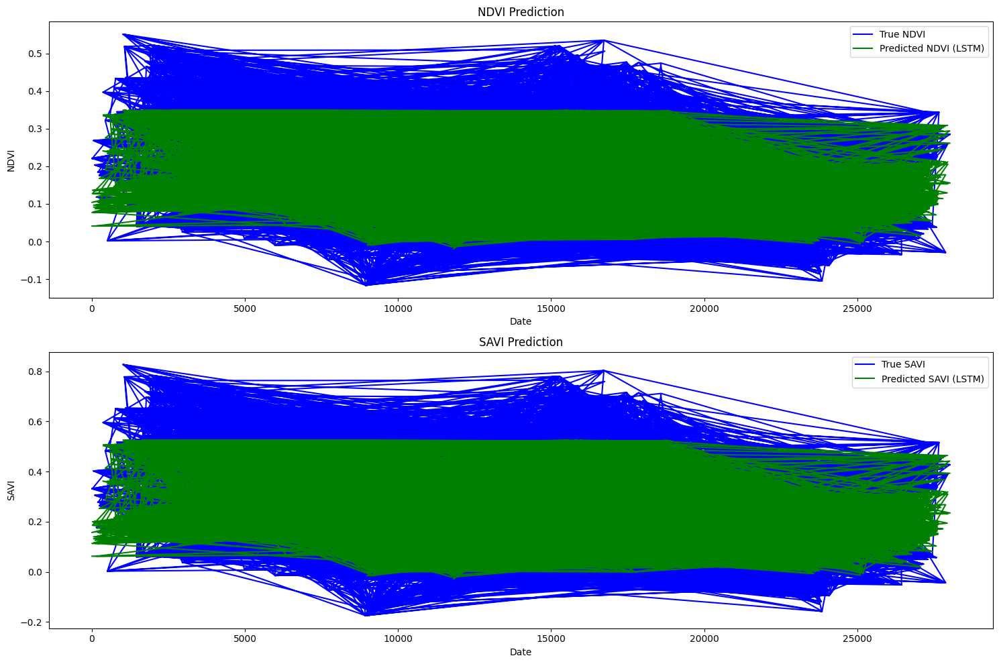

In [120]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
import matplotlib.pyplot as plt

# Check the contents of indices_df
print("Contents of indices_df:")
print(indices_df.head())
print("Shape of indices_df:", indices_df.shape)

# Check the contents of data_df
print("Contents of data_df:")
print(data_df.head())
print("Shape of data_df:", data_df.shape)

# Ensure there are common dates
common_dates = set(indices_df['Date']).intersection(set(data_df['Date']))
print("Number of common dates:", len(common_dates))

if len(common_dates) == 0:
    raise ValueError("There are no common dates between indices_df and data_df. Please check the data collection steps.")

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check the contents of combined_df after merging
print("Contents of combined_df after merging:")
print(combined_df.head())
print("Shape of combined_df after merging:", combined_df.shape)

# Fill NaN values in the Backscatter column with the mean of the column
combined_df['Backscatter'].fillna(combined_df['Backscatter'].mean(), inplace=True)

# Drop rows with remaining NaN values (if any)
combined_df = combined_df.dropna()
print("Contents of combined_df after filling NaN and dropping remaining NA:")
print(combined_df.head())
print("Shape of combined_df after processing NA:", combined_df.shape)

# Prepare the data
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for LSTM [samples, time steps, features]
X_train_lstm = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_lstm = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build the LSTM model
def build_lstm():
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(1, X_train_scaled.shape[1])))
    model.add(LSTM(50))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm()
lstm_model.fit(X_train_lstm, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Plotting the results
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.plot(y_test.index, y_test['NDVI'], label='True NDVI', color='blue')
plt.plot(y_test.index, lstm_predictions[:, 0], label='Predicted NDVI (LSTM)', color='green')
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.plot(y_test.index, y_test['SAVI'], label='True SAVI', color='blue')
plt.plot(y_test.index, lstm_predictions[:, 1], label='Predicted SAVI (LSTM)', color='green')
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


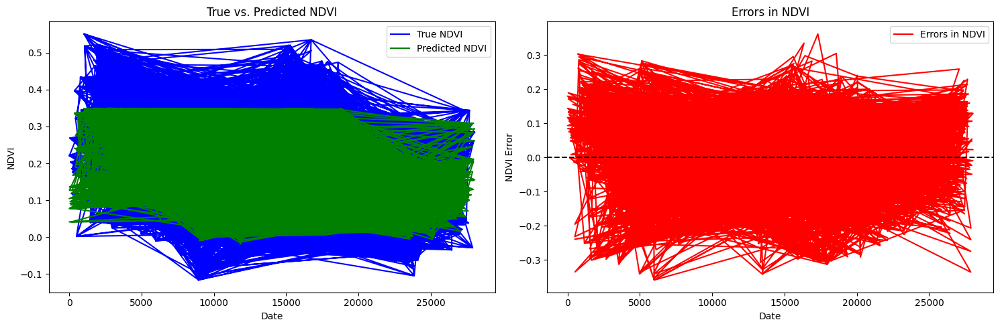

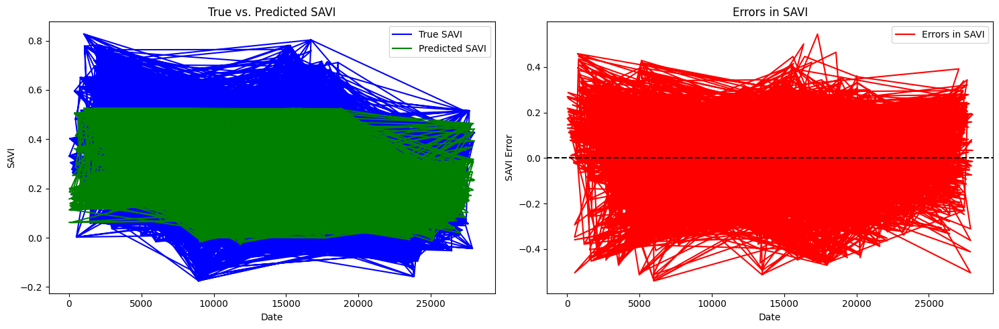

In [121]:
# Import necessary libraries
import matplotlib.pyplot as plt

# Function to plot true vs. predicted values and errors
def plot_predictions(true_values, predicted_values, label, title):
    plt.figure(figsize=(15, 5))

    # Plot true vs. predicted values
    plt.subplot(1, 2, 1)
    plt.plot(true_values.index, true_values, label=f'True {label}', color='blue')
    plt.plot(true_values.index, predicted_values, label=f'Predicted {label}', color='green')
    plt.legend()
    plt.title(f'True vs. Predicted {label}')
    plt.xlabel('Date')
    plt.ylabel(label)

    # Plot errors
    errors = true_values - predicted_values
    plt.subplot(1, 2, 2)
    plt.plot(true_values.index, errors, label=f'Errors in {label}', color='red')
    plt.axhline(y=0, color='black', linestyle='--')
    plt.legend()
    plt.title(f'Errors in {label}')
    plt.xlabel('Date')
    plt.ylabel(f'{label} Error')

    plt.tight_layout()
    plt.show()

# Plotting NDVI predictions
plot_predictions(y_test['NDVI'], lstm_predictions[:, 0], 'NDVI', 'NDVI Prediction')

# Plotting SAVI predictions
plot_predictions(y_test['SAVI'], lstm_predictions[:, 1], 'SAVI', 'SAVI Prediction')


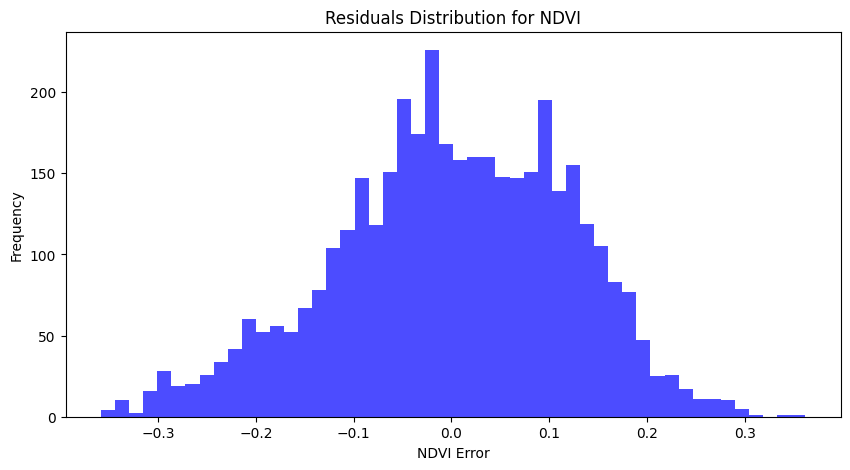

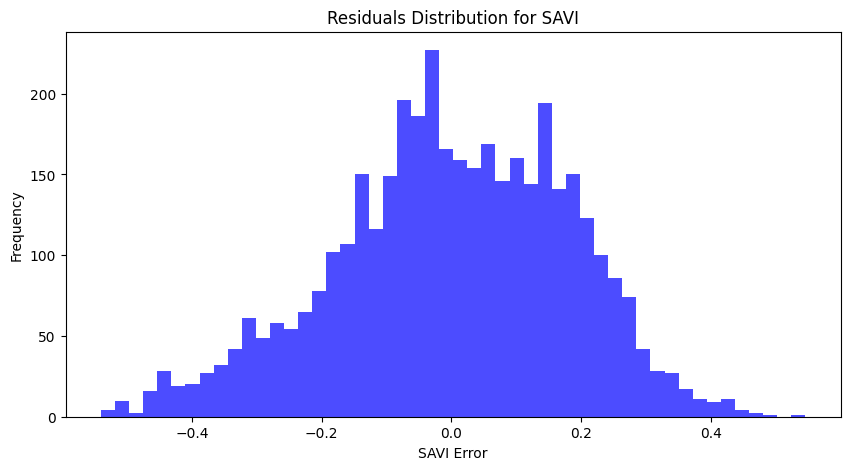

In [122]:
# Function to plot residuals distribution
def plot_residuals_distribution(true_values, predicted_values, label):
    errors = true_values - predicted_values

    plt.figure(figsize=(10, 5))
    plt.hist(errors, bins=50, color='blue', alpha=0.7)
    plt.title(f'Residuals Distribution for {label}')
    plt.xlabel(f'{label} Error')
    plt.ylabel('Frequency')
    plt.show()

# Plotting NDVI residuals distribution
plot_residuals_distribution(y_test['NDVI'], lstm_predictions[:, 0], 'NDVI')

# Plotting SAVI residuals distribution
plot_residuals_distribution(y_test['SAVI'], lstm_predictions[:, 1], 'SAVI')


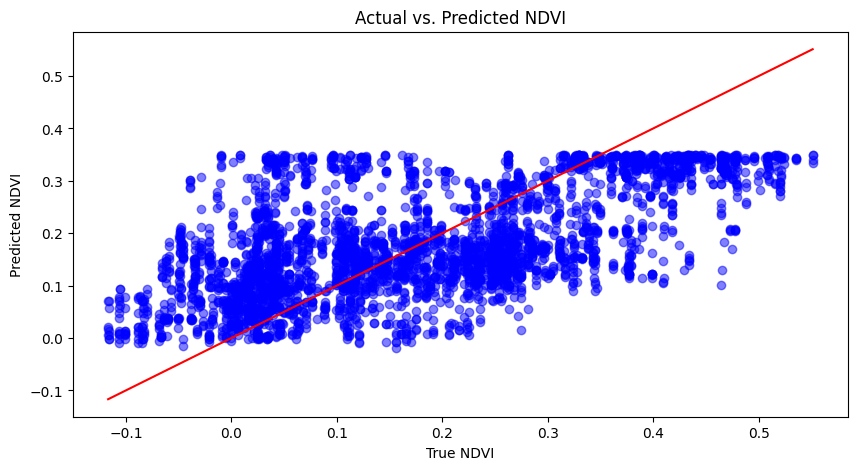

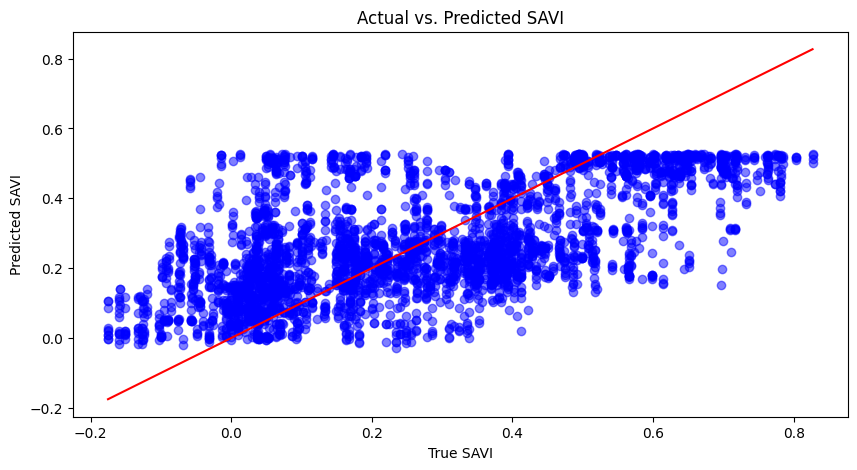

In [123]:
# Function to plot actual vs. predicted scatter plot
def plot_scatter(true_values, predicted_values, label):
    plt.figure(figsize=(10, 5))
    plt.scatter(true_values, predicted_values, alpha=0.5, color='blue')
    plt.plot([true_values.min(), true_values.max()], [true_values.min(), true_values.max()], color='red')
    plt.title(f'Actual vs. Predicted {label}')
    plt.xlabel(f'True {label}')
    plt.ylabel(f'Predicted {label}')
    plt.show()

# Plotting scatter plot for NDVI
plot_scatter(y_test['NDVI'], lstm_predictions[:, 0], 'NDVI')

# Plotting scatter plot for SAVI
plot_scatter(y_test['SAVI'], lstm_predictions[:, 1], 'SAVI')


Epoch 1/20
490/490 [==============================] - 5s 3ms/step - loss: 0.0294
Epoch 2/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0253
Epoch 3/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0245
Epoch 4/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0241
Epoch 5/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0237
Epoch 6/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0236
Epoch 7/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0235
Epoch 8/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0235
Epoch 9/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0234
Epoch 10/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0234
Epoch 11/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0234
Epoch 12/20
490/490 [==============================] - 2s 3ms/step - loss: 0.0233
Epoch 13/20
490/490 [====

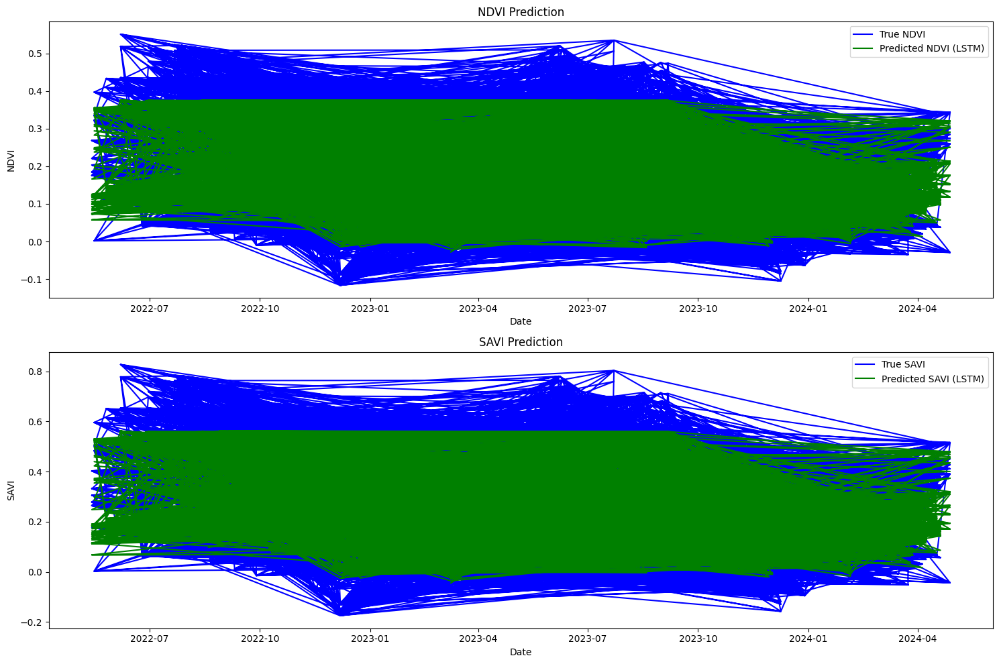

In [124]:
import matplotlib.pyplot as plt

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Split the data again to ensure alignment with dates
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for LSTM [samples, time steps, features]
X_train_lstm = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_lstm = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build the LSTM model
def build_lstm():
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(1, X_train_scaled.shape[1])))
    model.add(LSTM(50))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm()
lstm_model.fit(X_train_lstm, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Plotting the results with correct dates
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.plot(y_test.index, y_test['NDVI'], label='True NDVI', color='blue')
plt.plot(y_test.index, lstm_predictions[:, 0], label='Predicted NDVI (LSTM)', color='green')
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.plot(y_test.index, y_test['SAVI'], label='True SAVI', color='blue')
plt.plot(y_test.index, lstm_predictions[:, 1], label='Predicted SAVI (LSTM)', color='green')
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Shape of indices_df: (2622, 6)
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Shape of data_df: (17520, 3)
Number of common dates: 279
Contents of combined_df after merging:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561 

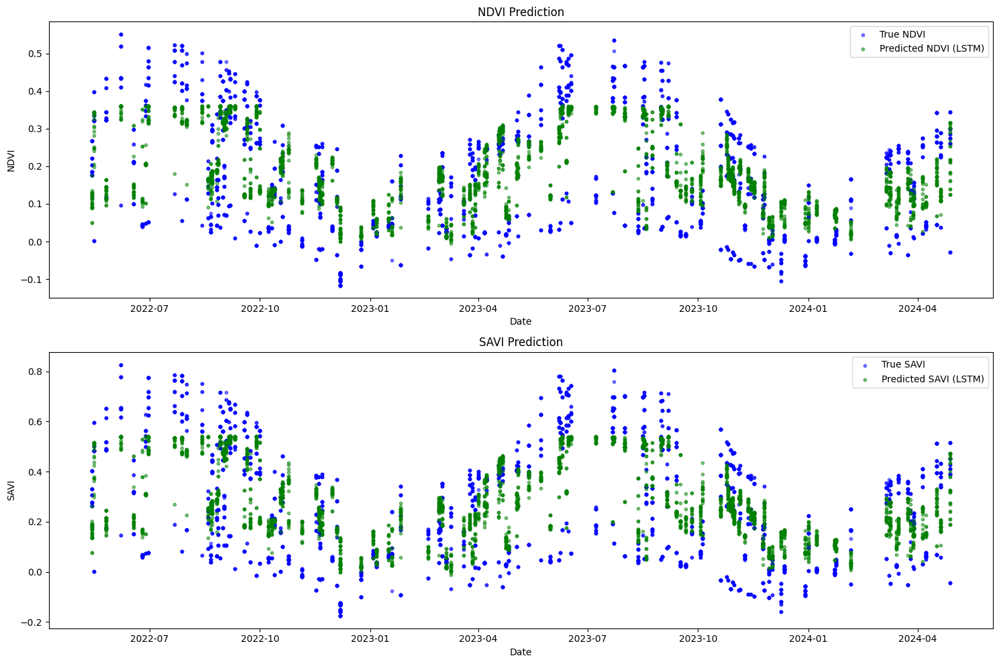

In [36]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
import matplotlib.pyplot as plt

# Check the contents of indices_df
print("Contents of indices_df:")
print(indices_df.head())
print("Shape of indices_df:", indices_df.shape)

# Check the contents of data_df
print("Contents of data_df:")
print(data_df.head())
print("Shape of data_df:", data_df.shape)

# Ensure there are common dates
common_dates = set(indices_df['Date']).intersection(set(data_df['Date']))
print("Number of common dates:", len(common_dates))

if len(common_dates) == 0:
    raise ValueError("There are no common dates between indices_df and data_df. Please check the data collection steps.")

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check the contents of combined_df after merging
print("Contents of combined_df after merging:")
print(combined_df.head())
print("Shape of combined_df after merging:", combined_df.shape)

# Fill NaN values in the Backscatter column with the mean of the column
combined_df['Backscatter'].fillna(combined_df['Backscatter'].mean(), inplace=True)

# Drop rows with remaining NaN values (if any)
combined_df = combined_df.dropna()
print("Contents of combined_df after filling NaN and dropping remaining NA:")
print(combined_df.head())
print("Shape of combined_df after processing NA:", combined_df.shape)

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Split the data again to ensure alignment with dates
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for LSTM [samples, time steps, features]
X_train_lstm = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_lstm = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build the LSTM model
def build_lstm():
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(1, X_train_scaled.shape[1])))
    model.add(LSTM(50))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm()
lstm_model.fit(X_train_lstm, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, lstm_predictions[:, 0], label='Predicted NDVI (LSTM)', color='green', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, lstm_predictions[:, 1], label='Predicted SAVI (LSTM)', color='green', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Shape of indices_df: (2622, 6)
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Shape of data_df: (17520, 3)
Number of common dates: 279
Contents of combined_df after merging:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561 

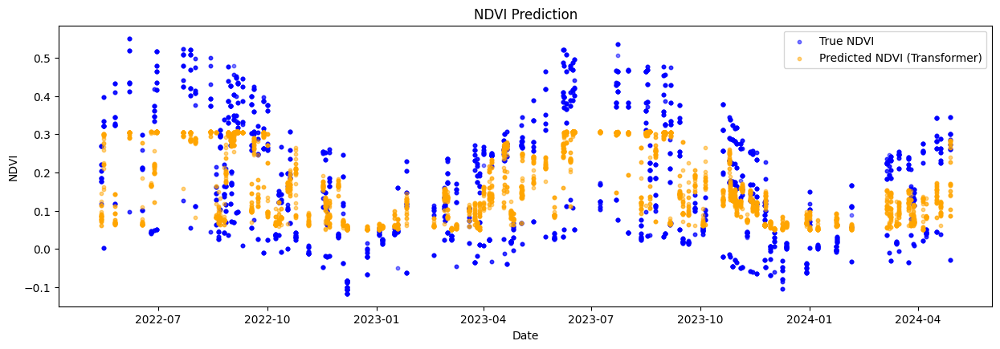

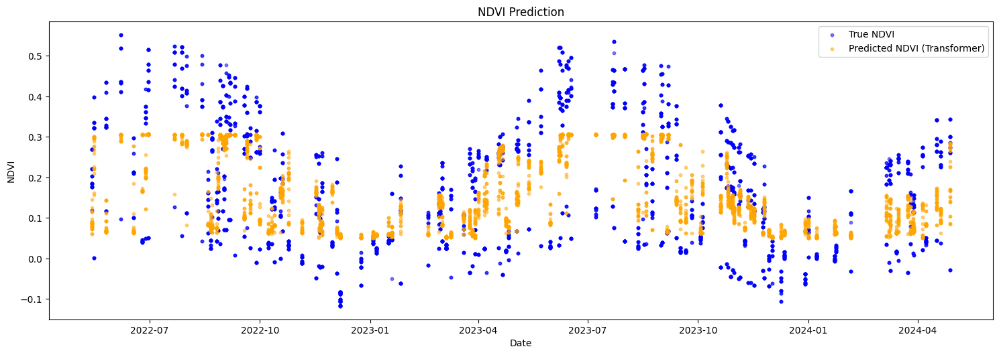

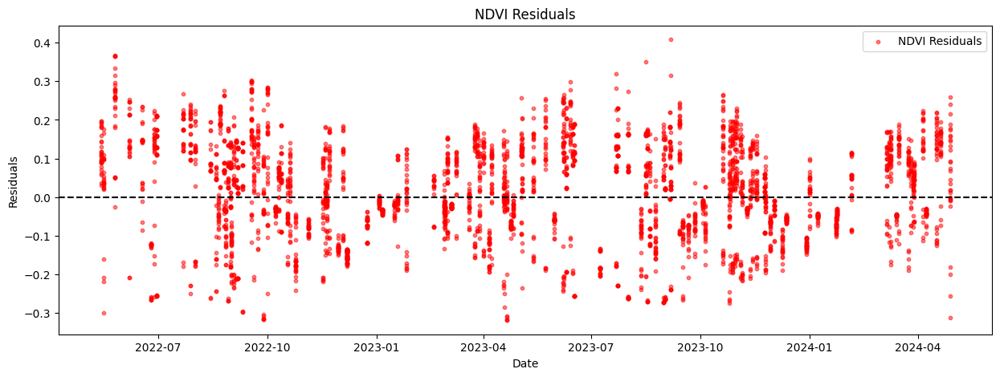

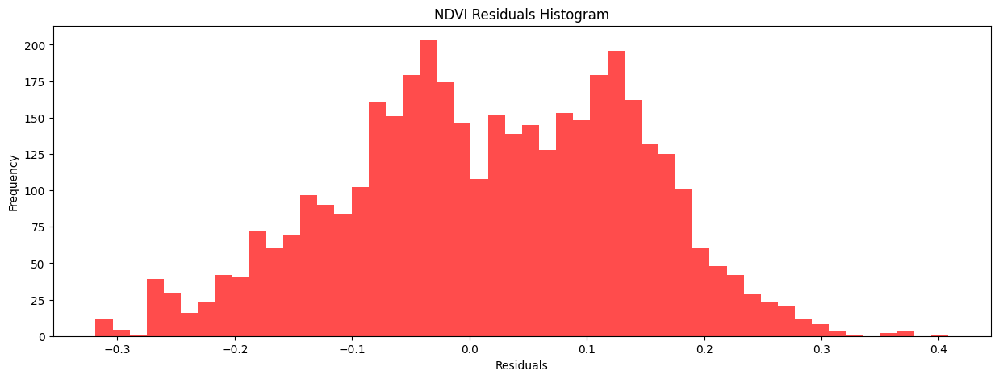

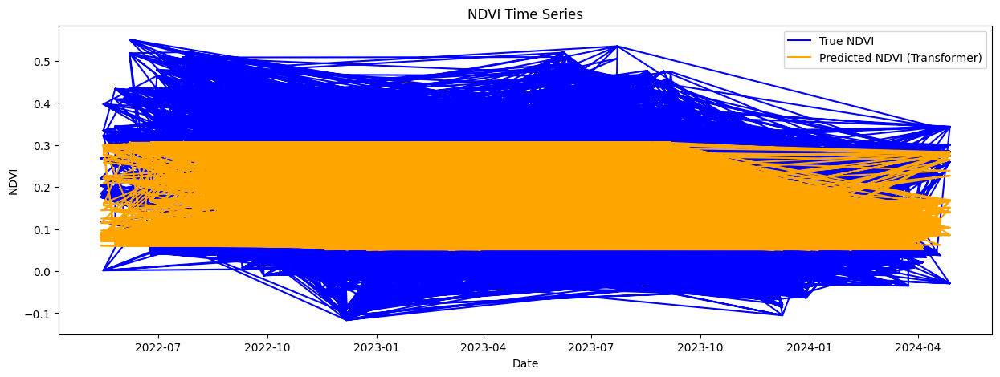

In [38]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Dropout, LayerNormalization, MultiHeadAttention, Flatten
import matplotlib.pyplot as plt

# Check the contents of indices_df
print("Contents of indices_df:")
print(indices_df.head())
print("Shape of indices_df:", indices_df.shape)

# Check the contents of data_df
print("Contents of data_df:")
print(data_df.head())
print("Shape of data_df:", data_df.shape)

# Ensure there are common dates
common_dates = set(indices_df['Date']).intersection(set(data_df['Date']))
print("Number of common dates:", len(common_dates))

if len(common_dates) == 0:
    raise ValueError("There are no common dates between indices_df and data_df. Please check the data collection steps.")

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check the contents of combined_df after merging
print("Contents of combined_df after merging:")
print(combined_df.head())
print("Shape of combined_df after merging:", combined_df.shape)

# Fill NaN values in the Backscatter column with the mean of the column
combined_df['Backscatter'].fillna(combined_df['Backscatter'].mean(), inplace=True)

# Drop rows with remaining NaN values (if any)
combined_df = combined_df.dropna()
print("Contents of combined_df after filling NaN and dropping remaining NA:")
print(combined_df.head())
print("Shape of combined_df after processing NA:", combined_df.shape)

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Split the data into features and targets
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for Transformer model [samples, time steps, features]
X_train_transformer = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_transformer = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Define the Transformer model
def build_transformer_model(input_shape):
    inputs = Input(shape=input_shape)
    
    # Multi-head attention layer
    attention = MultiHeadAttention(num_heads=4, key_dim=input_shape[1])(inputs, inputs)
    attention = Dropout(0.1)(attention)
    attention = LayerNormalization(epsilon=1e-6)(attention)
    
    # Feed forward layer
    outputs = Flatten()(attention)
    outputs = Dense(64, activation='relu')(outputs)
    outputs = Dropout(0.1)(outputs)
    outputs = LayerNormalization(epsilon=1e-6)(outputs)
    outputs = Dense(1)(outputs)
    
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    return model

# Build and compile the Transformer model
transformer_model = build_transformer_model((1, X_train_scaled.shape[1]))

# Print model summary
transformer_model.summary()

# Train the Transformer model
transformer_model.fit(X_train_transformer, y_train['NDVI'], epochs=20, batch_size=32, verbose=1)

# Predict using Transformer
transformer_predictions = transformer_model.predict(X_test_transformer)

# Reshape the predictions to match the shape of y_test
transformer_predictions = transformer_predictions.flatten()

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], transformer_predictions))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions, label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions, label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

plt.tight_layout()
plt.show()

# Residuals plot
residuals_ndvi = y_test['NDVI'] - transformer_predictions

plt.figure(figsize=(15, 5))
plt.scatter(y_test.index, residuals_ndvi, label='NDVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('NDVI Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')
plt.show()

# Histogram of the residuals
plt.figure(figsize=(15, 5))
plt.hist(residuals_ndvi, bins=50, color='red', alpha=0.7)
plt.title('NDVI Residuals Histogram')
plt.xlabel('Residuals')
plt.ylabel('Frequency')
plt.show()

# Time series plot
plt.figure(figsize=(15, 5))
plt.plot(y_test.index, y_test['NDVI'], label='True NDVI', color='blue')
plt.plot(y_test.index, transformer_predictions, label='Predicted NDVI (Transformer)', color='orange')
plt.legend()
plt.title('NDVI Time Series')
plt.xlabel('Date')
plt.ylabel('NDVI')
plt.show()


Epoch 1/100
196/196 [==============================] - 9s 11ms/step - loss: 0.2288 - val_loss: 0.0766
Epoch 2/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0492 - val_loss: 0.0368
Epoch 3/100
196/196 [==============================] - 1s 8ms/step - loss: 0.0355 - val_loss: 0.0340
Epoch 4/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0334 - val_loss: 0.0330
Epoch 5/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0336 - val_loss: 0.0342
Epoch 6/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0338 - val_loss: 0.0335
Epoch 7/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0338 - val_loss: 0.0336
Epoch 8/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0341 - val_loss: 0.0343
Epoch 9/100
196/196 [==============================] - 1s 7ms/step - loss: 0.0348 - val_loss: 0.0346
Epoch 10/100
196/196 [==============================] - 1s 8ms/step - loss: 0.0333 - val_l

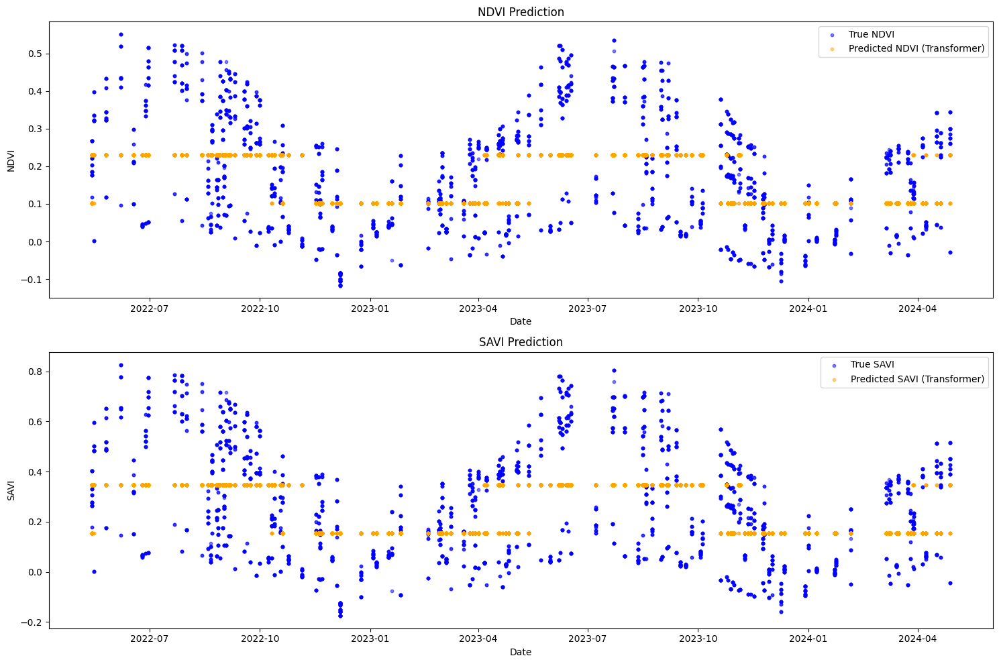

In [41]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, Flatten, LayerNormalization, MultiHeadAttention, Dropout, Add
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt

# Custom transformer block with increased complexity
class TransformerBlock(tf.keras.layers.Layer):
    def __init__(self, embed_dim, num_heads, ff_dim, rate=0.1):
        super(TransformerBlock, self).__init__()
        self.att = MultiHeadAttention(num_heads=num_heads, key_dim=embed_dim)
        self.ffn = tf.keras.Sequential([
            Dense(ff_dim, activation="relu"),
            Dense(embed_dim)
        ])
        self.layernorm1 = LayerNormalization(epsilon=1e-6)
        self.layernorm2 = LayerNormalization(epsilon=1e-6)
        self.dropout1 = Dropout(rate)
        self.dropout2 = Dropout(rate)

    def call(self, inputs, training):
        attn_output = self.att(inputs, inputs)
        attn_output = self.dropout1(attn_output, training=training)
        out1 = self.layernorm1(inputs + attn_output)
        ffn_output = self.ffn(out1)
        ffn_output = self.dropout2(ffn_output, training=training)
        return self.layernorm2(out1 + ffn_output)

# Build a more complex transformer model
def build_transformer_model(input_shape, num_heads=8, ff_dim=128, num_blocks=4, rate=0.1):
    inputs = Input(shape=input_shape)
    x = inputs
    for _ in range(num_blocks):
        x = TransformerBlock(embed_dim=input_shape[-1], num_heads=num_heads, ff_dim=ff_dim, rate=rate)(x)
    x = Flatten()(x)
    outputs = Dense(2)(x)
    model = Model(inputs=inputs, outputs=outputs)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')
    return model

# Load and preprocess the data
# Assuming combined_df is already created as shown in your previous code

# Feature selection and target definition
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape for Transformer [samples, time steps, features]
X_train_transformer = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_transformer = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build and train the enhanced Transformer model
transformer_model = build_transformer_model(input_shape=(1, X_train_scaled.shape[1]))
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

transformer_model.fit(X_train_transformer, y_train, epochs=100, batch_size=64, validation_split=0.2, callbacks=[early_stopping], verbose=1)

# Predict using Transformer
transformer_predictions = transformer_model.predict(X_test_transformer)

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], transformer_predictions[:, 0]))
transformer_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], transformer_predictions[:, 1]))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}, SAVI RMSE: {transformer_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 0], label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 1], label='Predicted SAVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Shape of indices_df: (2622, 6)
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Shape of data_df: (17520, 3)
Number of common dates: 279
Contents of combined_df after merging:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561 

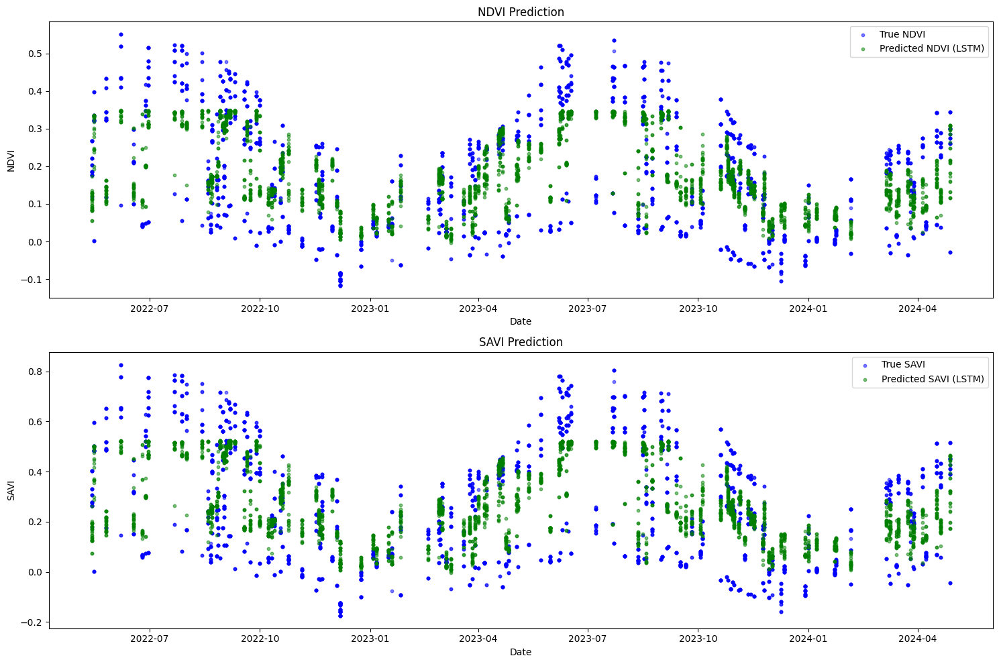

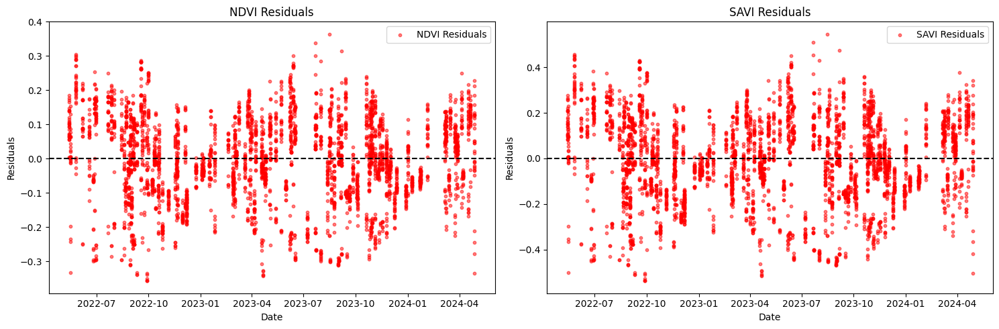

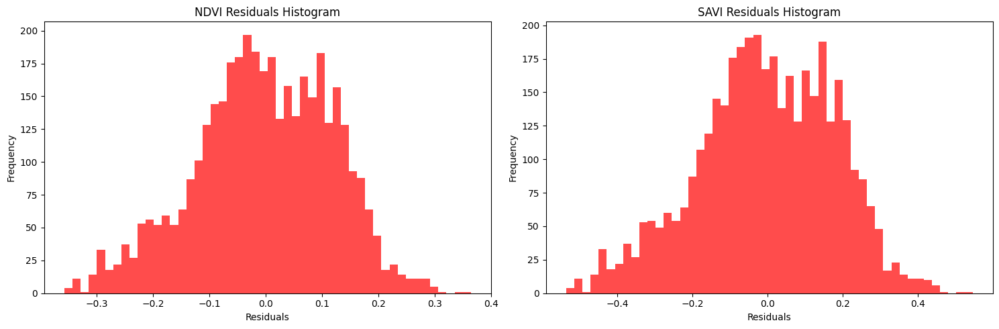

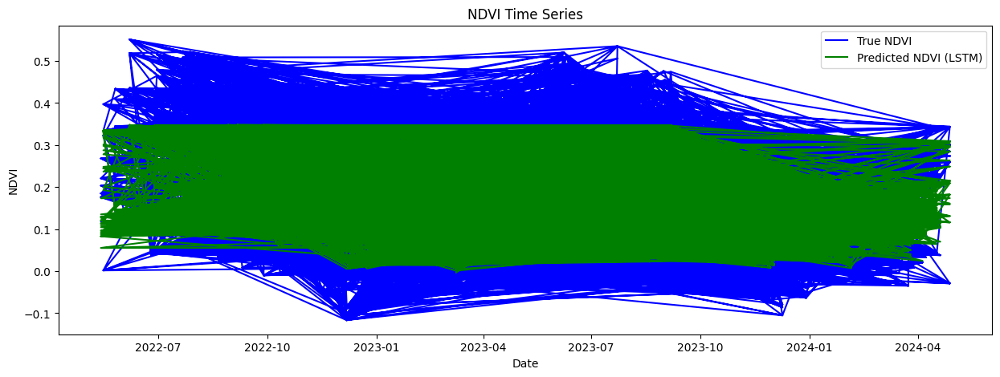

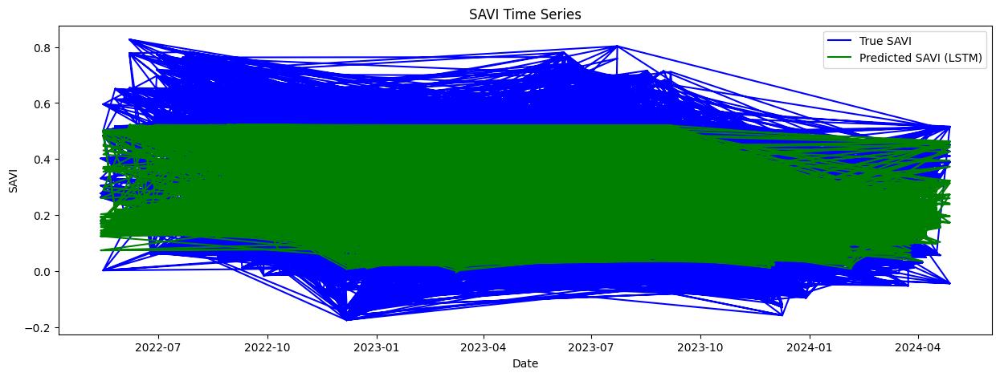

In [35]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM
import matplotlib.pyplot as plt

# Check the contents of indices_df
print("Contents of indices_df:")
print(indices_df.head())
print("Shape of indices_df:", indices_df.shape)

# Check the contents of data_df
print("Contents of data_df:")
print(data_df.head())
print("Shape of data_df:", data_df.shape)

# Ensure there are common dates
common_dates = set(indices_df['Date']).intersection(set(data_df['Date']))
print("Number of common dates:", len(common_dates))

if len(common_dates) == 0:
    raise ValueError("There are no common dates between indices_df and data_df. Please check the data collection steps.")

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check the contents of combined_df after merging
print("Contents of combined_df after merging:")
print(combined_df.head())
print("Shape of combined_df after merging:", combined_df.shape)

# Fill NaN values in the Backscatter column with the mean of the column
combined_df['Backscatter'].fillna(combined_df['Backscatter'].mean(), inplace=True)

# Drop rows with remaining NaN values (if any)
combined_df = combined_df.dropna()
print("Contents of combined_df after filling NaN and dropping remaining NA:")
print(combined_df.head())
print("Shape of combined_df after processing NA:", combined_df.shape)

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Split the data again to ensure alignment with dates
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for LSTM [samples, time steps, features]
X_train_lstm = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_lstm = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build the LSTM model
def build_lstm():
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(1, X_train_scaled.shape[1])))
    model.add(LSTM(50))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm()
lstm_model.fit(X_train_lstm, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, lstm_predictions[:, 0], label='Predicted NDVI (LSTM)', color='green', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, lstm_predictions[:, 1], label='Predicted SAVI (LSTM)', color='green', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()

# Residuals plot
residuals_ndvi = y_test['NDVI'] - lstm_predictions[:, 0]
residuals_savi = y_test['SAVI'] - lstm_predictions[:, 1]

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.scatter(y_test.index, residuals_ndvi, label='NDVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('NDVI Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')

plt.subplot(1, 2, 2)
plt.scatter(y_test.index, residuals_savi, label='SAVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('SAVI Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')

plt.tight_layout()
plt.show()

# Histogram of the residuals
plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.hist(residuals_ndvi, bins=50, color='red', alpha=0.7)
plt.title('NDVI Residuals Histogram')
plt.xlabel('Residuals')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(residuals_savi, bins=50, color='red', alpha=0.7)
plt.title('SAVI Residuals Histogram')
plt.xlabel('Residuals')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Time series plot
plt.figure(figsize=(15, 5))
plt.plot(y_test.index, y_test['NDVI'], label='True NDVI', color='blue')
plt.plot(y_test.index, lstm_predictions[:, 0], label='Predicted NDVI (LSTM)', color='green')
plt.legend()
plt.title('NDVI Time Series')
plt.xlabel('Date')
plt.ylabel('NDVI')
plt.show()

plt.figure(figsize=(15, 5))
plt.plot(y_test.index, y_test['SAVI'], label='True SAVI', color='blue')
plt.plot(y_test.index, lstm_predictions[:, 1], label='Predicted SAVI (LSTM)', color='green')
plt.legend()
plt.title('SAVI Time Series')
plt.xlabel('Date')
plt.ylabel('SAVI')
plt.show()


##LSTM

Epoch 1/100
392/392 [==============================] - 7s 9ms/step - loss: 0.0299 - val_loss: 0.0261
Epoch 2/100
392/392 [==============================] - 2s 6ms/step - loss: 0.0264 - val_loss: 0.0252
Epoch 3/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0255 - val_loss: 0.0244
Epoch 4/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0250 - val_loss: 0.0243
Epoch 5/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0246 - val_loss: 0.0237
Epoch 6/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0245 - val_loss: 0.0234
Epoch 7/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0242 - val_loss: 0.0238
Epoch 8/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0242 - val_loss: 0.0231
Epoch 9/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0241 - val_loss: 0.0234
Epoch 10/100
392/392 [==============================] - 2s 5ms/step - loss: 0.0239 - val_lo

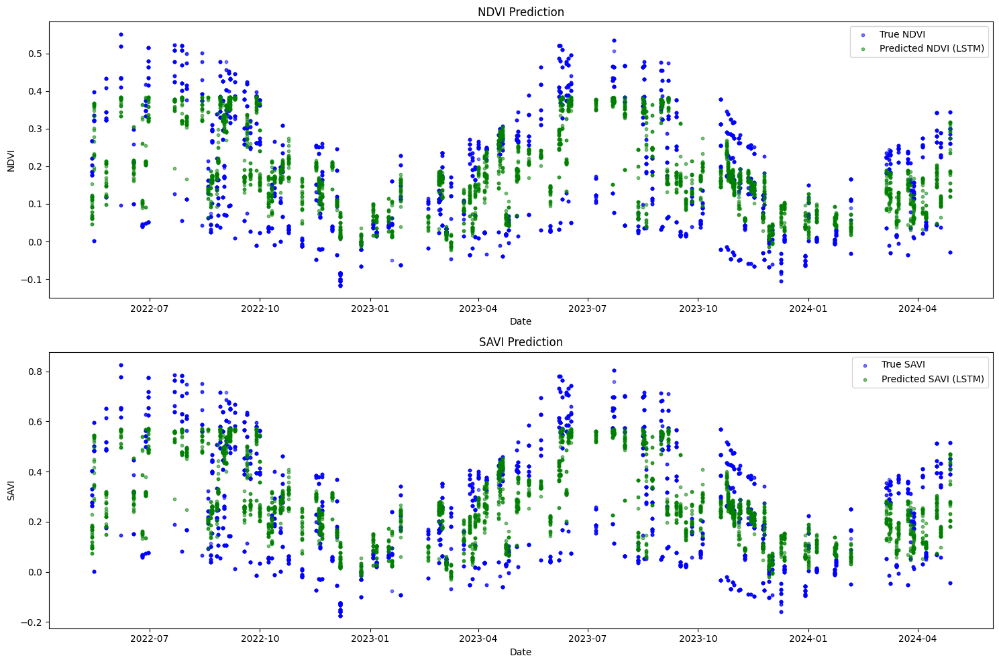

In [42]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Dropout
import matplotlib.pyplot as plt

# Load and preprocess data
# Assuming combined_df is already created as shown in your previous code

# Feature selection and target definition
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape for LSTM [samples, time steps, features]
X_train_lstm = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_lstm = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build and train the enhanced LSTM model
def build_lstm():
    model = Sequential()
    model.add(LSTM(100, return_sequences=True, input_shape=(1, X_train_scaled.shape[1])))
    model.add(Dropout(0.2))
    model.add(LSTM(100))
    model.add(Dropout(0.2))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm()
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

lstm_model.fit(X_train_lstm, y_train, epochs=100, batch_size=32, validation_split=0.2, callbacks=[early_stopping], verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, lstm_predictions[:, 0], label='Predicted NDVI (LSTM)', color='green', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, lstm_predictions[:, 1], label='Predicted SAVI (LSTM)', color='green', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Epoch 1/50
392/392 [==============================] - 3s 4ms/step - loss: 0.0446 - val_loss: 0.0238
Epoch 2/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0259 - val_loss: 0.0228
Epoch 3/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0246 - val_loss: 0.0229
Epoch 4/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0240 - val_loss: 0.0232
Epoch 5/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0239 - val_loss: 0.0223
Epoch 6/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0236 - val_loss: 0.0234
Epoch 7/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0237 - val_loss: 0.0224
Epoch 8/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0234 - val_loss: 0.0223
Epoch 9/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0234 - val_loss: 0.0222
Epoch 10/50
392/392 [==============================] - 1s 3ms/step - loss: 0.0232 - val_loss: 0.0224

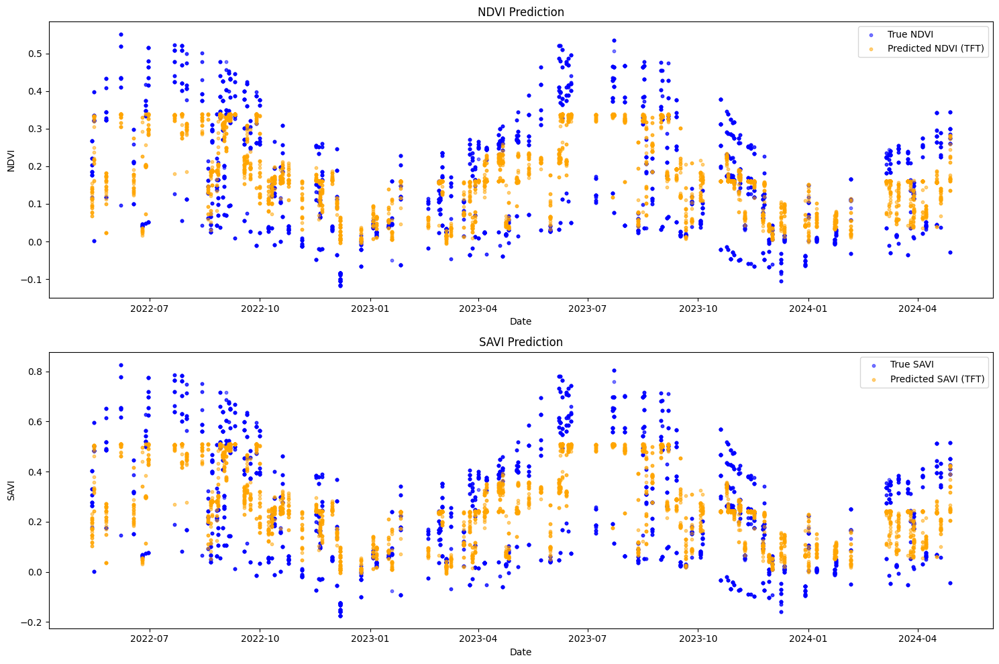

In [51]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, LayerNormalization, MultiHeadAttention, Dropout, Layer, Conv1D, Flatten, Add
import matplotlib.pyplot as plt

# Load and preprocess data
# Assuming combined_df is already created as shown in your previous code

# Feature selection and target definition
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape for TFT [samples, time steps, features]
X_train_tft = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_tft = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Define custom attention layer
class AddAndNorm(Layer):
    def __init__(self, **kwargs):
        super(AddAndNorm, self).__init__(**kwargs)
        self.norm = LayerNormalization()

    def call(self, inputs, sublayer):
        return self.norm(Add()([inputs, sublayer]))

# Build the TFT model
def build_tft():
    # Input layers
    inputs = Input(shape=(1, X_train_scaled.shape[1]))

    # Conv1D layer to capture spatial relationships
    x = Conv1D(filters=64, kernel_size=1, activation='relu')(inputs)

    # Multi-Head Attention
    attn_output = MultiHeadAttention(num_heads=4, key_dim=2)(x, x)
    attn_output = Dropout(0.1)(attn_output)
    x = AddAndNorm()(inputs=x, sublayer=attn_output)

    # Flatten layer
    x = Flatten()(x)

    # Fully connected layers
    x = Dense(100, activation='relu')(x)
    x = Dropout(0.1)(x)
    outputs = Dense(2)(x)  # Output should match the number of target variables (NDVI and SAVI)

    # Build and compile model
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

tft_model = build_tft()
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

tft_model.fit(X_train_tft, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping], verbose=1)

# Predict using TFT
tft_predictions = tft_model.predict(X_test_tft)

# Calculate RMSE for TFT
tft_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], tft_predictions[:, 0]))
tft_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], tft_predictions[:, 1]))
print(f"TFT - NDVI RMSE: {tft_rmse_ndvi}, SAVI RMSE: {tft_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, tft_predictions[:, 0], label='Predicted NDVI (TFT)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, tft_predictions[:, 1], label='Predicted SAVI (TFT)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, LayerNormalization, MultiHeadAttention, Dropout, Layer, Conv1D, Flatten, Add
import matplotlib.pyplot as plt

# Assuming combined_df is already created as shown in your previous code
# Separate the vegetation types
vegetation_types = combined_df['Shapefile'].unique()

# Function to build the TFT model
class AddAndNorm(Layer):
    def __init__(self, **kwargs):
        super(AddAndNorm, self).__init__(**kwargs)
        self.norm = LayerNormalization()

    def call(self, inputs, sublayer):
        return self.norm(Add()([inputs, sublayer]))

def build_tft():
    # Input layers
    inputs = Input(shape=(1, X_train_scaled.shape[1]))

    # Conv1D layer to capture spatial relationships
    x = Conv1D(filters=64, kernel_size=1, activation='relu')(inputs)

    # Multi-Head Attention
    attn_output = MultiHeadAttention(num_heads=4, key_dim=2)(x, x)
    attn_output = Dropout(0.1)(attn_output)
    x = AddAndNorm()(inputs=x, sublayer=attn_output)

    # Flatten layer
    x = Flatten()(x)

    # Fully connected layers
    x = Dense(100, activation='relu')(x)
    x = Dropout(0.1)(x)
    outputs = Dense(2)(x)  # Output should match the number of target variables (NDVI and SAVI)

    # Build and compile model
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

# Iterate over each vegetation type
for veg_type in vegetation_types:
    veg_data = combined_df[combined_df['Shapefile'] == veg_type]

    # Feature selection and target definition
    features = veg_data[['Backscatter', 'Temperature', 'Precipitation']]
    targets = veg_data[['NDVI', 'SAVI']]

    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

    # Standardize the data
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Reshape for TFT [samples, time steps, features]
    X_train_tft = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
    X_test_tft = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

    tft_model = build_tft()
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    tft_model.fit(X_train_tft, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping], verbose=1)

    # Predict using TFT
    tft_predictions = tft_model.predict(X_test_tft)

    # Calculate RMSE for TFT
    tft_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], tft_predictions[:, 0]))
    tft_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], tft_predictions[:, 1]))
    print(f"TFT for {veg_type} - NDVI RMSE: {tft_rmse_ndvi}, SAVI RMSE: {tft_rmse_savi}")

    # Plotting the results with scatter plots
    plt.figure(figsize=(15, 10))

    # Plot NDVI
    plt.subplot(2, 1, 1)
    plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
    plt.scatter(y_test.index, tft_predictions[:, 0], label='Predicted NDVI (TFT)', color='orange', alpha=0.5, s=10)
    plt.legend()
    plt.title(f'NDVI Prediction for {veg_type}')
    plt.xlabel('Date')
    plt.ylabel('NDVI')

    # Plot SAVI
    plt.subplot(2, 1, 2)
    plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
    plt.scatter(y_test.index, tft_predictions[:, 1], label='Predicted SAVI (TFT)', color='orange', alpha=0.5, s=10)
    plt.legend()
    plt.title(f'SAVI Prediction for {veg_type}')
    plt.xlabel('Date')
    plt.ylabel('SAVI')

    plt.tight_layout()
    plt.show()


In [53]:
pip install seaborn

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 23.3.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


   ---------------------------------------- 0.0/294.9 kB ? eta -:--:--
   -------------------------------------- - 286.7/294.9 kB 8.9 MB/s eta 0:00:01
   ---------------------------------------- 294.9/294.9 kB 6.1 MB/s eta 0:00:00


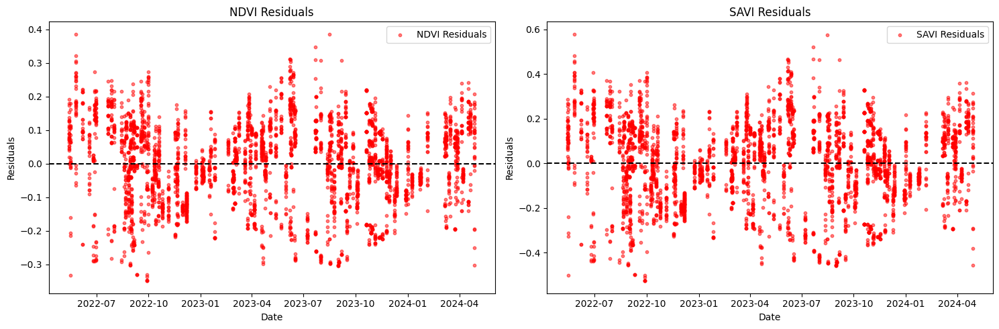

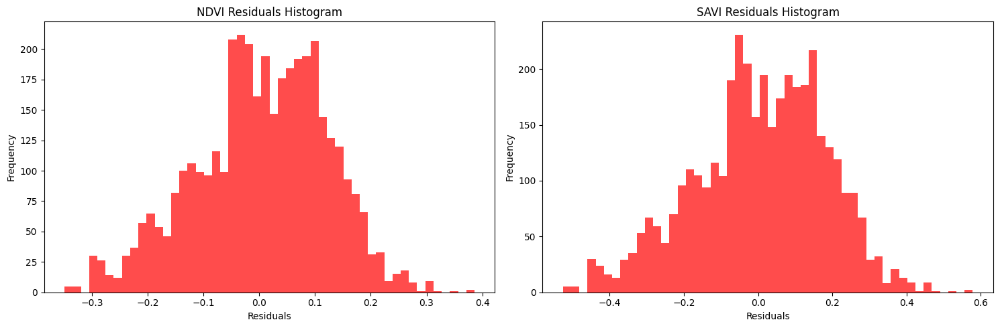

ValueError: could not convert string to float: 'AgriculturalLand.shp'

<Figure size 1000x800 with 0 Axes>

In [54]:
import matplotlib.pyplot as plt
import seaborn as sns

# Residuals plot
residuals_ndvi = y_test['NDVI'] - tft_predictions[:, 0]
residuals_savi = y_test['SAVI'] - tft_predictions[:, 1]

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.scatter(y_test.index, residuals_ndvi, label='NDVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('NDVI Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')

plt.subplot(1, 2, 2)
plt.scatter(y_test.index, residuals_savi, label='SAVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('SAVI Residuals')
plt.xlabel('Date')
plt.ylabel('Residuals')

plt.tight_layout()
plt.show()

# Histogram of residuals
plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.hist(residuals_ndvi, bins=50, color='red', alpha=0.7)
plt.title('NDVI Residuals Histogram')
plt.xlabel('Residuals')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(residuals_savi, bins=50, color='red', alpha=0.7)
plt.title('SAVI Residuals Histogram')
plt.xlabel('Residuals')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(combined_df.corr(), annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Feature Correlation Heatmap')
plt.show()


Contents of numeric_df:
                NDVI      SAVI       GCI  Backscatter  Temperature  \
Date                                                                 
2022-05-14  0.221057  0.331561  0.566053    -9.334405   280.030945   
2022-05-14  0.221057  0.331561  0.566053    -9.334405   279.794754   
2022-05-14  0.221057  0.331561  0.566053    -9.334405   279.825821   
2022-05-14  0.221057  0.331561  0.566053    -9.334405   279.827454   
2022-05-14  0.221057  0.331561  0.566053    -9.334405   279.769485   

            Precipitation  
Date                       
2022-05-14       0.028368  
2022-05-14       0.000307  
2022-05-14       0.000653  
2022-05-14       0.000946  
2022-05-14       0.001188  


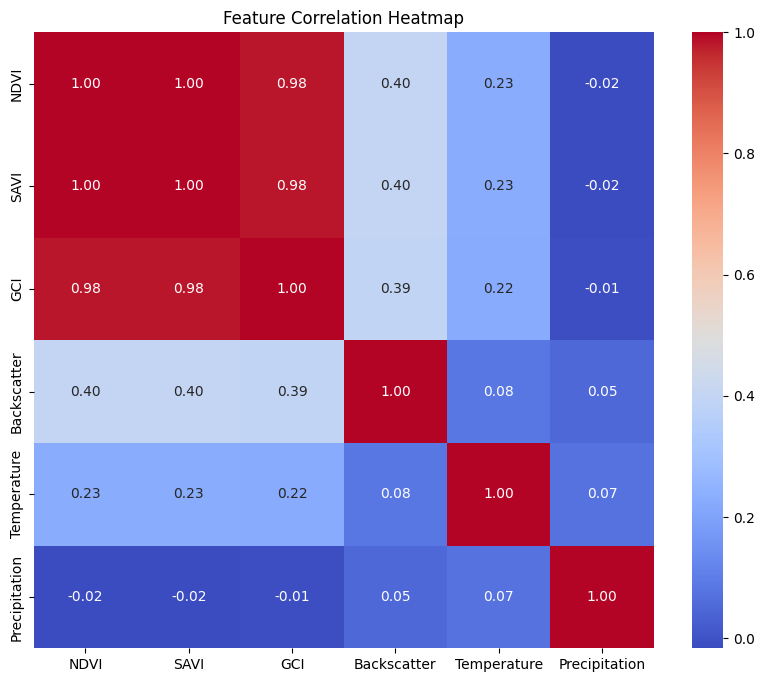

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming combined_df is already defined and contains the data

# Drop non-numeric columns for correlation heatmap
numeric_df = combined_df.select_dtypes(include=[np.number])

# Check the contents of the numeric DataFrame
print("Contents of numeric_df:")
print(numeric_df.head())

# Correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(numeric_df.corr(), annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Feature Correlation Heatmap')
plt.show()


Epoch 1/50
210/210 [==============================] - 1s 2ms/step - loss: 0.0502 - val_loss: 0.0138
Epoch 2/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0160 - val_loss: 0.0095
Epoch 3/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0125 - val_loss: 0.0088
Epoch 4/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0113 - val_loss: 0.0101
Epoch 5/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0106 - val_loss: 0.0086
Epoch 6/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.0093
Epoch 7/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0080
Epoch 8/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0094 - val_loss: 0.0086
Epoch 9/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0092 - val_loss: 0.0082
Epoch 10/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0091 - val_loss: 0.0078

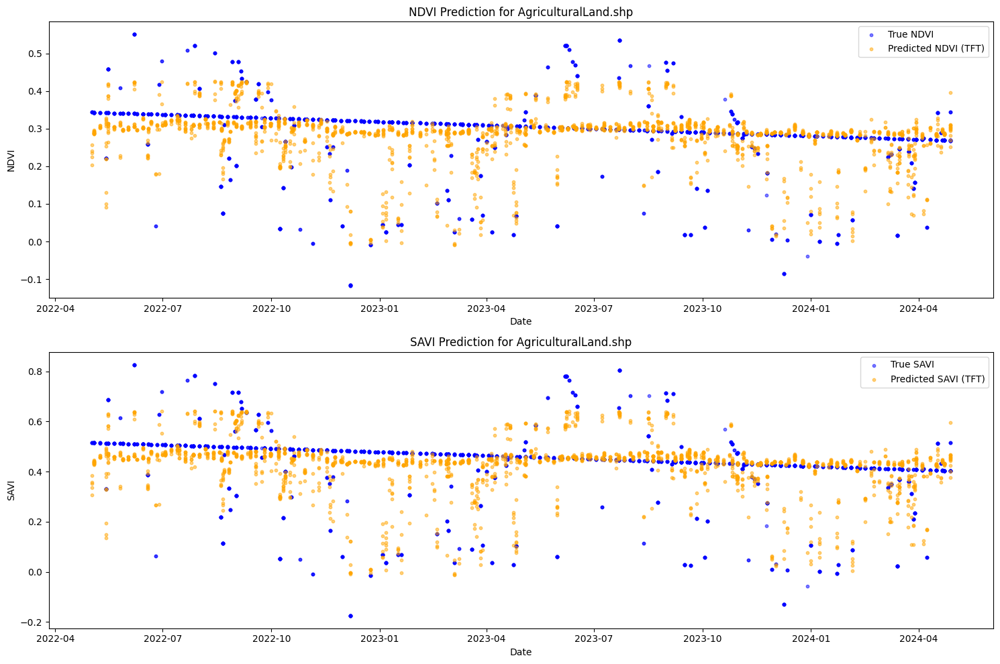

Epoch 1/50
210/210 [==============================] - 1s 2ms/step - loss: 0.0616 - val_loss: 0.0138
Epoch 2/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0165 - val_loss: 0.0108
Epoch 3/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0127 - val_loss: 0.0103
Epoch 4/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0117 - val_loss: 0.0101
Epoch 5/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0112 - val_loss: 0.0100
Epoch 6/50
210/210 [==============================] - 1s 5ms/step - loss: 0.0107 - val_loss: 0.0095
Epoch 7/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0107 - val_loss: 0.0093
Epoch 8/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0103 - val_loss: 0.0095
Epoch 9/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0102 - val_loss: 0.0093
Epoch 10/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0099 - val_loss: 0.0092

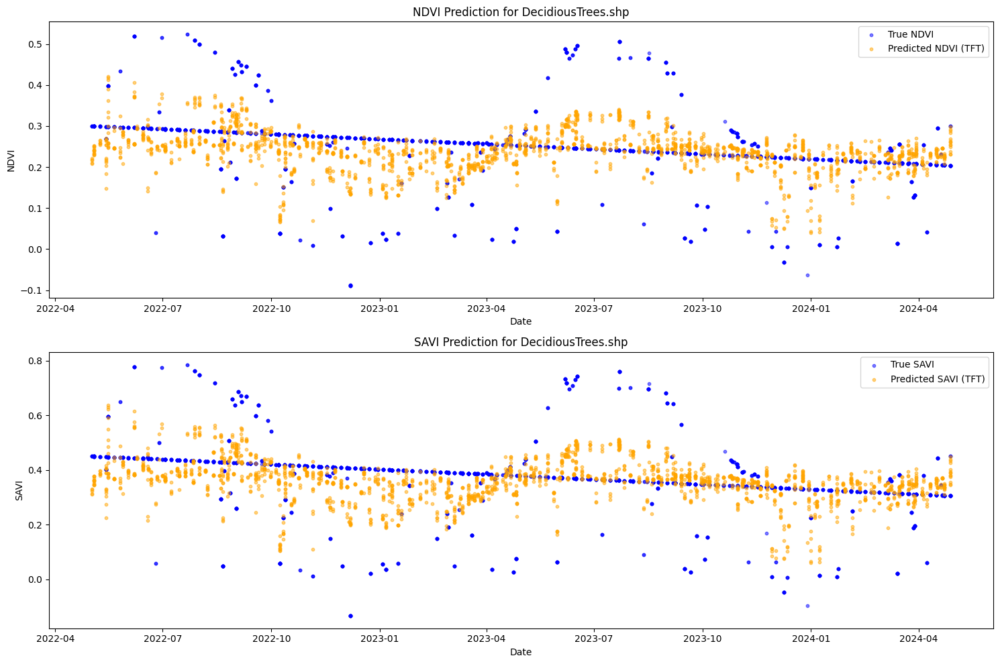

Epoch 1/50
210/210 [==============================] - 1s 2ms/step - loss: 0.0565 - val_loss: 0.0094
Epoch 2/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0139 - val_loss: 0.0077
Epoch 3/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0105 - val_loss: 0.0074
Epoch 4/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0090 - val_loss: 0.0070
Epoch 5/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0084 - val_loss: 0.0070
Epoch 6/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0081 - val_loss: 0.0066
Epoch 7/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0067
Epoch 8/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0067
Epoch 9/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0070
Epoch 10/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0075 - val_loss: 0.0063

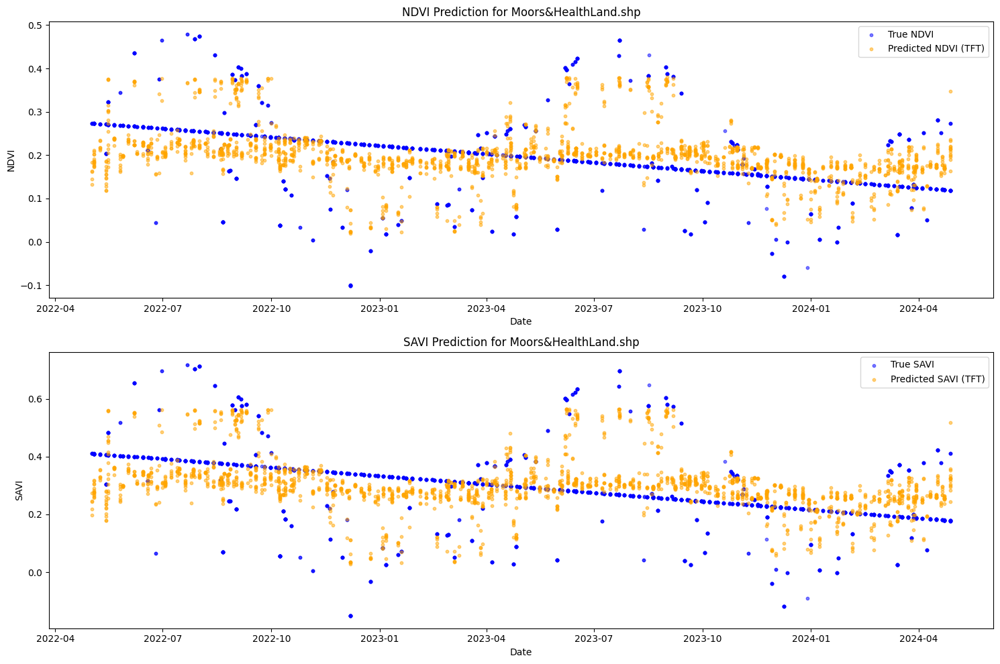

Epoch 1/50
210/210 [==============================] - 1s 2ms/step - loss: 0.0643 - val_loss: 0.0064
Epoch 2/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0095 - val_loss: 0.0050
Epoch 3/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0048
Epoch 4/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0054 - val_loss: 0.0048
Epoch 5/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0051 - val_loss: 0.0046
Epoch 6/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0049 - val_loss: 0.0045
Epoch 7/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0045
Epoch 8/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0043
Epoch 9/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0048 - val_loss: 0.0043
Epoch 10/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0047 - val_loss: 0.0043

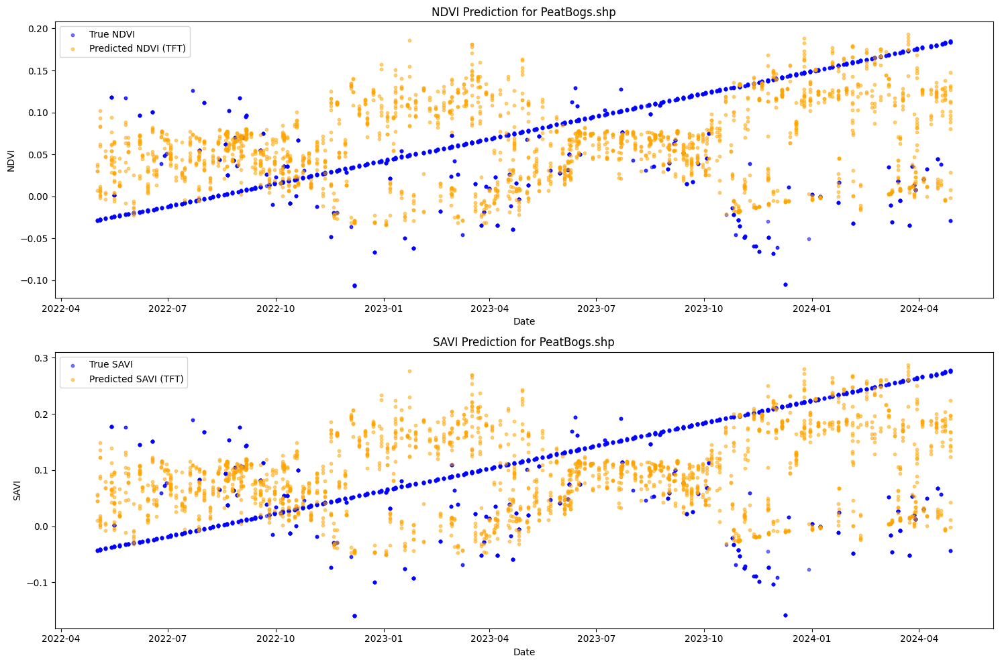

Epoch 1/50
210/210 [==============================] - 1s 2ms/step - loss: 0.0792 - val_loss: 0.0087
Epoch 2/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0148 - val_loss: 0.0076
Epoch 3/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0101 - val_loss: 0.0065
Epoch 4/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0083 - val_loss: 0.0064
Epoch 5/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0077 - val_loss: 0.0059
Epoch 6/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0072 - val_loss: 0.0056
Epoch 7/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0054
Epoch 8/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0064 - val_loss: 0.0059
Epoch 9/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0062 - val_loss: 0.0054
Epoch 10/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0061 - val_loss: 0.0058

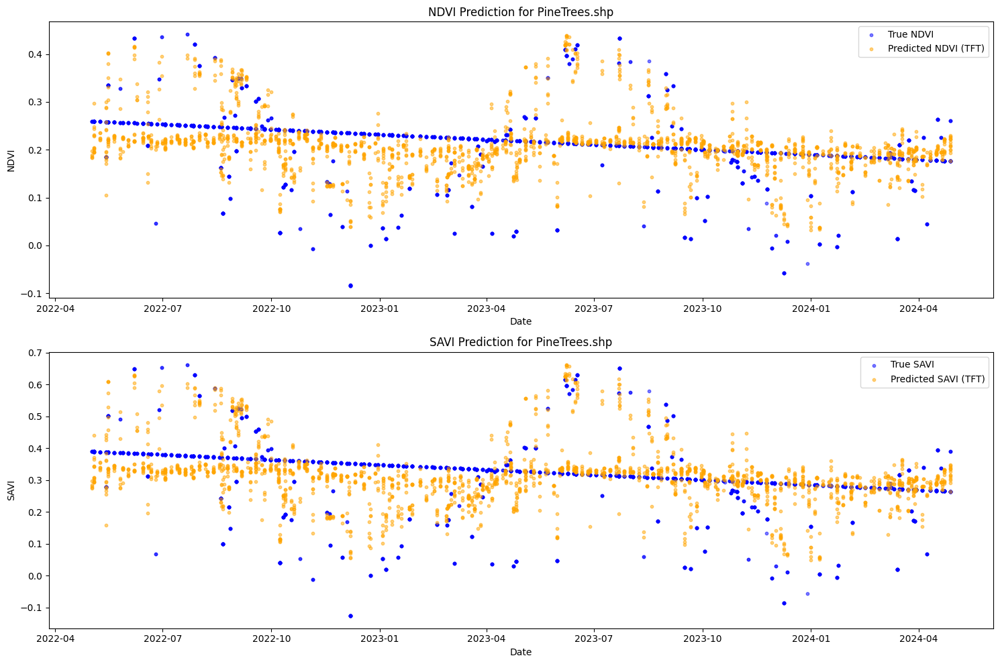

Epoch 1/50
210/210 [==============================] - 1s 2ms/step - loss: 0.0545 - val_loss: 0.0082
Epoch 2/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0134 - val_loss: 0.0073
Epoch 3/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0100 - val_loss: 0.0066
Epoch 4/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0087 - val_loss: 0.0064
Epoch 5/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0079 - val_loss: 0.0062
Epoch 6/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0076 - val_loss: 0.0061
Epoch 7/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0071 - val_loss: 0.0061
Epoch 8/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0068 - val_loss: 0.0059
Epoch 9/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0067 - val_loss: 0.0060
Epoch 10/50
210/210 [==============================] - 0s 2ms/step - loss: 0.0066 - val_loss: 0.0061

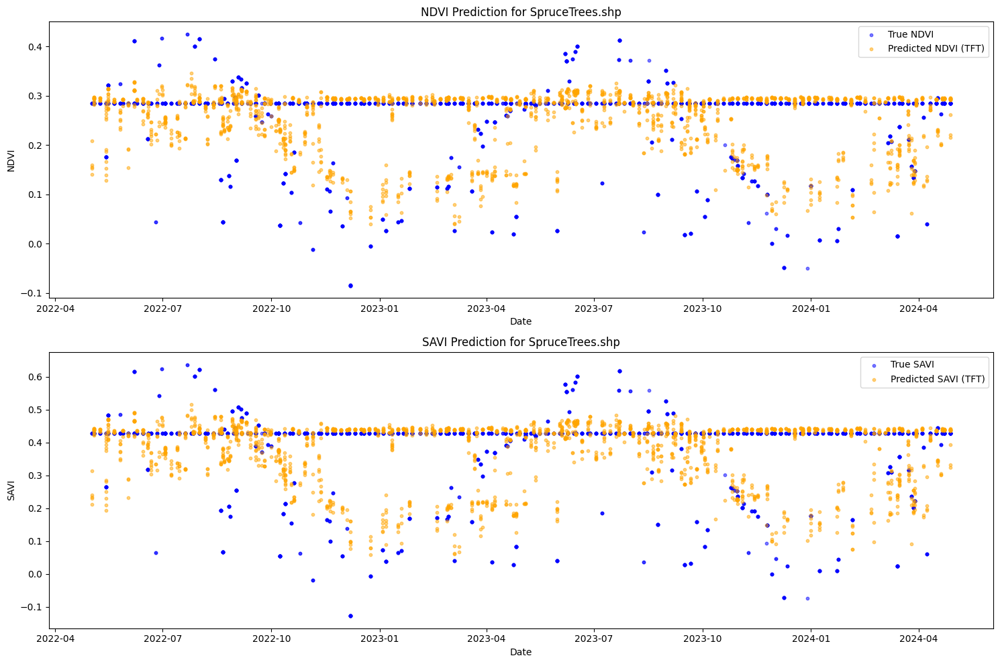

In [5]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, LayerNormalization, MultiHeadAttention, Dropout, Layer, Conv1D, Flatten, Add
import matplotlib.pyplot as plt

# Assuming combined_df is already created as shown in your previous code
# Separate the vegetation types
vegetation_types = combined_df['Shapefile'].unique()

# Function to build the TFT model
class AddAndNorm(Layer):
    def __init__(self, **kwargs):
        super(AddAndNorm, self).__init__(**kwargs)
        self.norm = LayerNormalization()

    def call(self, inputs, sublayer):
        return self.norm(Add()([inputs, sublayer]))

def build_tft():
    # Input layers
    inputs = Input(shape=(1, X_train_scaled.shape[1]))

    # Conv1D layer to capture spatial relationships
    x = Conv1D(filters=64, kernel_size=1, activation='relu')(inputs)

    # Multi-Head Attention
    attn_output = MultiHeadAttention(num_heads=4, key_dim=2)(x, x)
    attn_output = Dropout(0.1)(attn_output)
    x = AddAndNorm()(inputs=x, sublayer=attn_output)

    # Flatten layer
    x = Flatten()(x)

    # Fully connected layers
    x = Dense(100, activation='relu')(x)
    x = Dropout(0.1)(x)
    outputs = Dense(2)(x)  # Output should match the number of target variables (NDVI and SAVI)

    # Build and compile model
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')

    return model

# Iterate over each vegetation type
for veg_type in vegetation_types:
    veg_data = combined_df[combined_df['Shapefile'] == veg_type]

    # Feature selection and target definition
    features = veg_data[['Backscatter', 'Temperature', 'Precipitation']]
    targets = veg_data[['NDVI', 'SAVI']]

    # Train-test split
    X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)

    # Standardize the data
    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    # Reshape for TFT [samples, time steps, features]
    X_train_tft = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
    X_test_tft = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

    tft_model = build_tft()
    early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

    tft_model.fit(X_train_tft, y_train, epochs=50, batch_size=32, validation_split=0.2, callbacks=[early_stopping], verbose=1)

    # Predict using TFT
    tft_predictions = tft_model.predict(X_test_tft)

    # Calculate RMSE for TFT
    tft_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], tft_predictions[:, 0]))
    tft_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], tft_predictions[:, 1]))
    print(f"TFT for {veg_type} - NDVI RMSE: {tft_rmse_ndvi}, SAVI RMSE: {tft_rmse_savi}")

    # Plotting the results with scatter plots
    plt.figure(figsize=(15, 10))

    # Plot NDVI
    plt.subplot(2, 1, 1)
    plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
    plt.scatter(y_test.index, tft_predictions[:, 0], label='Predicted NDVI (TFT)', color='orange', alpha=0.5, s=10)
    plt.legend()
    plt.title(f'NDVI Prediction for {veg_type}')
    plt.xlabel('Date')
    plt.ylabel('NDVI')

    # Plot SAVI
    plt.subplot(2, 1, 2)
    plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
    plt.scatter(y_test.index, tft_predictions[:, 1], label='Predicted SAVI (TFT)', color='orange', alpha=0.5, s=10)
    plt.legend()
    plt.title(f'SAVI Prediction for {veg_type}')
    plt.xlabel('Date')
    plt.ylabel('SAVI')

    plt.tight_layout()
    plt.show()


Contents of indices_df:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter
0 2022-05-14  0.221057  0.331561  0.566053  AgriculturalLand.shp          NaN
1 2022-05-16  0.458280  0.687365  1.377366  AgriculturalLand.shp          NaN
2 2022-05-26  0.409171  0.613717  1.279872  AgriculturalLand.shp          NaN
3 2022-06-07  0.551246  0.826811  1.892590  AgriculturalLand.shp          NaN
4 2022-06-18  0.258405  0.387581  0.797663  AgriculturalLand.shp          NaN
Shape of indices_df: (2622, 6)
Contents of data_df:
        Date  Temperature  Precipitation
0 2022-05-01   279.134277       0.000021
1 2022-05-01   278.996674       0.000000
2 2022-05-01   278.968033       0.000000
3 2022-05-01   278.885117       0.000000
4 2022-05-01   278.801376       0.000000
Shape of data_df: (17520, 3)
Number of common dates: 279
Contents of combined_df after merging:
        Date      NDVI      SAVI       GCI             Shapefile  Backscatter  \
0 2022-05-14  0.221057  0.331561 

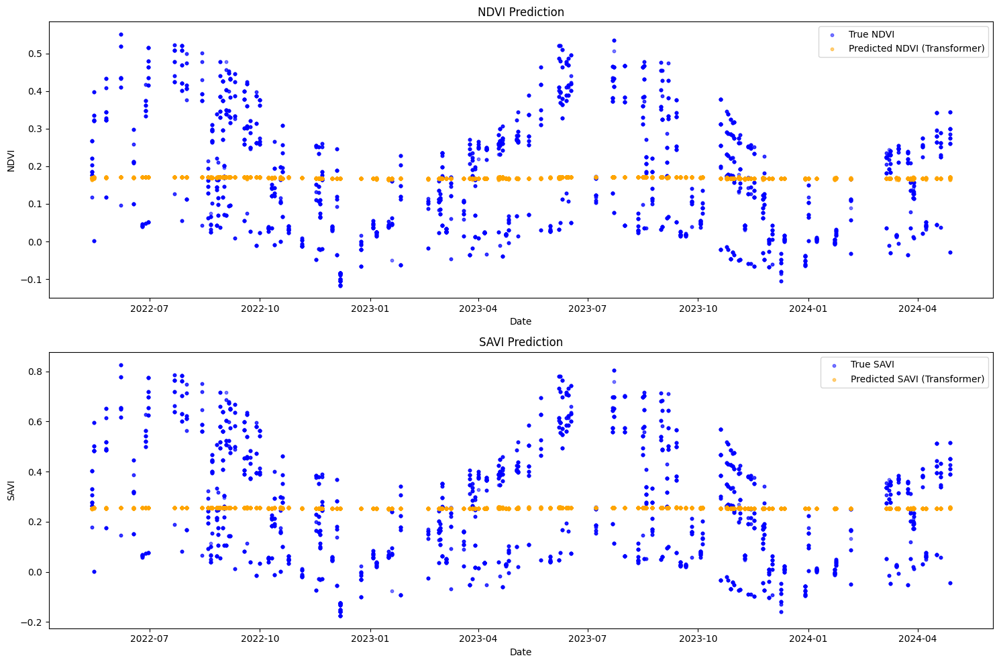

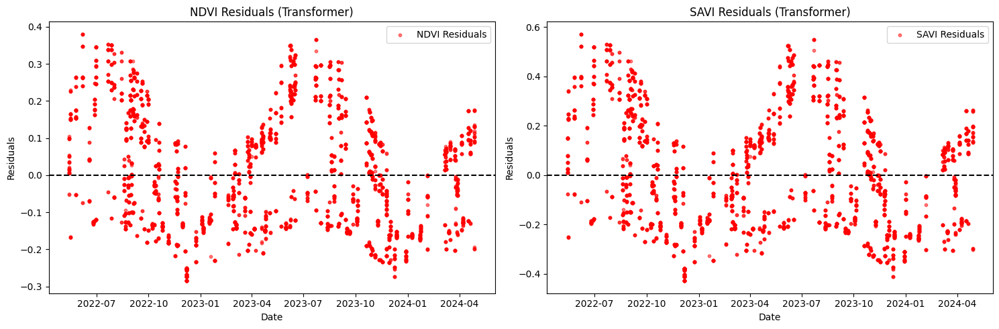

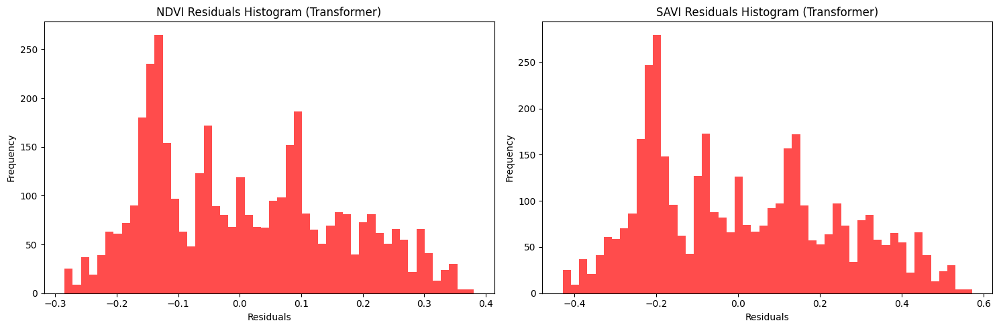

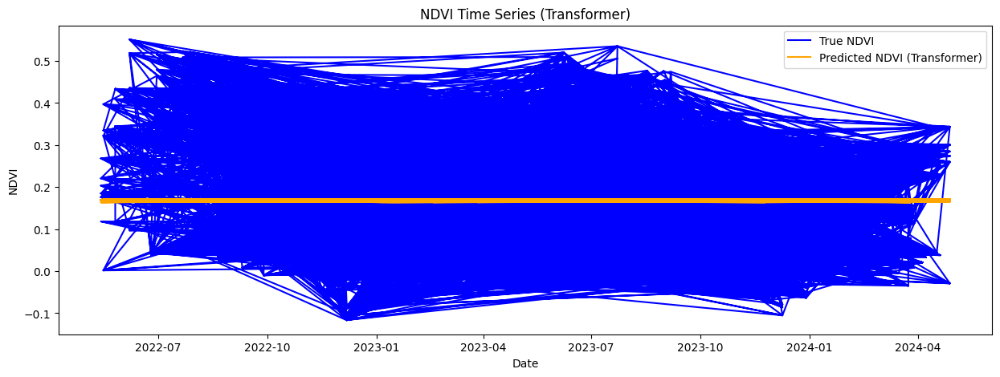

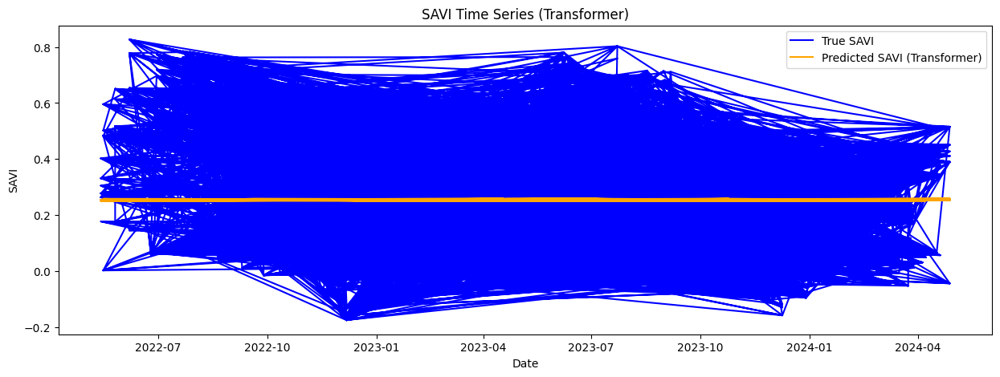

In [7]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, LayerNormalization, MultiHeadAttention, Dropout, TimeDistributed
import matplotlib.pyplot as plt

# Check the contents of indices_df
print("Contents of indices_df:")
print(indices_df.head())
print("Shape of indices_df:", indices_df.shape)

# Check the contents of data_df
print("Contents of data_df:")
print(data_df.head())
print("Shape of data_df:", data_df.shape)

# Ensure there are common dates
common_dates = set(indices_df['Date']).intersection(set(data_df['Date']))
print("Number of common dates:", len(common_dates))

if len(common_dates) == 0:
    raise ValueError("There are no common dates between indices_df and data_df. Please check the data collection steps.")

# Merge the indices DataFrame with temperature and precipitation data.
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check the contents of combined_df after merging
print("Contents of combined_df after merging:")
print(combined_df.head())
print("Shape of combined_df after merging:", combined_df.shape)

# Fill NaN values in the Backscatter column with the mean of the column
combined_df['Backscatter'].fillna(combined_df['Backscatter'].mean(), inplace=True)

# Drop rows with remaining NaN values (if any)
combined_df = combined_df.dropna()
print("Contents of combined_df after filling NaN and dropping remaining NA:")
print(combined_df.head())
print("Shape of combined_df after processing NA:", combined_df.shape)

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Prepare the data
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for the Transformer [samples, time steps, features]
X_train_transformed = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_transformed = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Define the Transformer model
def transformer_model(input_shape):
    inputs = Input(shape=input_shape)

    # Transformer block
    x = LayerNormalization(epsilon=1e-6)(inputs)
    attention_output = MultiHeadAttention(num_heads=2, key_dim=input_shape[-1])(x, x)
    x = Dropout(0.1)(attention_output)
    x = LayerNormalization(epsilon=1e-6)(x)
    
    # Feed Forward Network
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.1)(x)
    outputs = TimeDistributed(Dense(2))(x)
    
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    return model

transformer = transformer_model((1, X_train_scaled.shape[1]))
transformer.fit(X_train_transformed, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using Transformer
transformer_predictions = transformer.predict(X_test_transformed)
transformer_predictions = np.squeeze(transformer_predictions, axis=1)  # Remove the time step dimension

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], transformer_predictions[:, 0]))
transformer_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], transformer_predictions[:, 1]))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}, SAVI RMSE: {transformer_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 0], label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 1], label='Predicted SAVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()

# Residuals plot for Transformer
residuals_ndvi_transformer = y_test['NDVI'] - transformer_predictions[:, 0]
residuals_savi_transformer = y_test['SAVI'] - transformer_predictions[:, 1]

plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.scatter(y_test.index, residuals_ndvi_transformer, label='NDVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('NDVI Residuals (Transformer)')
plt.xlabel('Date')
plt.ylabel('Residuals')

plt.subplot(1, 2, 2)
plt.scatter(y_test.index, residuals_savi_transformer, label='SAVI Residuals', color='red', alpha=0.5, s=10)
plt.axhline(y=0, color='black', linestyle='--')
plt.legend()
plt.title('SAVI Residuals (Transformer)')
plt.xlabel('Date')
plt.ylabel('Residuals')

plt.tight_layout()
plt.show()

# Histogram of the residuals for Transformer
plt.figure(figsize=(15, 5))

plt.subplot(1, 2, 1)
plt.hist(residuals_ndvi_transformer, bins=50, color='red', alpha=0.7)
plt.title('NDVI Residuals Histogram (Transformer)')
plt.xlabel('Residuals')
plt.ylabel('Frequency')

plt.subplot(1, 2, 2)
plt.hist(residuals_savi_transformer, bins=50, color='red', alpha=0.7)
plt.title('SAVI Residuals Histogram (Transformer)')
plt.xlabel('Residuals')
plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

# Time series plot for Transformer
plt.figure(figsize=(15, 5))
plt.plot(y_test.index, y_test['NDVI'], label='True NDVI', color='blue')
plt.plot(y_test.index, transformer_predictions[:, 0], label='Predicted NDVI (Transformer)', color='orange')
plt.legend()
plt.title('NDVI Time Series (Transformer)')
plt.xlabel('Date')
plt.ylabel('NDVI')
plt.show()

plt.figure(figsize=(15, 5))
plt.plot(y_test.index, y_test['SAVI'], label='True SAVI', color='blue')
plt.plot(y_test.index, transformer_predictions[:, 1], label='Predicted SAVI (Transformer)', color='orange')
plt.legend()
plt.title('SAVI Time Series (Transformer)')
plt.xlabel('Date')
plt.ylabel('SAVI')
plt.show()


Epoch 1/50
245/245 [==============================] - 2s 3ms/step - loss: 0.0432
Epoch 2/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0402
Epoch 3/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0397
Epoch 4/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0395
Epoch 5/50
245/245 [==============================] - 1s 2ms/step - loss: 0.0394
Epoch 6/50
245/245 [==============================] - 0s 2ms/step - loss: 0.0393
Epoch 7/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0393
Epoch 8/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0392
Epoch 9/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0393
Epoch 10/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0392
Epoch 11/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0391
Epoch 12/50
245/245 [==============================] - 1s 3ms/step - loss: 0.0391
Epoch 13/50
245/245 [====

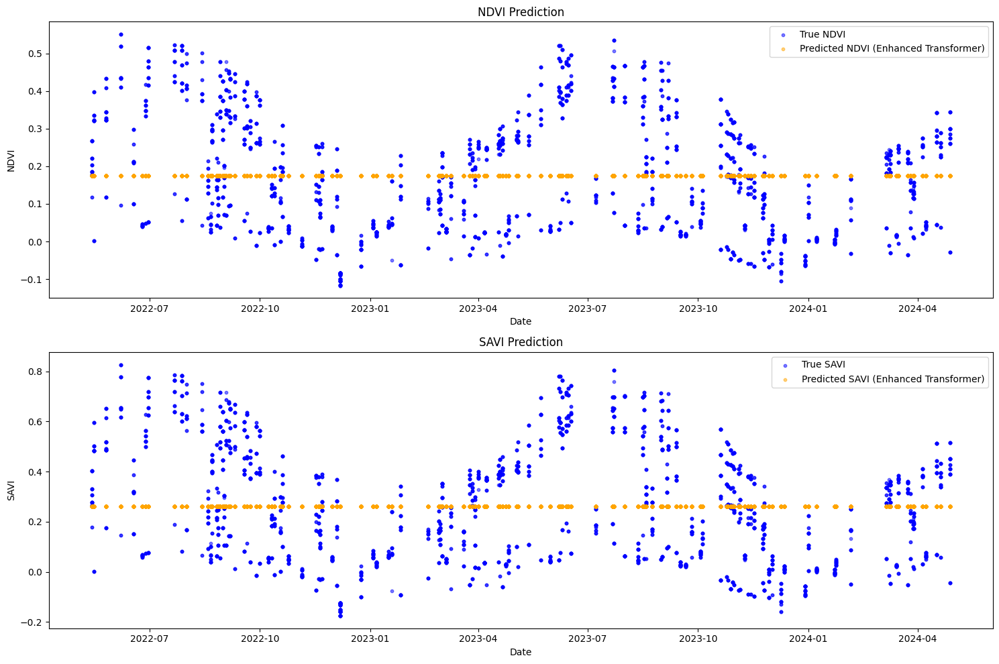

In [8]:
# Define the enhanced Transformer model
def enhanced_transformer_model(input_shape):
    inputs = Input(shape=input_shape)

    # Transformer block
    x = LayerNormalization(epsilon=1e-6)(inputs)
    attention_output = MultiHeadAttention(num_heads=4, key_dim=input_shape[-1])(x, x)
    x = Dropout(0.2)(attention_output)
    x = LayerNormalization(epsilon=1e-6)(x)
    
    # Feed Forward Network
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.2)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.2)(x)
    outputs = TimeDistributed(Dense(2))(x)
    
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')
    
    return model

# Train the enhanced Transformer model
enhanced_transformer = enhanced_transformer_model((1, X_train_scaled.shape[1]))
enhanced_transformer.fit(X_train_transformed, y_train, epochs=50, batch_size=64, verbose=1)

# Predict using the enhanced Transformer model
enhanced_transformer_predictions = enhanced_transformer.predict(X_test_transformed)
enhanced_transformer_predictions = np.squeeze(enhanced_transformer_predictions, axis=1)  # Remove the time step dimension

# Calculate RMSE for the enhanced Transformer model
enhanced_transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], enhanced_transformer_predictions[:, 0]))
enhanced_transformer_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], enhanced_transformer_predictions[:, 1]))
print(f"Enhanced Transformer - NDVI RMSE: {enhanced_transformer_rmse_ndvi}, SAVI RMSE: {enhanced_transformer_rmse_savi}")

# Plotting the results with scatter plots for the enhanced model
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, enhanced_transformer_predictions[:, 0], label='Predicted NDVI (Enhanced Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, enhanced_transformer_predictions[:, 1], label='Predicted SAVI (Enhanced Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Checking for NaN values in the dataset:
NDVI             0
SAVI             0
GCI              0
Shapefile        0
Backscatter      0
Temperature      0
Precipitation    0
dtype: int64
Shape of X_train: (50342, 3)
Shape of X_test: (12586, 3)
Shape of y_train: (50342, 2)
Shape of y_test: (12586, 2)
Epoch 1/20
1574/1574 [==============================] - 5s 2ms/step - loss: 0.0271
Epoch 2/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0215
Epoch 3/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0211
Epoch 4/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0209
Epoch 5/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0209
Epoch 6/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0209
Epoch 7/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0210
Epoch 8/20
1574/1574 [==============================] - 3s 2ms/step - loss: 0.0208
Epoch 9/20
1574/1574 [==============

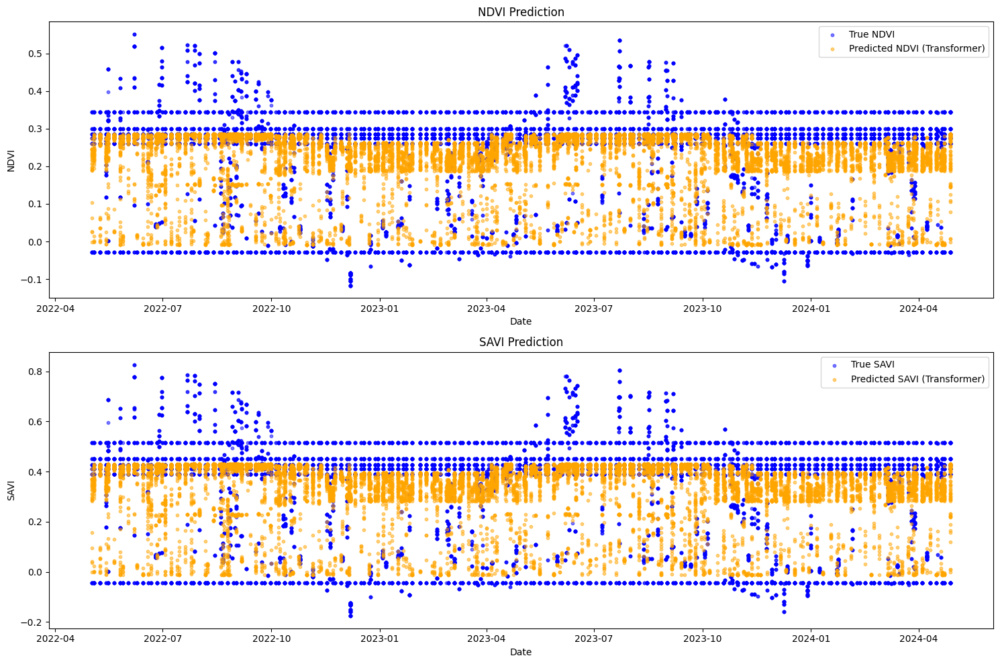

In [18]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense, LayerNormalization, MultiHeadAttention, Dropout, Flatten
import matplotlib.pyplot as plt

# Load the combined DataFrame from the CSV file
combined_df = pd.read_csv('combined_timeseries.csv')

# Convert 'Date' column to datetime
combined_df['Date'] = pd.to_datetime(combined_df['Date'])

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Fill NaN values in the dataset (should be none based on your output)
combined_df.fillna(method='ffill', inplace=True)
combined_df.fillna(method='bfill', inplace=True)

# Check for any remaining NaN values
print("Checking for NaN values in the dataset:")
print(combined_df.isna().sum())

# Split the data again to ensure alignment with dates
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for Transformer [samples, time steps, features]
X_train_transformer = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_transformer = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build the Transformer model
def build_transformer(input_shape):
    inputs = Input(shape=input_shape)
    x = LayerNormalization(epsilon=1e-6)(inputs)
    attention_output = MultiHeadAttention(num_heads=2, key_dim=2)(x, x)
    attention_output = Dropout(0.1)(attention_output)
    add_attention = tf.keras.layers.Add()([inputs, attention_output])
    x = LayerNormalization(epsilon=1e-6)(add_attention)
    x = Flatten()(x)  # Flatten the output before Dense layers
    x = Dense(50, activation='relu')(x)
    x = Dropout(0.1)(x)
    x = Dense(2)(x)  # Predicting NDVI and SAVI
    model = Model(inputs=inputs, outputs=x)
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

input_shape = (X_train_transformer.shape[1], X_train_transformer.shape[2])
transformer_model = build_transformer(input_shape)
transformer_model.fit(X_train_transformer, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using Transformer
transformer_predictions = transformer_model.predict(X_test_transformer)

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], transformer_predictions[:, 0]))
transformer_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], transformer_predictions[:, 1]))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}, SAVI RMSE: {transformer_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 0], label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 1], label='Predicted SAVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Checking for NaN values in the dataset before processing:
Date                 0
NDVI             43344
SAVI             43344
GCI              43344
Shapefile            0
Backscatter      19584
Temperature          0
Precipitation        0
dtype: int64
Shape of combined_df before processing: (62928, 8)
Checking for NaN values in the dataset after filling:
Date             0
NDVI             0
SAVI             0
GCI              0
Shapefile        0
Backscatter      0
Temperature      0
Precipitation    0
dtype: int64
Shape of X_train: (50342, 3)
Shape of X_test: (12586, 3)
Shape of y_train: (50342, 2)
Shape of y_test: (12586, 2)
Epoch 1/20
1574/1574 [==============================] - 8s 3ms/step - loss: 0.0212
Epoch 2/20
1574/1574 [==============================] - 4s 3ms/step - loss: 0.0190
Epoch 3/20
1574/1574 [==============================] - 4s 3ms/step - loss: 0.0186
Epoch 4/20
1574/1574 [==============================] - 4s 3ms/step - loss: 0.0183
Epoch 5/20
1574/1574 [=======

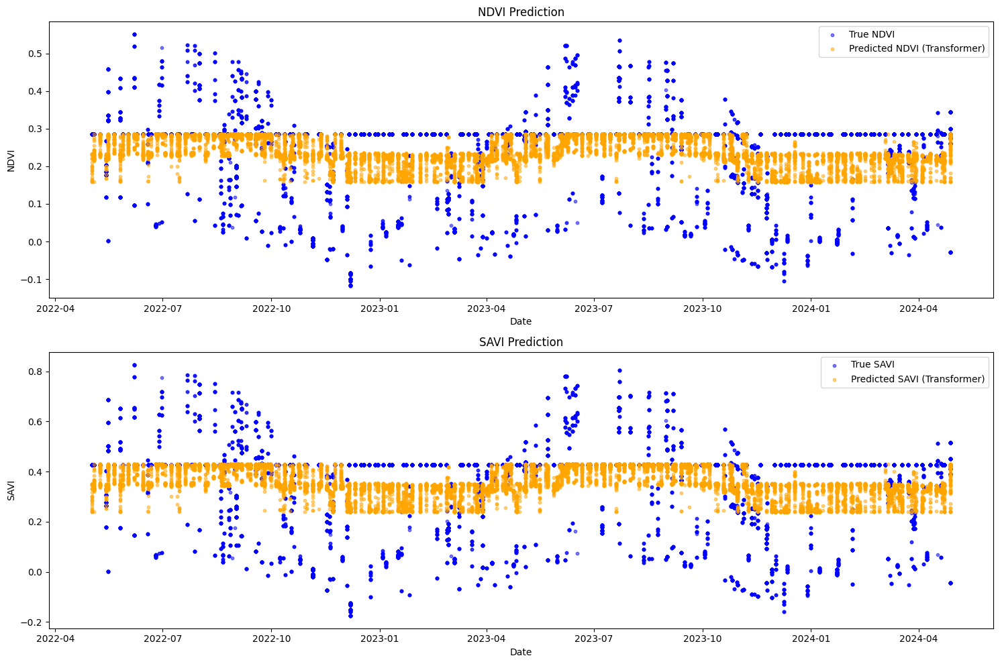

In [22]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Input, LayerNormalization, MultiHeadAttention, Dropout, Flatten
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

# Ensure 'Date' is included during the merge
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check for NaN values and shapes
print("Checking for NaN values in the dataset before processing:")
print(combined_df.isna().sum())
print("Shape of combined_df before processing:", combined_df.shape)

# Fill NaN values with forward and backward filling
combined_df.fillna(method='ffill', inplace=True)
combined_df.fillna(method='bfill', inplace=True)

# Check for any remaining NaN values
print("Checking for NaN values in the dataset after filling:")
print(combined_df.isna().sum())

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Split the data again to ensure alignment with dates
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Reshape data for LSTM [samples, time steps, features]
X_train_lstm = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_lstm = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Build the LSTM model
def build_lstm():
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(1, X_train_scaled.shape[1])))
    model.add(LSTM(50))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm()
lstm_model.fit(X_train_lstm, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Reshape data for Transformer [samples, time steps, features]
X_train_transformer = np.reshape(X_train_scaled, (X_train_scaled.shape[0], 1, X_train_scaled.shape[1]))
X_test_transformer = np.reshape(X_test_scaled, (X_test_scaled.shape[0], 1, X_test_scaled.shape[1]))

# Define the Transformer model
def build_transformer_model(input_shape):
    inputs = Input(shape=input_shape)
    x = LayerNormalization(epsilon=1e-6)(inputs)
    x = MultiHeadAttention(num_heads=8, key_dim=input_shape[1], dropout=0.1)(x, x)
    x = Dropout(0.1)(x)
    x = LayerNormalization(epsilon=1e-6)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.1)(x)
    x = Flatten()(x)
    outputs = Dense(2)(x)  # Predicting NDVI and SAVI
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

transformer_model = build_transformer_model((1, X_train_transformer.shape[2]))
transformer_model.fit(X_train_transformer, y_train, epochs=20, batch_size=32, verbose=1)

# Predict using Transformer
transformer_predictions = transformer_model.predict(X_test_transformer)

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test['NDVI'], transformer_predictions[:, 0]))
transformer_rmse_savi = np.sqrt(mean_squared_error(y_test['SAVI'], transformer_predictions[:, 1]))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}, SAVI RMSE: {transformer_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(y_test.index, y_test['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 0], label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(y_test.index, y_test['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(y_test.index, transformer_predictions[:, 1], label='Predicted SAVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


Checking for NaN values in the dataset before processing:
Date                 0
NDVI             43344
SAVI             43344
GCI              43344
Shapefile            0
Backscatter      19584
Temperature          0
Precipitation        0
dtype: int64
Shape of combined_df before processing: (62928, 8)
Checking for NaN values in the dataset after filling:
Date             0
NDVI             0
SAVI             0
GCI              0
Shapefile        0
Backscatter      0
Temperature      0
Precipitation    0
dtype: int64
Shape of X_train: (50342, 3)
Shape of X_test: (12586, 3)
Shape of y_train: (50342, 2)
Shape of y_test: (12586, 2)
Epoch 1/20
1573/1573 [==============================] - 16s 8ms/step - loss: 0.0217
Epoch 2/20
1573/1573 [==============================] - 12s 8ms/step - loss: 0.0209
Epoch 3/20
1573/1573 [==============================] - 13s 8ms/step - loss: 0.0209
Epoch 4/20
1573/1573 [==============================] - 13s 8ms/step - loss: 0.0209
Epoch 5/20
1573/1573 [===

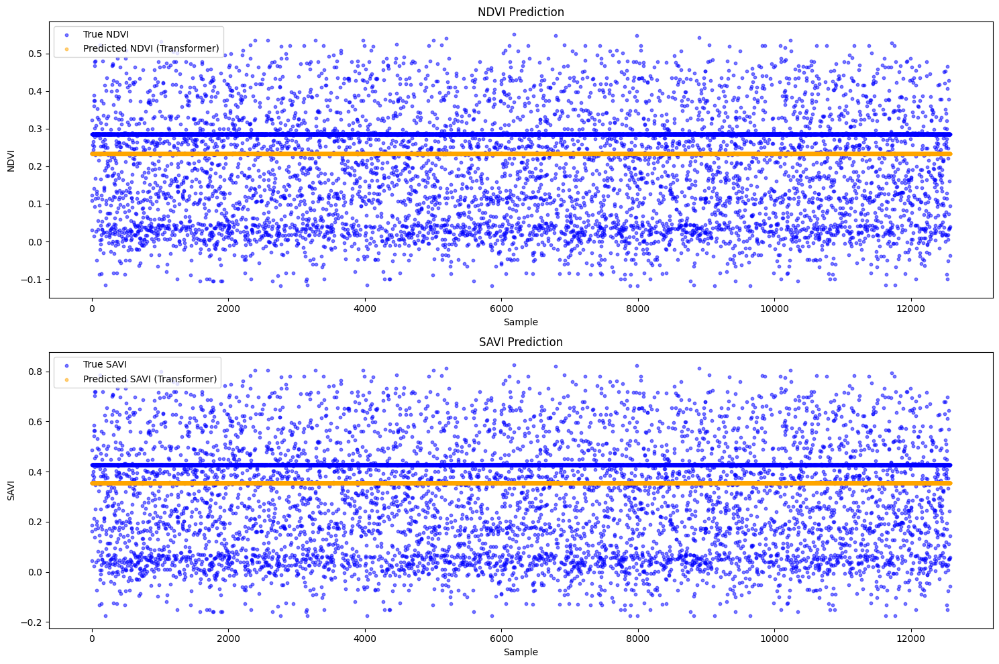

In [23]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, LSTM, Input, LayerNormalization, MultiHeadAttention, Dropout, Flatten
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model

# Ensure 'Date' is included during the merge
combined_df = pd.merge(indices_df, data_df, on='Date', how='inner')

# Check for NaN values and shapes
print("Checking for NaN values in the dataset before processing:")
print(combined_df.isna().sum())
print("Shape of combined_df before processing:", combined_df.shape)

# Fill NaN values with interpolation
combined_df['Backscatter'].interpolate(method='linear', inplace=True)
combined_df['NDVI'].interpolate(method='linear', inplace=True)
combined_df['SAVI'].interpolate(method='linear', inplace=True)
combined_df['GCI'].interpolate(method='linear', inplace=True)

# Fill forward and backward for any remaining NaN values
combined_df.fillna(method='ffill', inplace=True)
combined_df.fillna(method='bfill', inplace=True)

# Check for any remaining NaN values
print("Checking for NaN values in the dataset after filling:")
print(combined_df.isna().sum())

# Ensure 'Date' is in the index
combined_df.set_index('Date', inplace=True)

# Split the data again to ensure alignment with dates
features = combined_df[['Backscatter', 'Temperature', 'Precipitation']]
targets = combined_df[['NDVI', 'SAVI']]

# Check for empty features or targets
if features.empty or targets.empty:
    raise ValueError("The features or targets DataFrame is empty after preprocessing. Please check the data.")

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(features, targets, test_size=0.2, random_state=42)
print("Shape of X_train:", X_train.shape)
print("Shape of X_test:", X_test.shape)
print("Shape of y_train:", y_train.shape)
print("Shape of y_test:", y_test.shape)

# Standardize the data
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Increase the number of time steps for LSTM and Transformer models
n_steps = 10
X_train_lstm = np.array([X_train_scaled[i:i+n_steps] for i in range(len(X_train_scaled)-n_steps)])
X_test_lstm = np.array([X_test_scaled[i:i+n_steps] for i in range(len(X_test_scaled)-n_steps)])
y_train_lstm = y_train.iloc[n_steps:].values
y_test_lstm = y_test.iloc[n_steps:].values

# Build the LSTM model
def build_lstm(input_shape):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=input_shape))
    model.add(LSTM(50))
    model.add(Dense(2))  # Predicting NDVI and SAVI
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

lstm_model = build_lstm((n_steps, X_train_lstm.shape[2]))
lstm_model.fit(X_train_lstm, y_train_lstm, epochs=20, batch_size=32, verbose=1)

# Predict using LSTM
lstm_predictions = lstm_model.predict(X_test_lstm)

# Calculate RMSE for LSTM
lstm_rmse_ndvi = np.sqrt(mean_squared_error(y_test_lstm[:, 0], lstm_predictions[:, 0]))
lstm_rmse_savi = np.sqrt(mean_squared_error(y_test_lstm[:, 1], lstm_predictions[:, 1]))
print(f"LSTM - NDVI RMSE: {lstm_rmse_ndvi}, SAVI RMSE: {lstm_rmse_savi}")

# Reshape data for Transformer [samples, time steps, features]
X_train_transformer = X_train_lstm
X_test_transformer = X_test_lstm

# Define the Transformer model
def build_transformer_model(input_shape):
    inputs = Input(shape=input_shape)
    x = LayerNormalization(epsilon=1e-6)(inputs)
    x = MultiHeadAttention(num_heads=8, key_dim=input_shape[1], dropout=0.1)(x, x)
    x = Dropout(0.1)(x)
    x = LayerNormalization(epsilon=1e-6)(x)
    x = Dense(64, activation='relu')(x)
    x = Dropout(0.1)(x)
    x = Flatten()(x)
    outputs = Dense(2)(x)  # Predicting NDVI and SAVI
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='mean_squared_error')
    return model

transformer_model = build_transformer_model((n_steps, X_train_transformer.shape[2]))
transformer_model.fit(X_train_transformer, y_train_lstm, epochs=20, batch_size=32, verbose=1)

# Predict using Transformer
transformer_predictions = transformer_model.predict(X_test_transformer)

# Calculate RMSE for Transformer
transformer_rmse_ndvi = np.sqrt(mean_squared_error(y_test_lstm[:, 0], transformer_predictions[:, 0]))
transformer_rmse_savi = np.sqrt(mean_squared_error(y_test_lstm[:, 1], transformer_predictions[:, 1]))
print(f"Transformer - NDVI RMSE: {transformer_rmse_ndvi}, SAVI RMSE: {transformer_rmse_savi}")

# Plotting the results with scatter plots
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(range(len(y_test_lstm)), y_test_lstm[:, 0], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.scatter(range(len(y_test_lstm)), transformer_predictions[:, 0], label='Predicted NDVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI Prediction')
plt.xlabel('Sample')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(range(len(y_test_lstm)), y_test_lstm[:, 1], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.scatter(range(len(y_test_lstm)), transformer_predictions[:, 1], label='Predicted SAVI (Transformer)', color='orange', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI Prediction')
plt.xlabel('Sample')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()


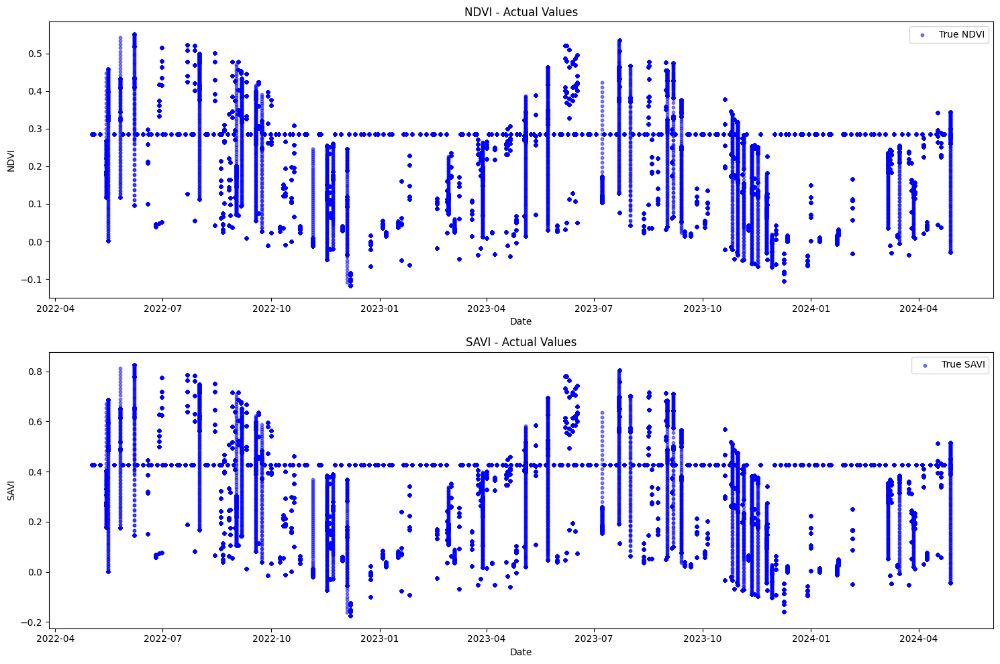

In [24]:
import matplotlib.pyplot as plt

# Plotting the actual NDVI and SAVI values
plt.figure(figsize=(15, 10))

# Plot NDVI
plt.subplot(2, 1, 1)
plt.scatter(combined_df.index, combined_df['NDVI'], label='True NDVI', color='blue', alpha=0.5, s=10)
plt.legend()
plt.title('NDVI - Actual Values')
plt.xlabel('Date')
plt.ylabel('NDVI')

# Plot SAVI
plt.subplot(2, 1, 2)
plt.scatter(combined_df.index, combined_df['SAVI'], label='True SAVI', color='blue', alpha=0.5, s=10)
plt.legend()
plt.title('SAVI - Actual Values')
plt.xlabel('Date')
plt.ylabel('SAVI')

plt.tight_layout()
plt.show()
